In [1]:
import importlib

import RedFunciones.visualizacion as visualizacion
import RedFunciones.Generador as Generador
import RedFunciones.Discriminador as Discriminador
import RedFunciones.auxiliares as auxiliares
import RedFunciones.DataloaderVol as DataloaderVol
import RedFunciones.Checkpoint as Checkpoint

importlib.reload(auxiliares)
importlib.reload(visualizacion)
importlib.reload(Generador)
importlib.reload(Discriminador)
importlib.reload(DataloaderVol)
importlib.reload(Checkpoint)

import Auxiliares.BinaryAccuracy as bin_acc

import json

import PrePross.pre_pross as prpr
import PrePross.grifflin as grifflin
import matplotlib.pyplot as plt
import numpy as np
from scipy import signal
import importlib
import pandas as pd
importlib.reload(prpr)

import torch
from torch import nn
from tqdm.auto import tqdm 

from torchvision import transforms
from torchvision.utils import make_grid
from torchvision.datasets import MNIST 

from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

import os
cwd = os.getcwd()
print(cwd)

cuda0 = torch.device('cuda:0')
cpu = 'cpu'
device = torch.device(cuda0 if torch.cuda.is_available() else cpu)
print(torch.cuda.is_available())
print(torch.cuda.device_count())


/home/fgrijalva/RedVolcanica/RedVolcanica
True
4


In [2]:
limite_snr = 10

base_vt=prpr.open_bdd('Data/VT_IGEPN_1.json')
base_lp=prpr.open_bdd('Data/LP_IGEPN_1.json')
basef = pd.concat([base_vt, base_lp])
base=prpr.extraer_señales(basef, '')
prpr.normalizar_tamanio_base(base, 83)
prpr.normalizar_muestras(base, 8192/2)
base_rms=prpr.quitar_dc(basef)
base = base_rms
base = prpr.drop_data_na(base)
base = prpr.drop_data_ruido(base, limite_snr)
base = prpr.normailizar_muestras(base)
prpr.guardar_base_h5(base,129,33, nombre='baseSR10')


/home/fgrijalva/RedVolcanica/RedVolcanica/PrePross/pre_pross.py:95: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  base[keysp][i] = 0
/home/fgrijalva/RedVolcanica/RedVolcanica/PrePross/pre_pross.py:105: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  base[keyep][i] = fin - inicio - 1
/home/fgrijalva/RedVolcanica/RedVolcanica/PrePross/pre_pross.py:124: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  base[keydata][i] = señal_ret
/home/fgrijal

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066


3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705
3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716
3717
3718
3719
3720
3721
3722
3723
3724
3725
3726
3727
3728
3729
3730
3731
3732
3733
3734
3735
3736
3737
3738
3739
3740
3741
3742
3743
3744
3745
3746
3747
3748
3749
3750
3751
3752
3753
3754
3755
3756
3757
3758
3759
3760
3761
3762
3763
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3785
3786
3787
3788
3789
3790
3791


5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343
5344
5345
5346
5347
5348
5349
5350
5351
5352
5353
5354
5355
5356
5357
5358
5359
5360
5361
5362
5363
5364
5365
5366
5367
5368
5369
5370
5371
5372
5373
5374
5375
5376
5377
5378
5379
5380
5381
5382
5383
5384
5385
5386
5387
5388
5389
5390
5391
5392
5393
5394
5395
5396
5397
5398
5399
5400
5401
5402
5403
5404
5405
5406
5407
5408
5409
5410
5411
5412
5413
5414
5415
5416
5417
5418
5419
5420
5421
5422
5423
5424
5425
5426
5427
5428
5429
5430
5431
5432
5433
5434
5435
5436
5437
5438
5439
5440
5441
5442
5443
5444
5445
5446
5447
5448
5449
5450
5451
5452
5453
5454
5455
5456
5457
5458
5459
5460
5461
5462
5463
5464
5465
5466
5467
5468
5469


criterion: the loss function

n_epochs: the number of times you iterate through the entire 
dataset when training

z_dim: the dimension of the noise vector

display_step: how often to display/visualize the images

batch_size: the number of images per forward/backward pass

lr: the learning rate


device: the device type

In [3]:
seed = 16
torch.manual_seed(seed) 
torch.cuda.manual_seed_all(seed)  
torch.backends.cudnn.deterministic = True  
torch.backends.cudnn.benchmark = True

In [4]:
display_step = 50

h5_filename = cwd + '/baseh5/baseSR10.h5'
nombre = 'master'
nombre_carga = 'final15.pt'

z_dim = 64
n_epochs = 15
batch_size = 12

lrg = 0.00009
beta_1_g = 0.5
beta_2_g = 0.999
repeats_g = 3

lrd = 0.0002
beta_1_d = 0.5
beta_2_d = 0.999
d_repeats = 1

guardar = False
cargar = False
save_steep = 1

regularizaM = True
reg_lambda = 0.001

In [5]:
criterion = nn.BCEWithLogitsLoss()
mnist_shape = (1, 129, 33) 
n_classes = 2
mean = 0
std = 1
epoch_temp = -1
gen_loss_temp = torch.empty([])
disc_loss_temp = torch.empty([])

In [6]:
transform = transforms.Compose([])    
myData = DataloaderVol.VolcanoDatasetH5(h5_filename, transform)

dataloader = DataLoader(
    myData,
    batch_size=batch_size,
    shuffle=True)

In [7]:
generator_input_dim, discriminator_im_chan = auxiliares.get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generador.Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lrg)
disc = Discriminador.Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lrd)
gen = gen.apply(auxiliares.weights_init)
disc = disc.apply(auxiliares.weights_init)

disc.train()
gen.train()
        
metric = bin_acc.BinaryAccuracy()

In [8]:
if cargar:
    compelto = Checkpoint.DIRECTORY + nombre_carga
    checkpoint = torch.load(compelto)
    gen.load_state_dict(checkpoint['gen'])
    disc.load_state_dict(checkpoint['disc'])
    gen_opt.load_state_dict(checkpoint['gen_opt'])
    disc_opt.load_state_dict(checkpoint['disc_opt'])
    epoch_temp = checkpoint['epoch']
    gen_loss_temp = checkpoint['gen_loss']
    disc_loss_temp = checkpoint['dis_loss']
    print('Modelo cargado')
    print('epoch: ' + str(epoch_temp))

Epoch: 0


  0%|          | 0/514 [00:00<?, ?it/s]

Red Funcionando
Step 50: Generator loss: 1.1742371195554735, discriminator loss: 0.8969242498278618
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


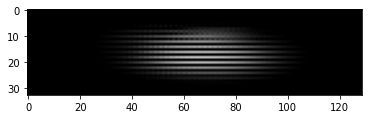

Espectrogramas Reales


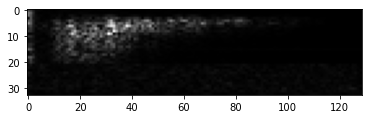

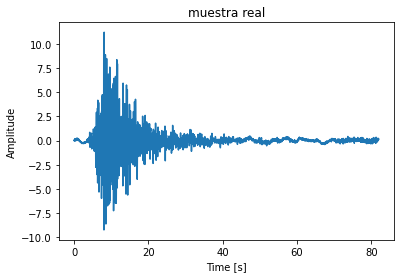

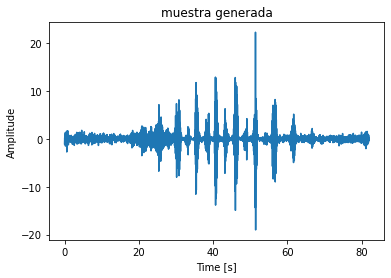

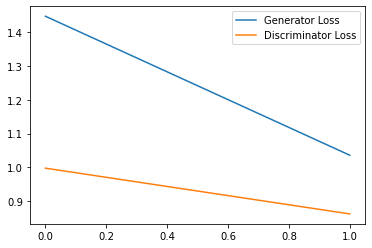

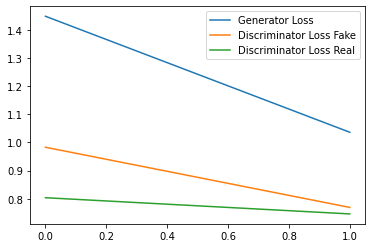

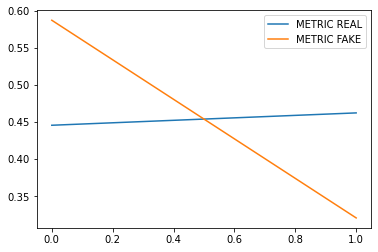

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 100: Generator loss: 0.7359198558330534, discriminator loss: 0.8243037939071656
Espectrogramas Generados


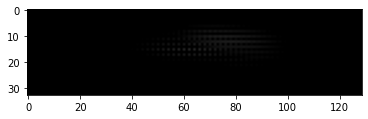

Espectrogramas Reales


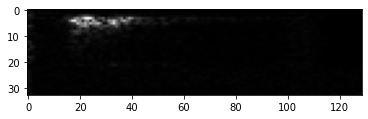

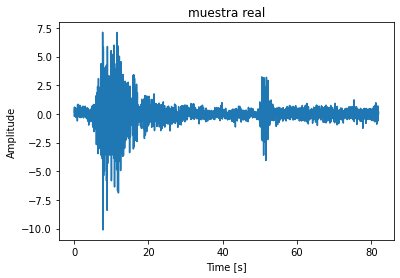

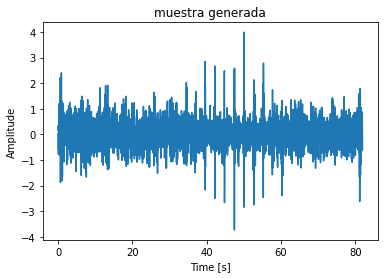

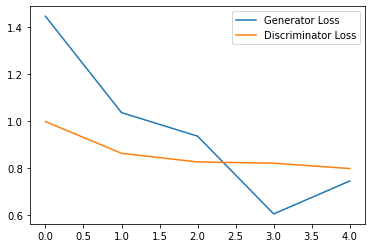

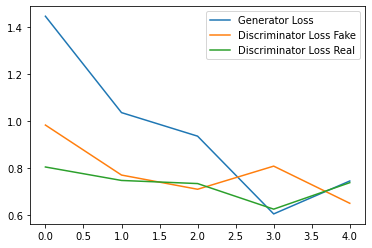

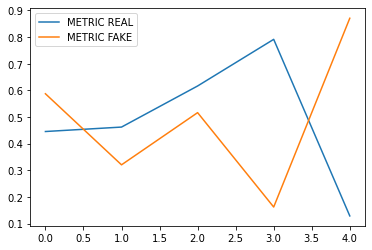

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 150: Generator loss: 0.6919781486193339, discriminator loss: 0.8010485744476319
Espectrogramas Generados


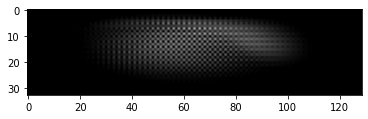

Espectrogramas Reales


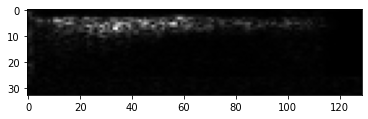

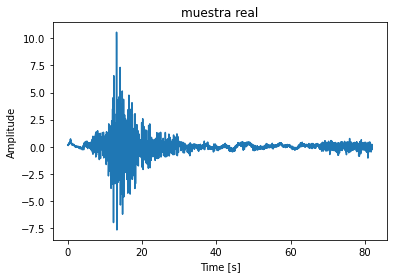

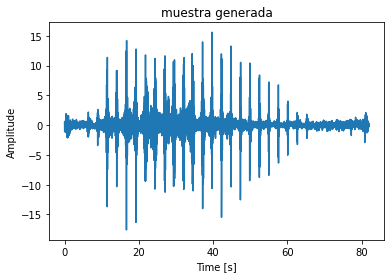

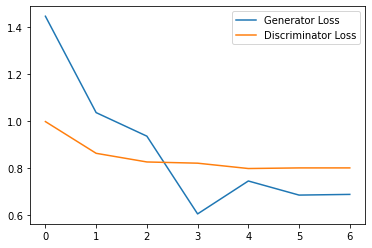

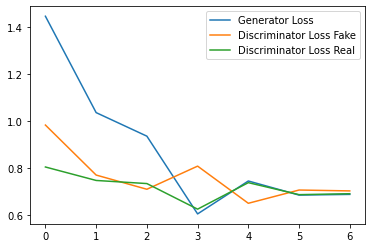

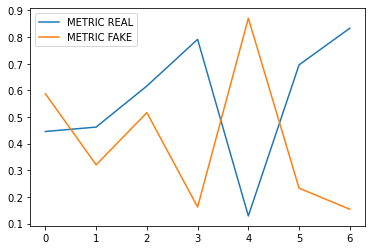

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 200: Generator loss: 0.7007589451471966, discriminator loss: 0.7998995125293732
Espectrogramas Generados


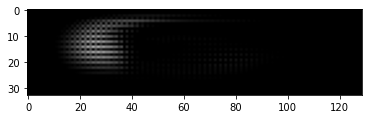

Espectrogramas Reales


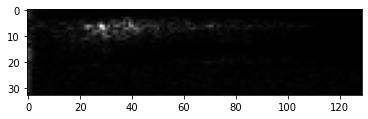

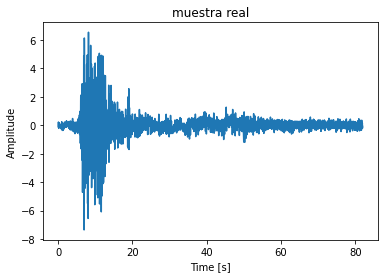

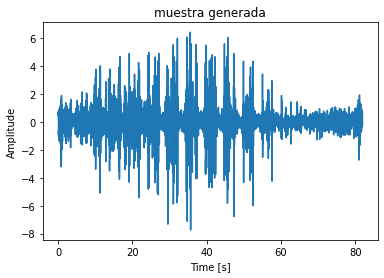

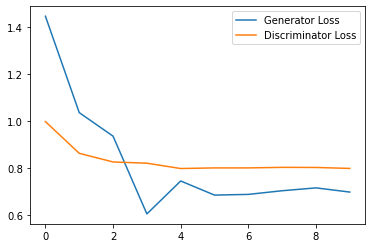

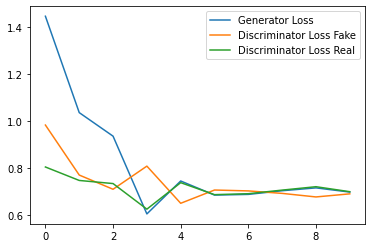

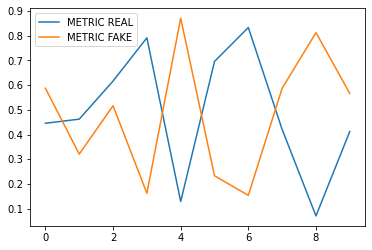

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 250: Generator loss: 0.6935647515455883, discriminator loss: 0.7994161760807037
Espectrogramas Generados


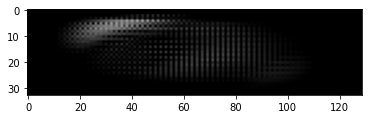

Espectrogramas Reales


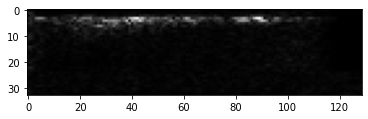

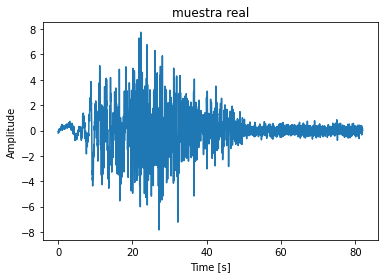

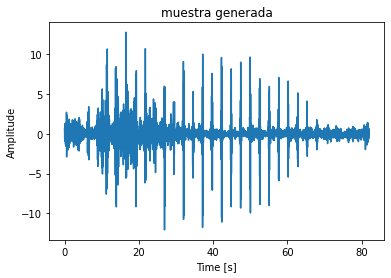

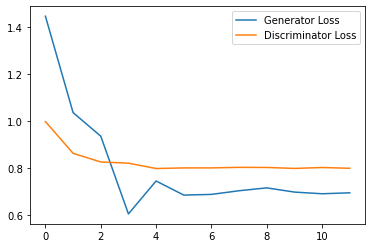

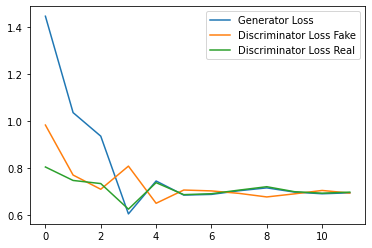

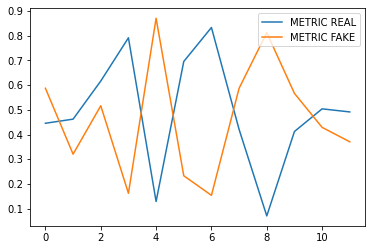

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 300: Generator loss: 0.6929586791992187, discriminator loss: 0.7968112730979919
Espectrogramas Generados


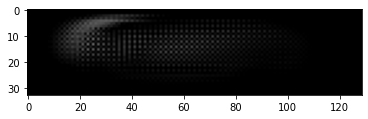

Espectrogramas Reales


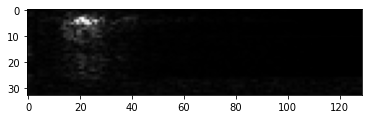

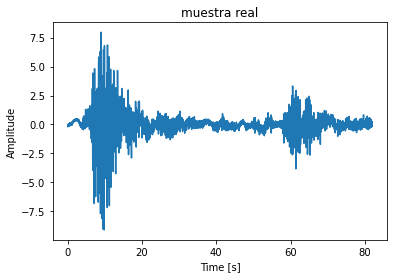

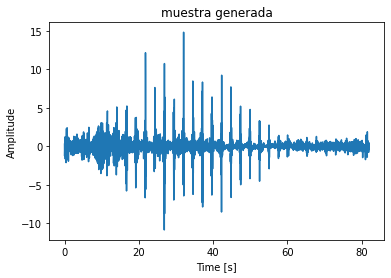

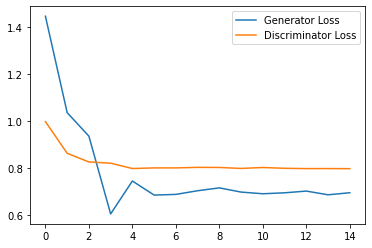

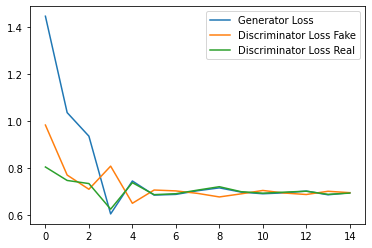

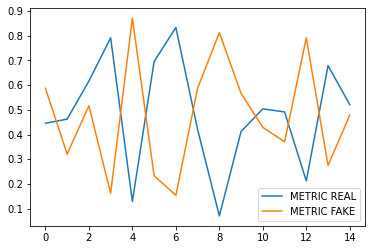

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 350: Generator loss: 0.6930087157090505, discriminator loss: 0.7964043951034546
Espectrogramas Generados


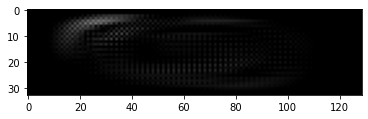

Espectrogramas Reales


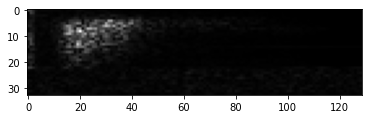

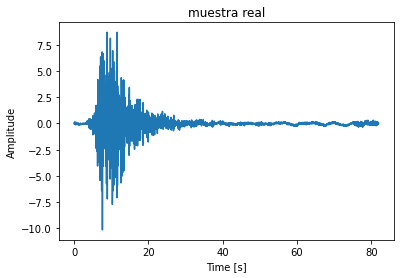

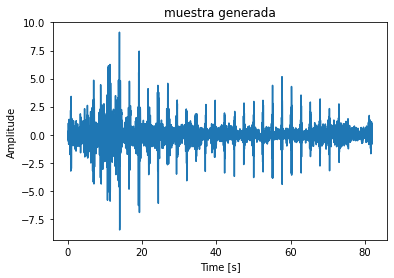

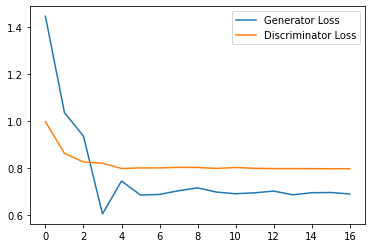

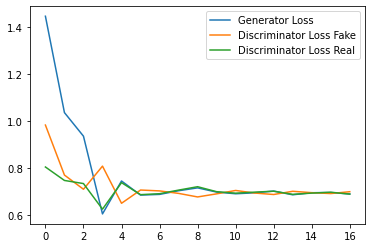

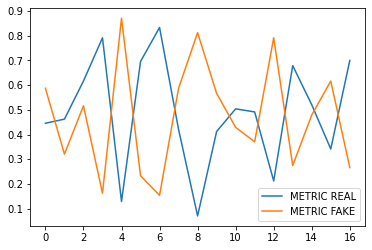

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 400: Generator loss: 0.6935295804341632, discriminator loss: 0.7962348008155823
Espectrogramas Generados


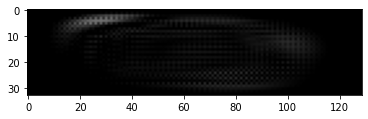

Espectrogramas Reales


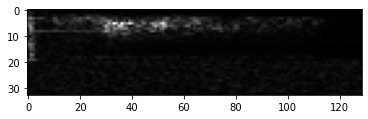

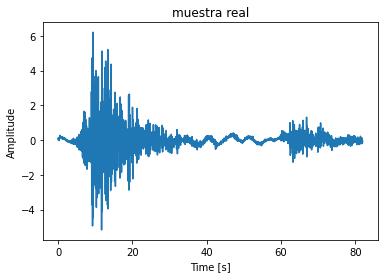

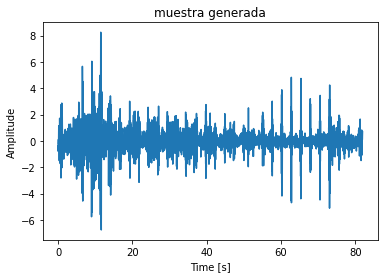

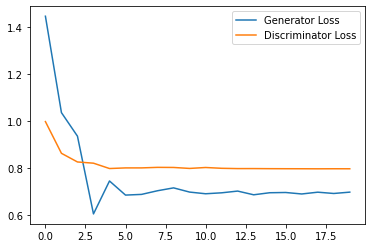

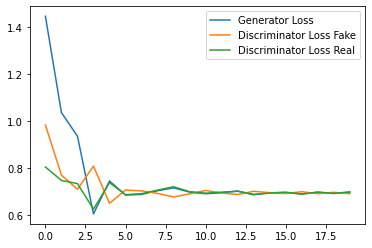

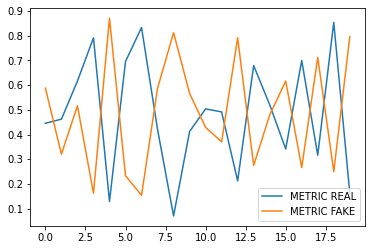

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 450: Generator loss: 0.6948418060938519, discriminator loss: 0.7957493221759796
Espectrogramas Generados


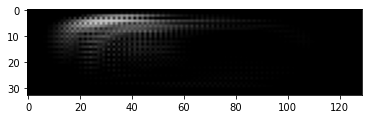

Espectrogramas Reales


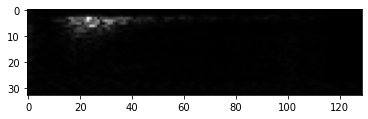

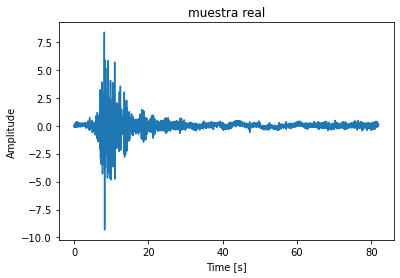

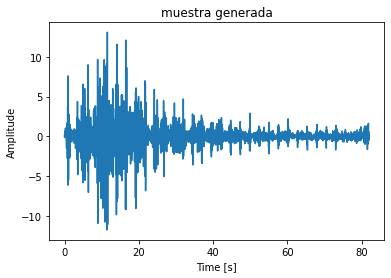

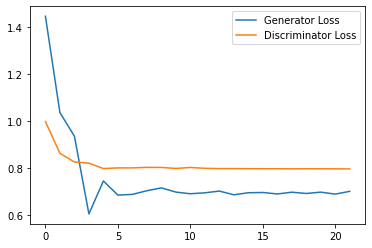

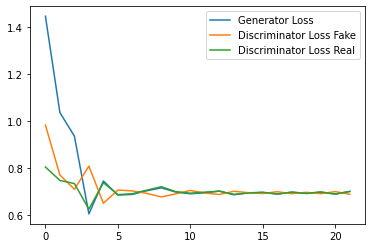

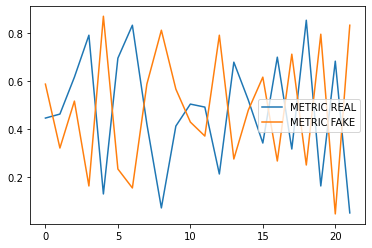

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 500: Generator loss: 0.6962903769810993, discriminator loss: 0.7951934015750886
Espectrogramas Generados


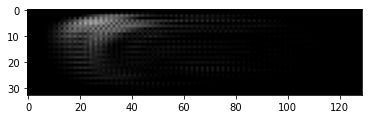

Espectrogramas Reales


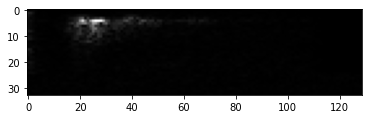

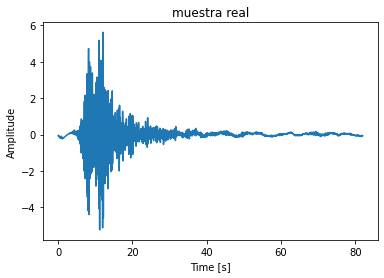

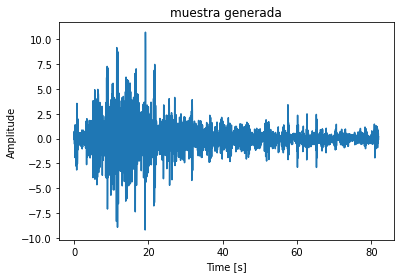

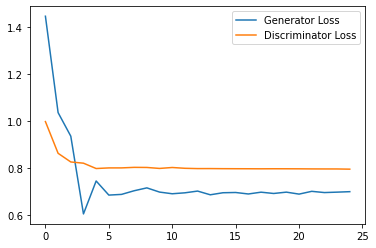

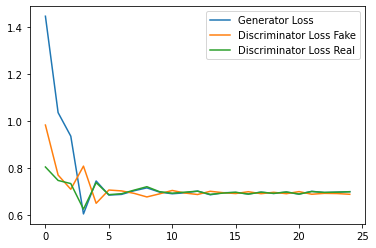

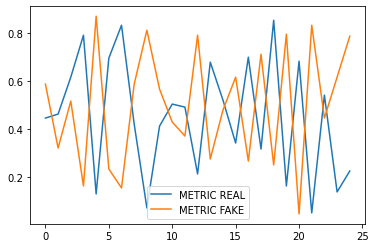

Epoch: 1


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 550: Generator loss: 0.6946226219336191, discriminator loss: 0.7961369347572327
Espectrogramas Generados


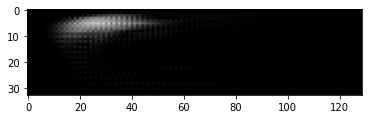

Espectrogramas Reales


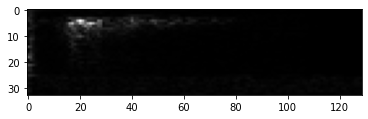

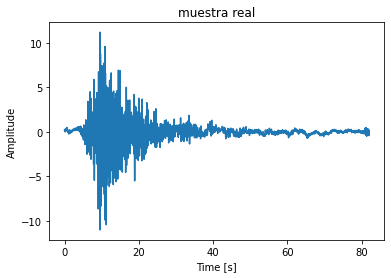

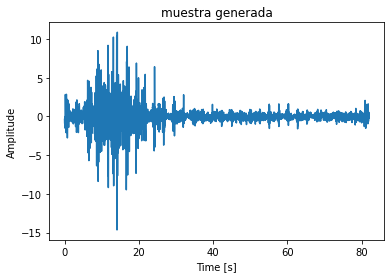

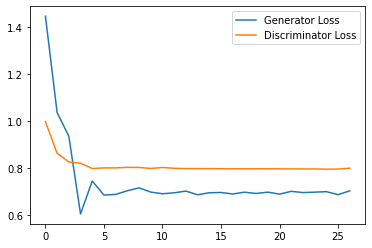

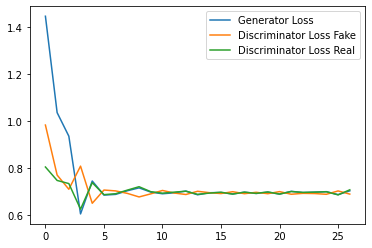

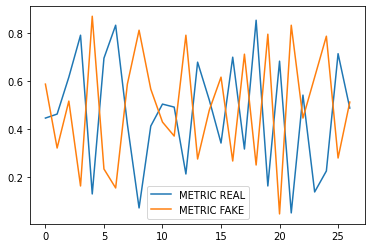

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 600: Generator loss: 0.6893580794334413, discriminator loss: 0.7962006521224976
Espectrogramas Generados


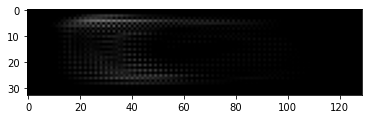

Espectrogramas Reales


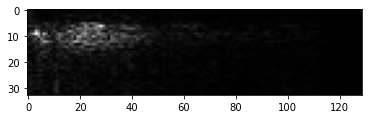

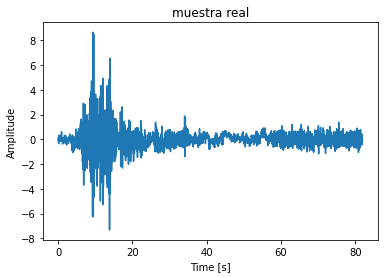

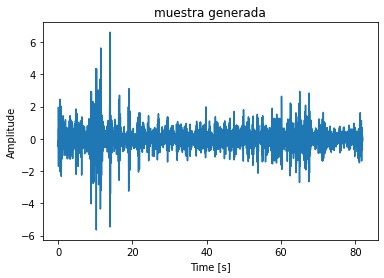

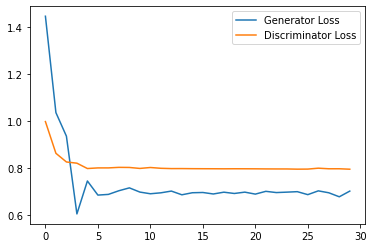

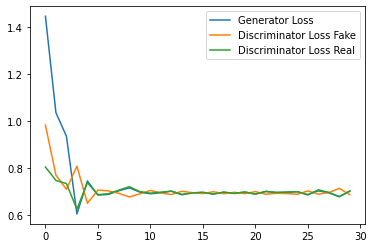

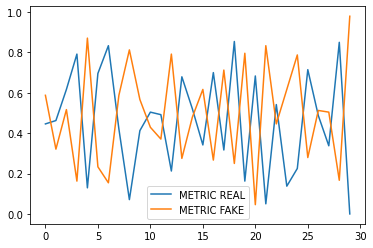

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 650: Generator loss: 0.6932690572738648, discriminator loss: 0.7943147814273834
Espectrogramas Generados


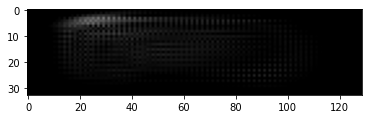

Espectrogramas Reales


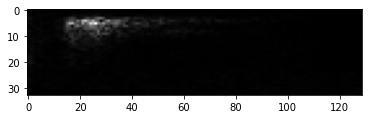

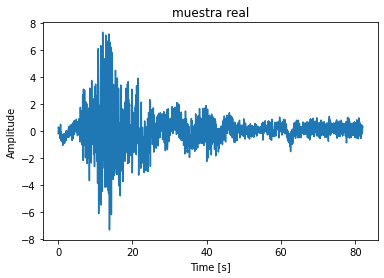

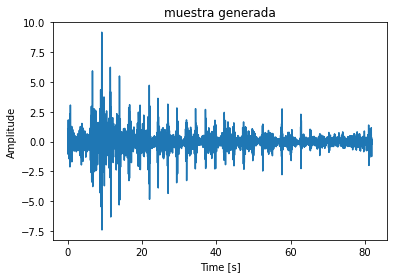

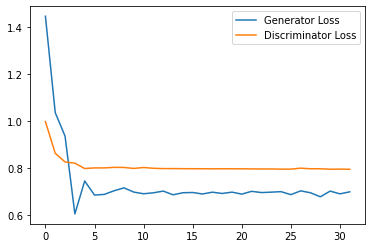

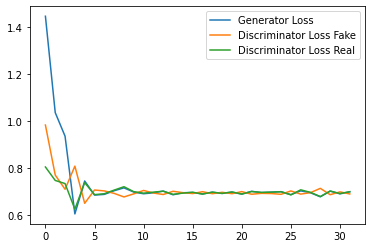

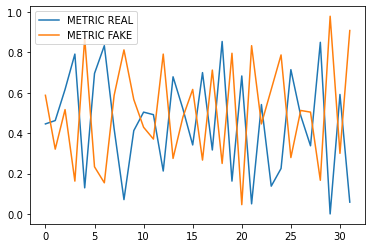

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 700: Generator loss: 0.6910042099157968, discriminator loss: 0.7935625946521759
Espectrogramas Generados


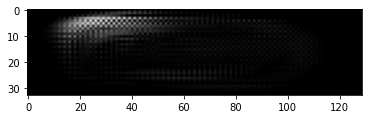

Espectrogramas Reales


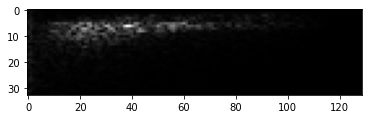

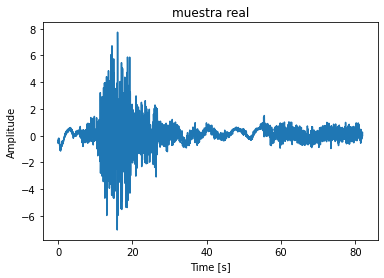

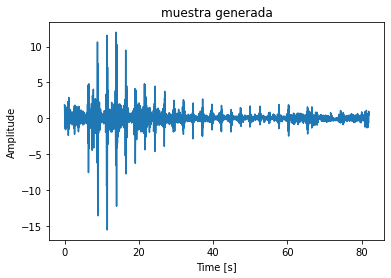

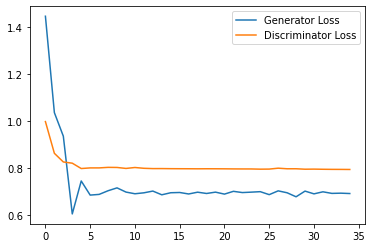

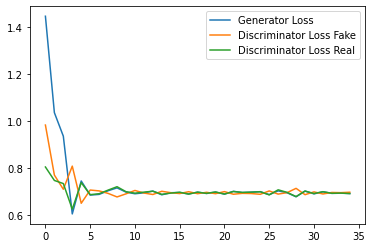

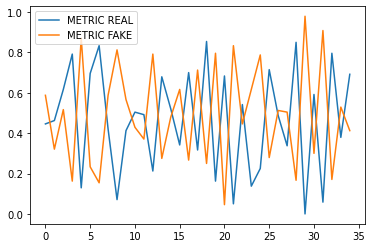

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 750: Generator loss: 0.6922894267241161, discriminator loss: 0.7932806837558747
Espectrogramas Generados


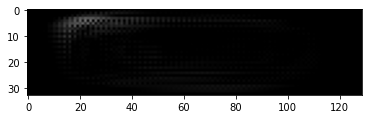

Espectrogramas Reales


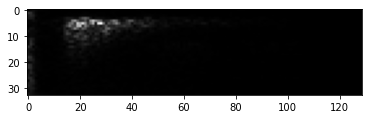

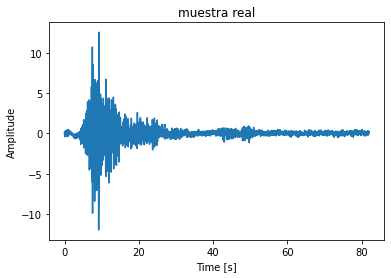

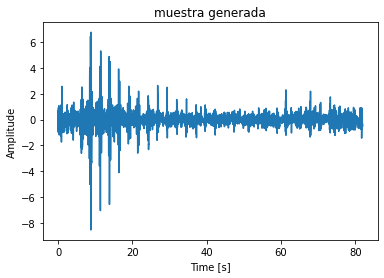

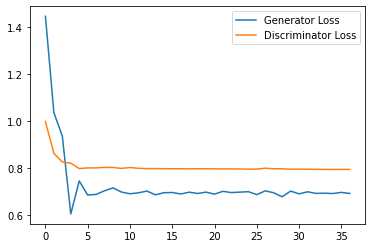

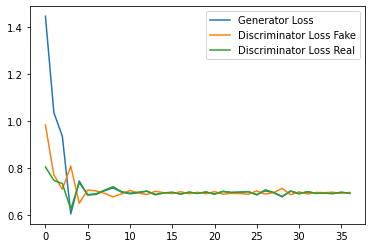

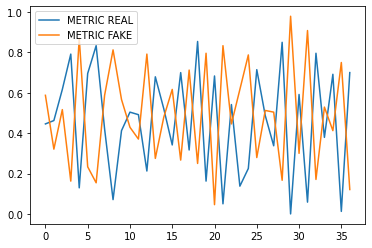

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 800: Generator loss: 0.6929712891578674, discriminator loss: 0.7925940680503846
Espectrogramas Generados


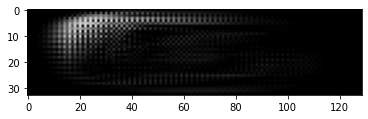

Espectrogramas Reales


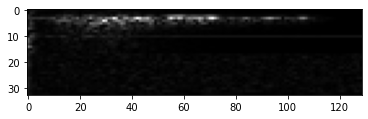

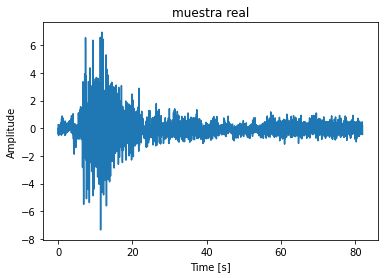

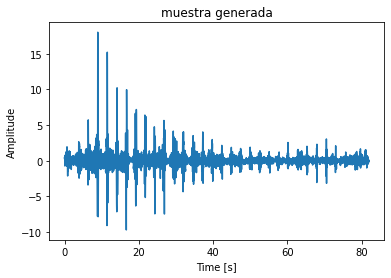

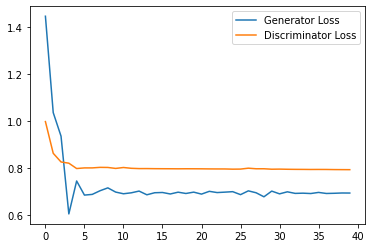

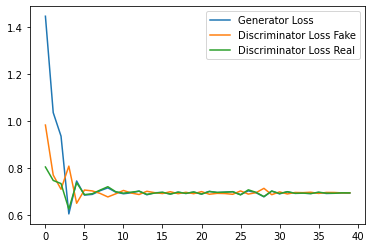

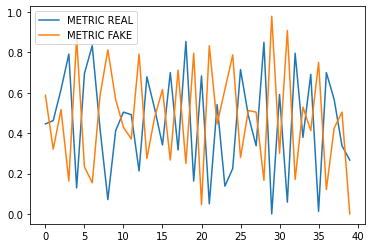

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 850: Generator loss: 0.6929476392269135, discriminator loss: 0.7920183789730072
Espectrogramas Generados


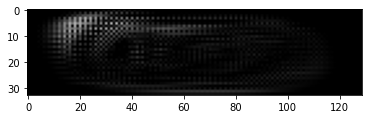

Espectrogramas Reales


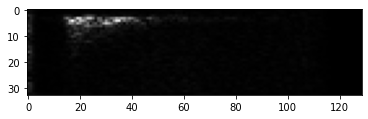

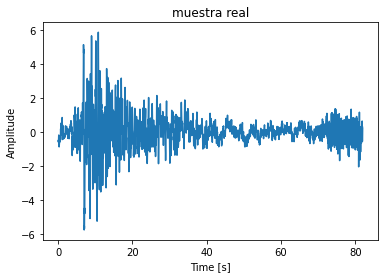

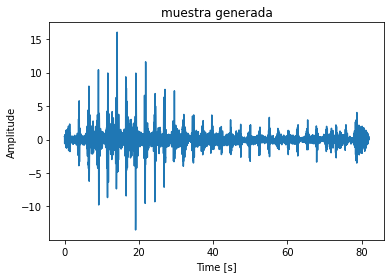

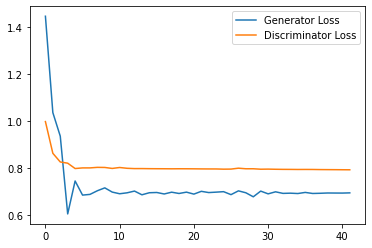

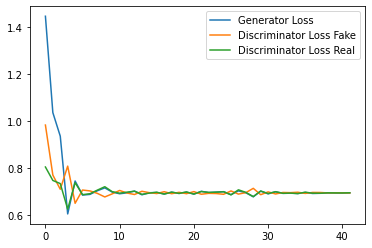

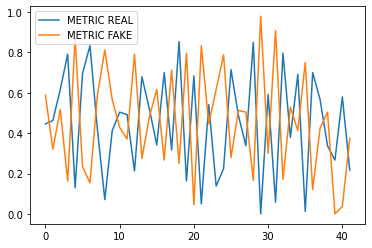

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 900: Generator loss: 0.6928900865713757, discriminator loss: 0.7916155230998992
Espectrogramas Generados


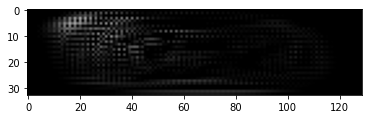

Espectrogramas Reales


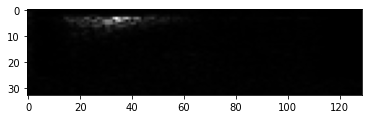

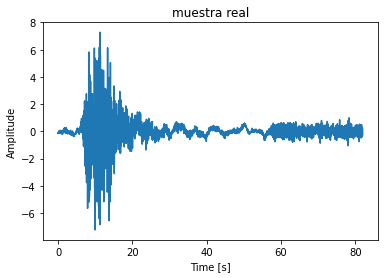

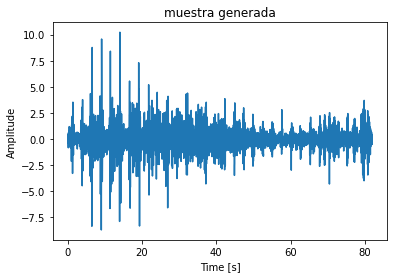

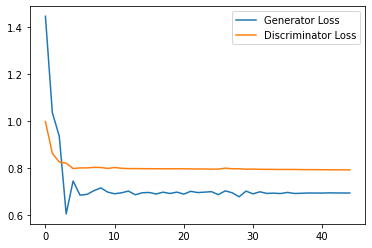

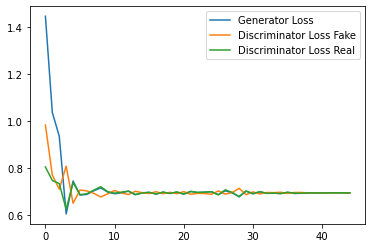

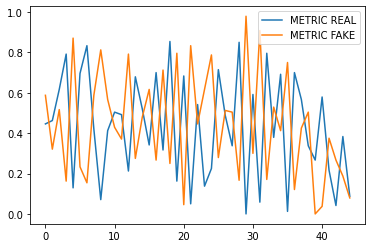

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 950: Generator loss: 0.6925255191326142, discriminator loss: 0.7911746048927307
Espectrogramas Generados


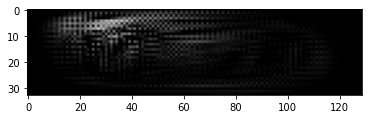

Espectrogramas Reales


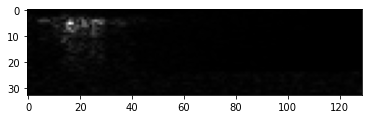

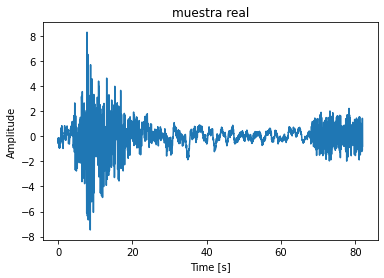

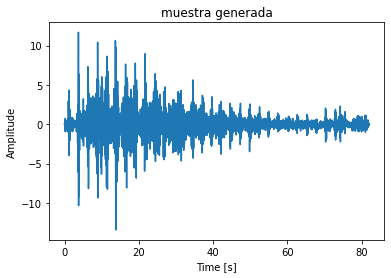

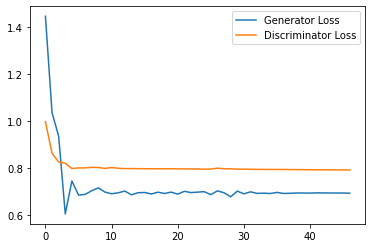

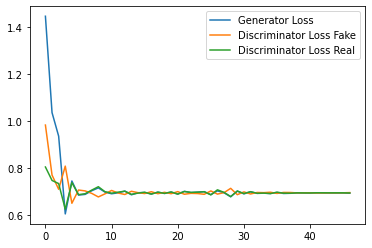

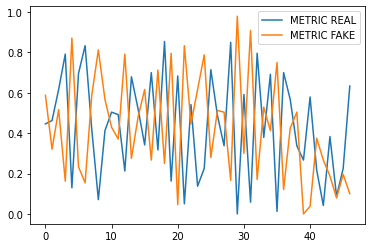

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1000: Generator loss: 0.6930904312928515, discriminator loss: 0.7904881131649018
Espectrogramas Generados


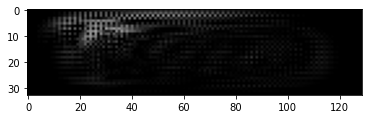

Espectrogramas Reales


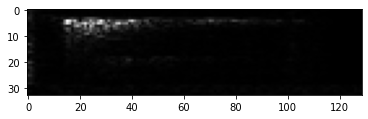

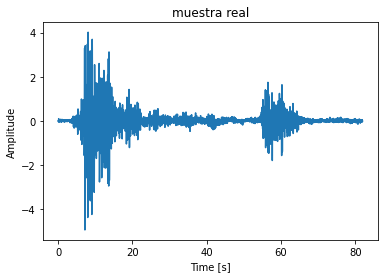

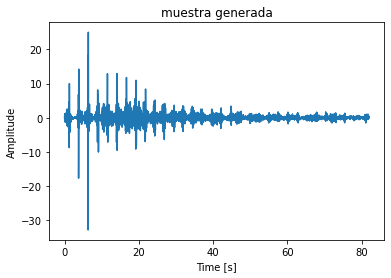

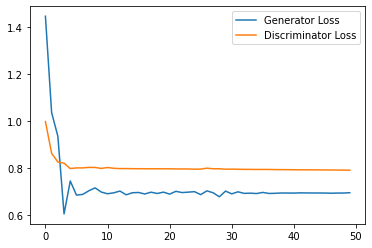

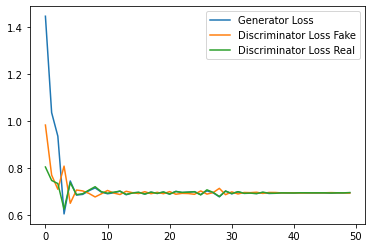

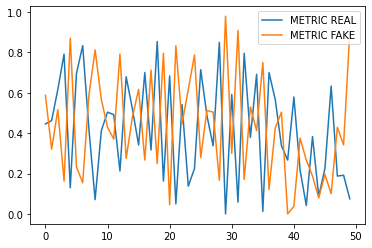

Epoch: 2


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1050: Generator loss: 0.6924118677775064, discriminator loss: 0.7897699964046478
Espectrogramas Generados


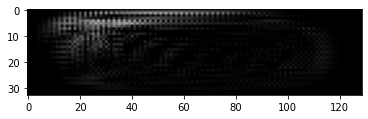

Espectrogramas Reales


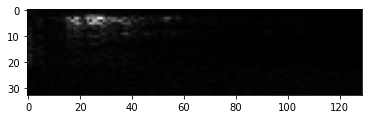

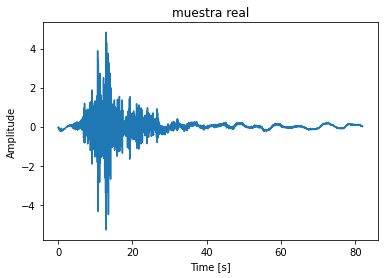

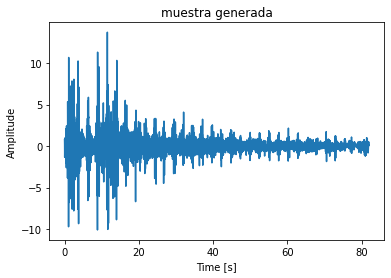

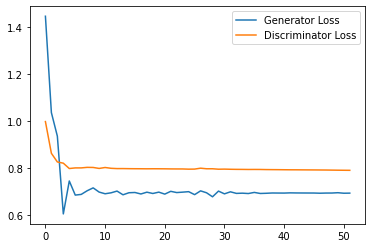

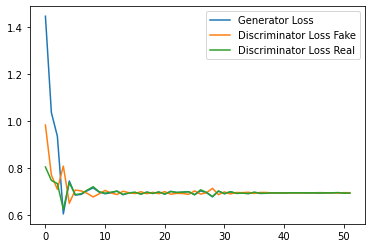

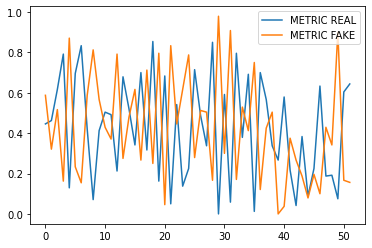

Step 1100: Generator loss: 0.6925872679551444, discriminator loss: 0.7890804719924926
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


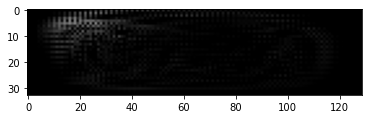

Espectrogramas Reales


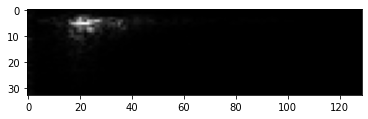

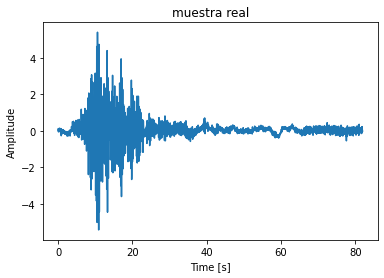

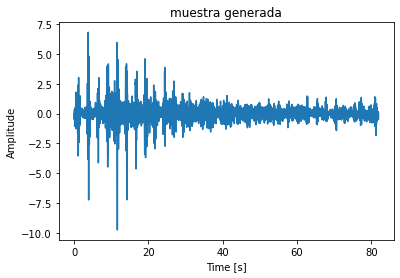

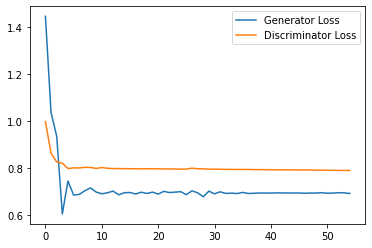

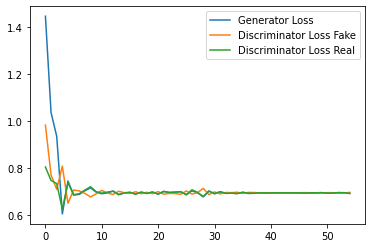

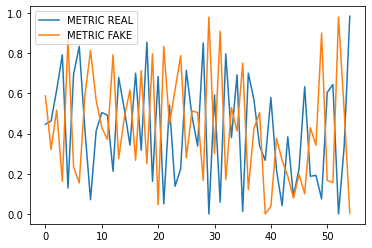

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1150: Generator loss: 0.6939812326431274, discriminator loss: 0.7884358894824982
Espectrogramas Generados


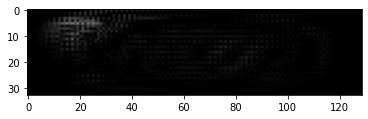

Espectrogramas Reales


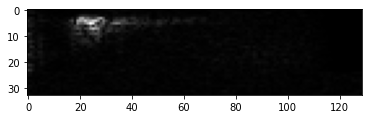

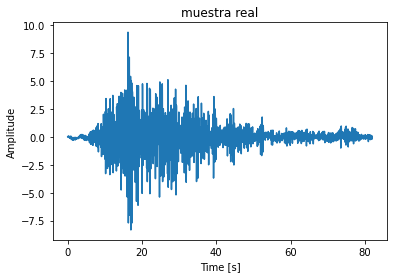

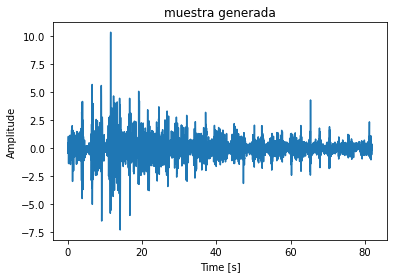

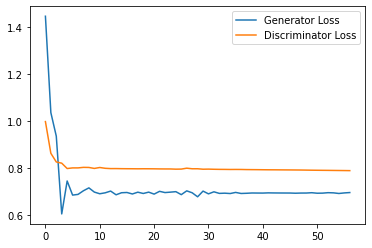

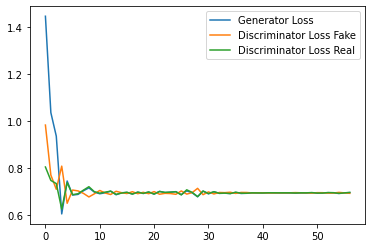

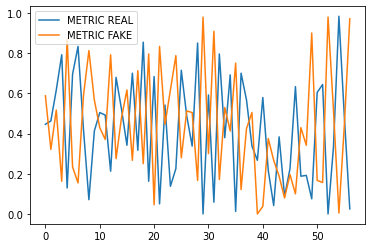

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1200: Generator loss: 0.6924650899569194, discriminator loss: 0.787736212015152
Espectrogramas Generados


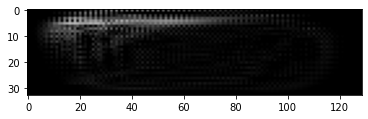

Espectrogramas Reales


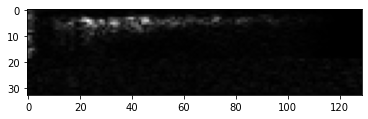

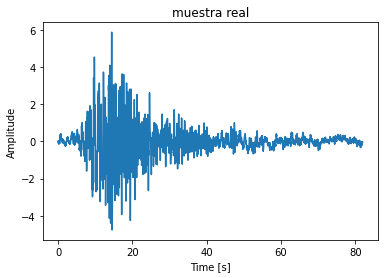

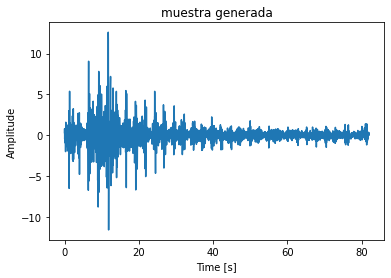

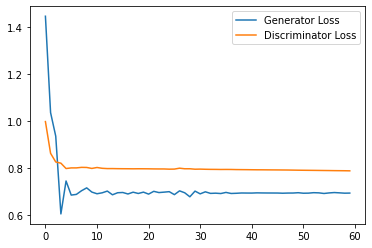

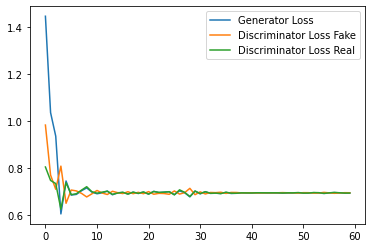

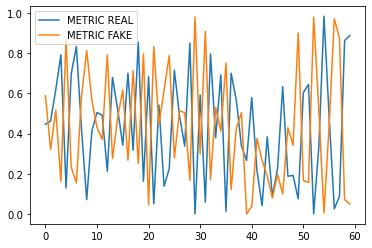

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1250: Generator loss: 0.6928686173756917, discriminator loss: 0.787092889547348
Espectrogramas Generados


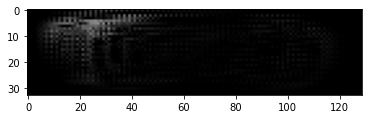

Espectrogramas Reales


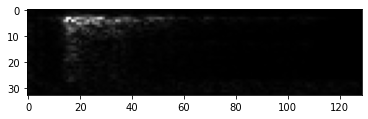

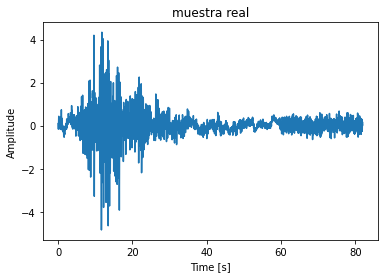

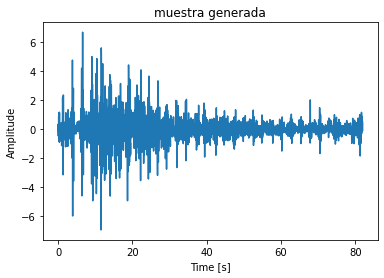

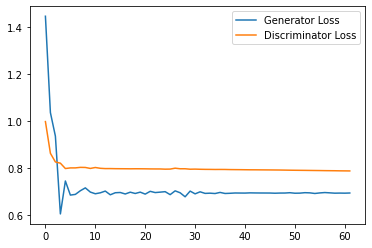

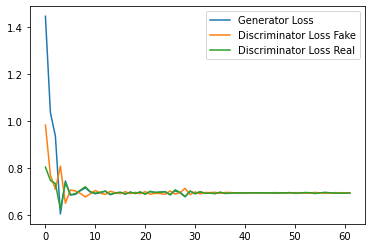

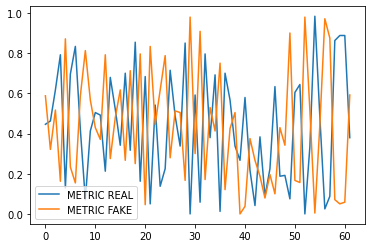

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1300: Generator loss: 0.6926077707608542, discriminator loss: 0.7864459586143494
Espectrogramas Generados


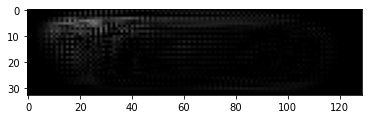

Espectrogramas Reales


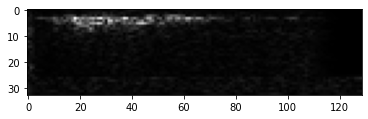

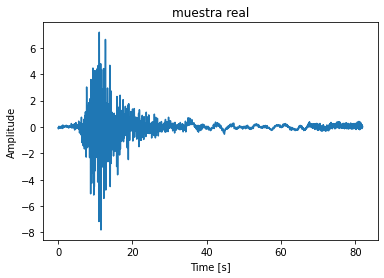

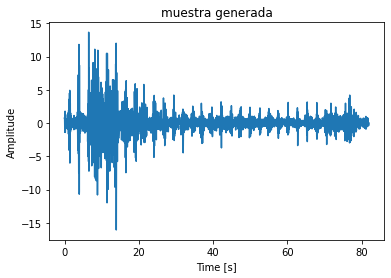

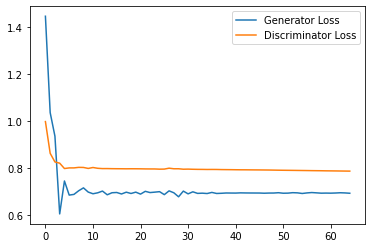

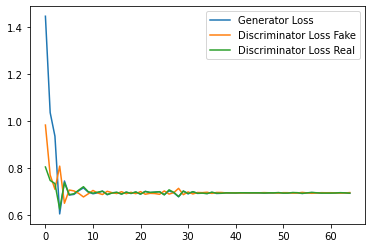

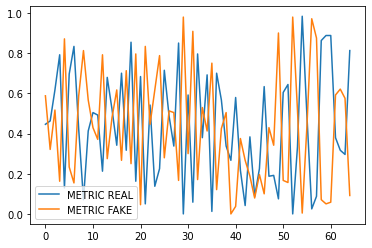

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1350: Generator loss: 0.6932817820707957, discriminator loss: 0.7857428956031799
Espectrogramas Generados


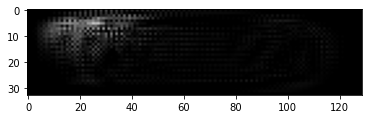

Espectrogramas Reales


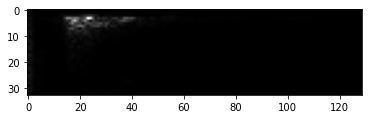

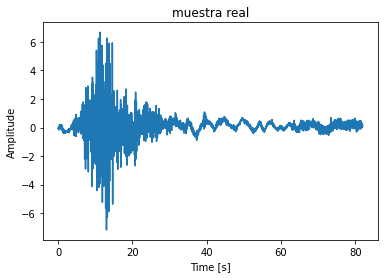

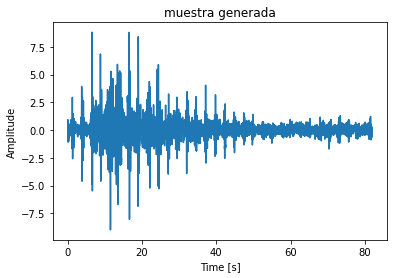

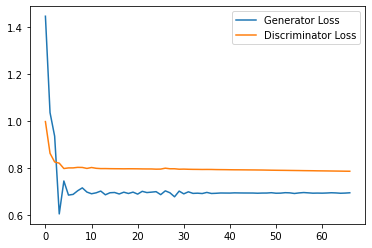

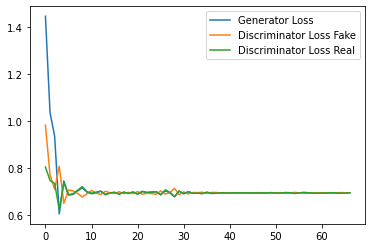

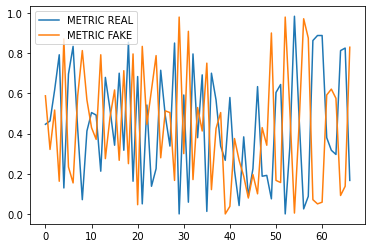

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1400: Generator loss: 0.692581941684087, discriminator loss: 0.7850389301776886
Espectrogramas Generados


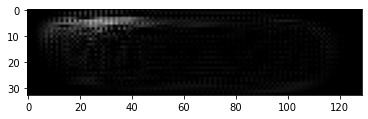

Espectrogramas Reales


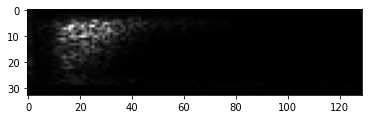

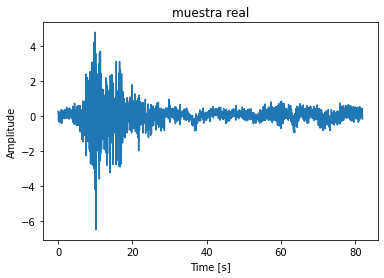

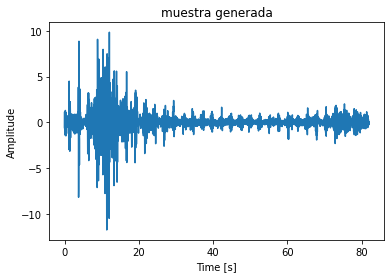

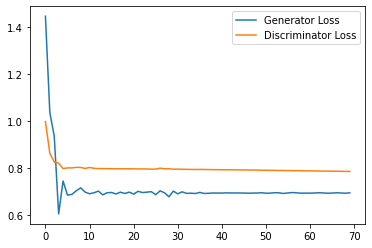

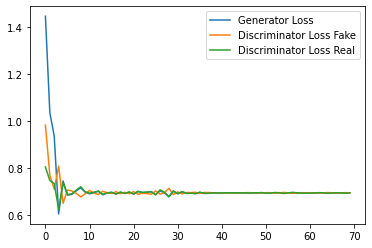

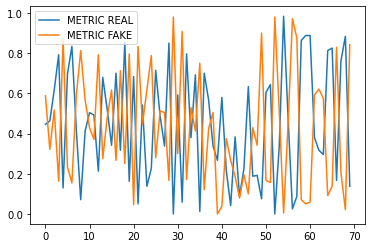

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1450: Generator loss: 0.6931806075572966, discriminator loss: 0.7843420374393463
Espectrogramas Generados


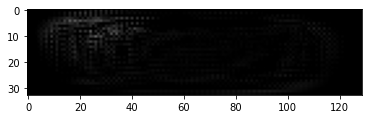

Espectrogramas Reales


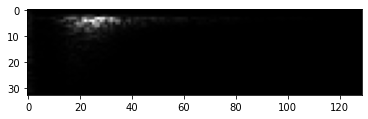

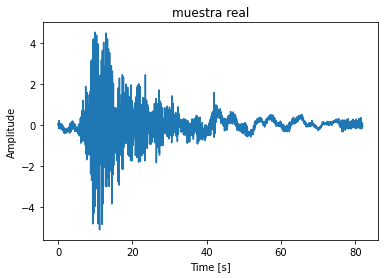

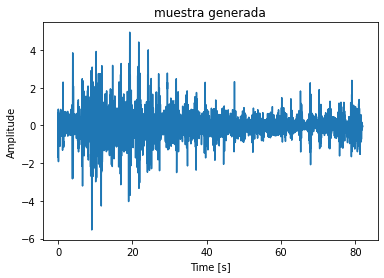

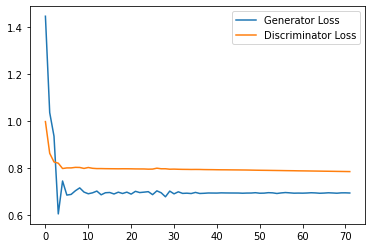

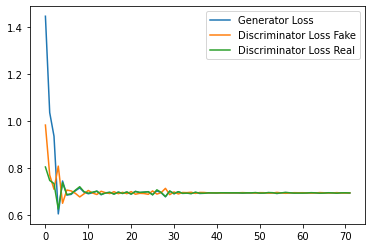

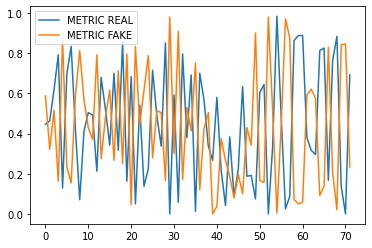

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1500: Generator loss: 0.69306872288386, discriminator loss: 0.7836200380325318
Espectrogramas Generados


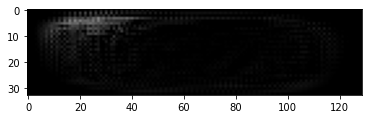

Espectrogramas Reales


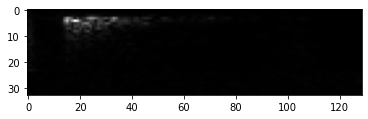

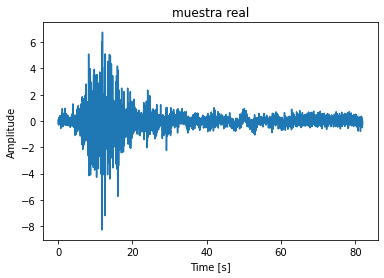

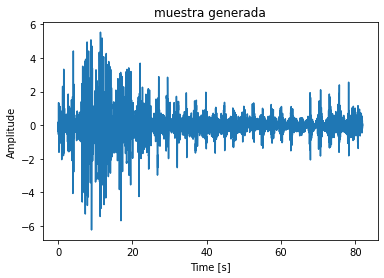

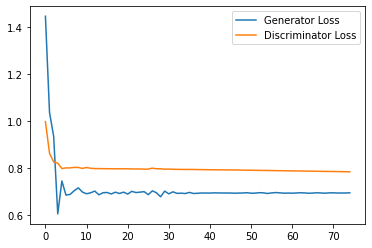

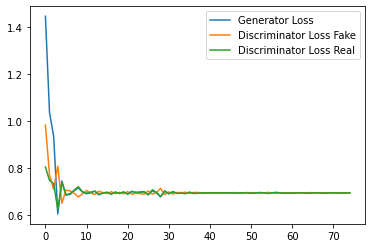

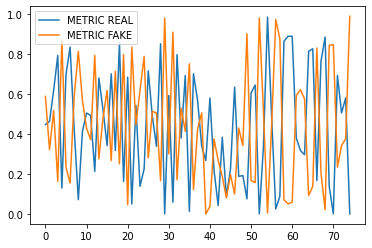

Epoch: 3


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1550: Generator loss: 0.6929373955726623, discriminator loss: 0.7829260039329529
Espectrogramas Generados


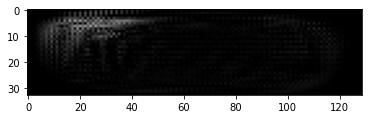

Espectrogramas Reales


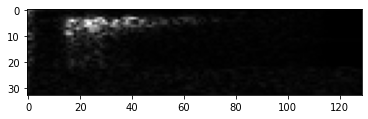

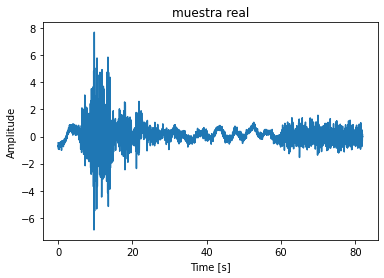

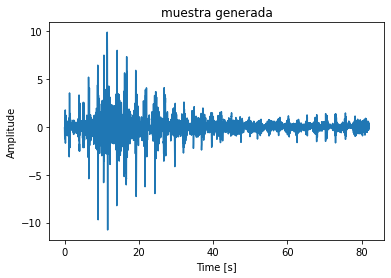

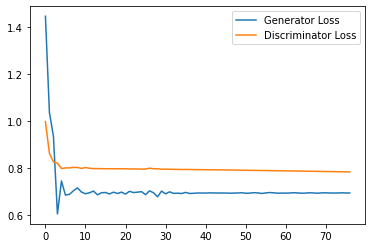

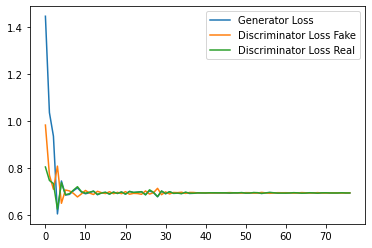

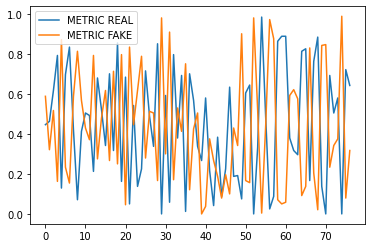

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1600: Generator loss: 0.6931148294607797, discriminator loss: 0.782203973531723
Espectrogramas Generados


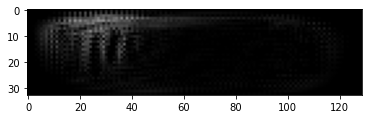

Espectrogramas Reales


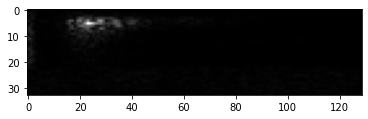

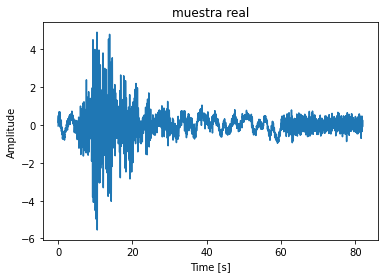

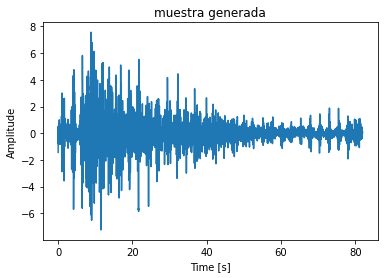

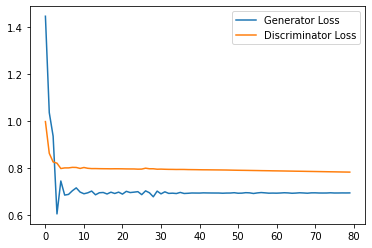

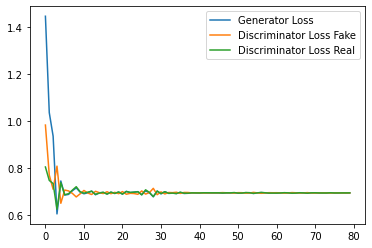

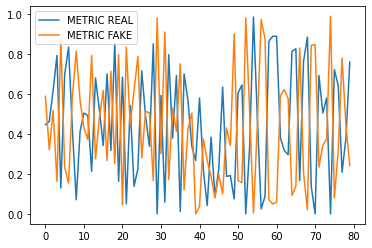

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1650: Generator loss: 0.6926022112369536, discriminator loss: 0.7814756989479065
Espectrogramas Generados


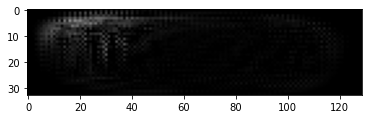

Espectrogramas Reales


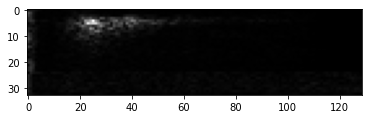

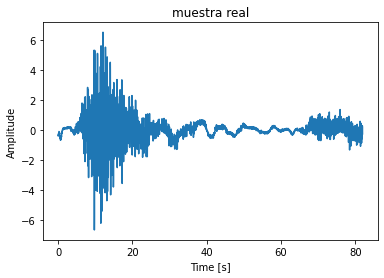

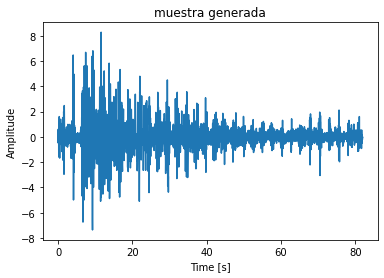

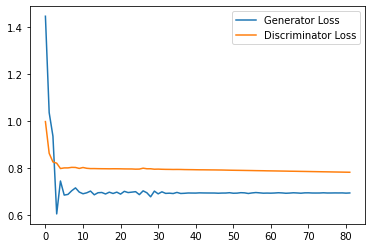

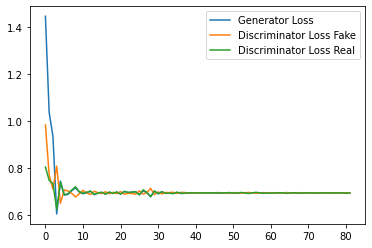

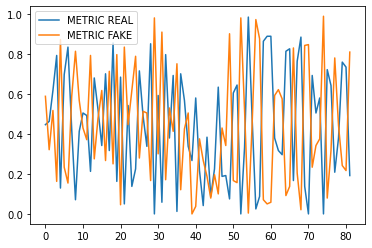

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1700: Generator loss: 0.6931459629535673, discriminator loss: 0.7807671868801117
Espectrogramas Generados


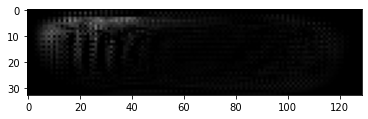

Espectrogramas Reales


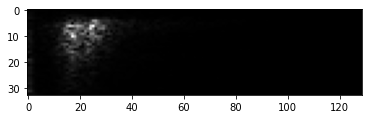

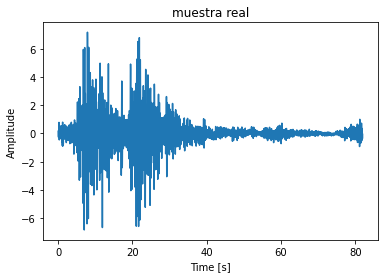

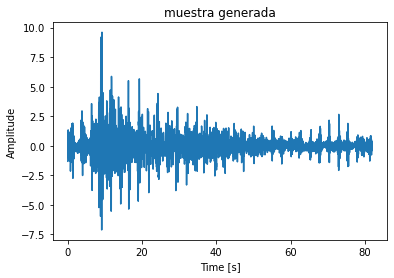

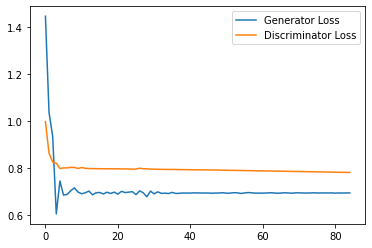

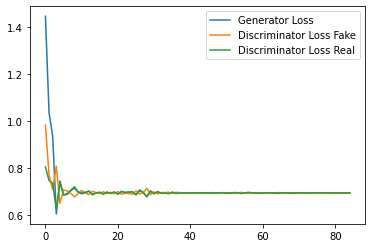

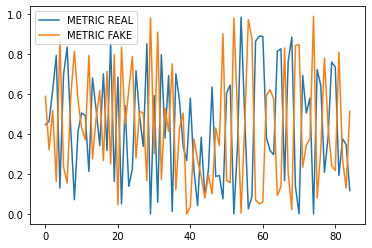

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1750: Generator loss: 0.6936651937166849, discriminator loss: 0.779988819360733
Espectrogramas Generados


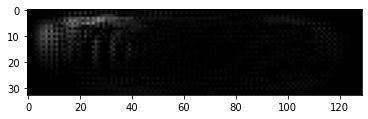

Espectrogramas Reales


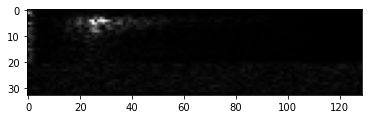

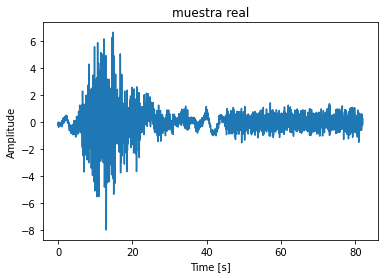

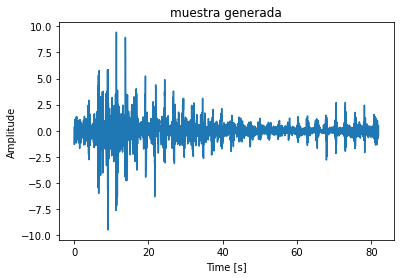

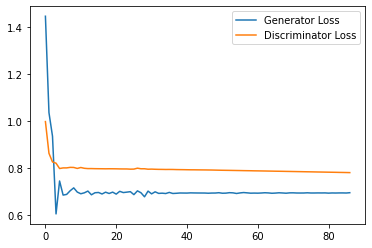

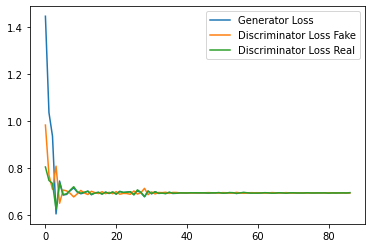

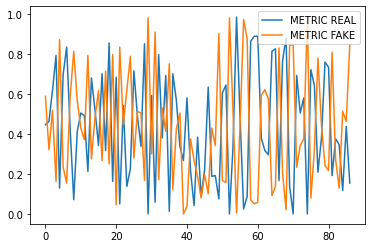

Step 1800: Generator loss: 0.6926780525843302, discriminator loss: 0.7792363393306733
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


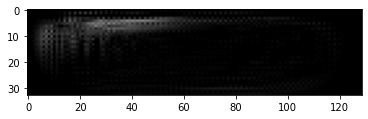

Espectrogramas Reales


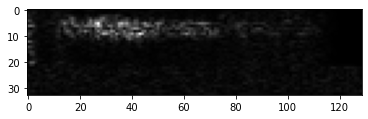

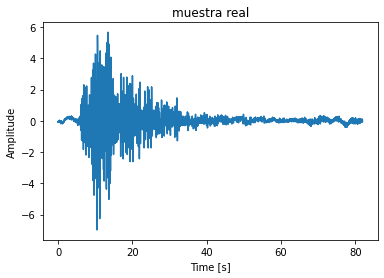

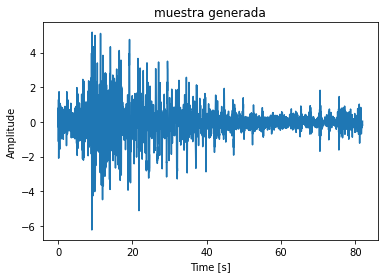

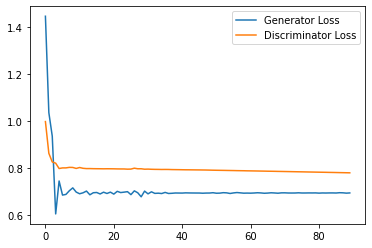

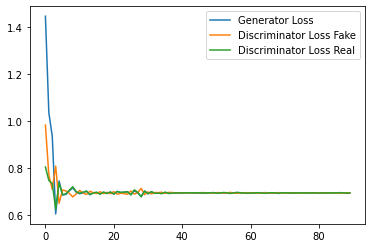

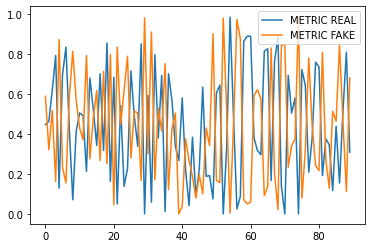

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1850: Generator loss: 0.6923509653409322, discriminator loss: 0.7784944462776184
Espectrogramas Generados


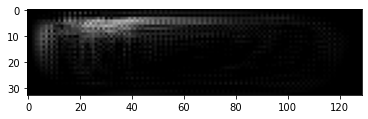

Espectrogramas Reales


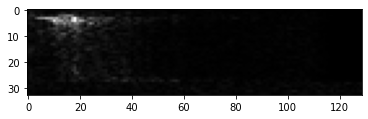

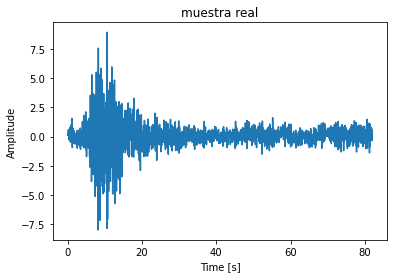

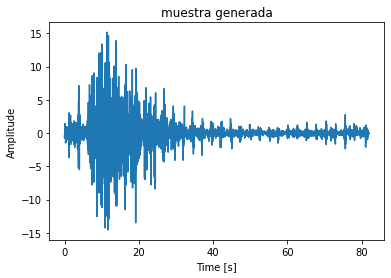

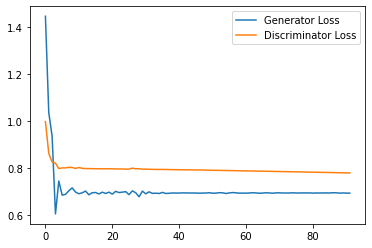

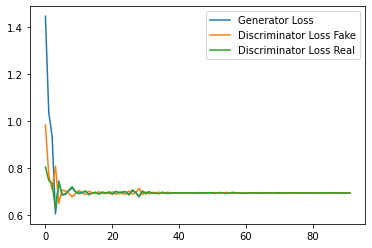

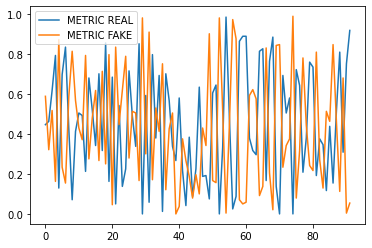

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1900: Generator loss: 0.6934980849425, discriminator loss: 0.7777006447315216
Espectrogramas Generados


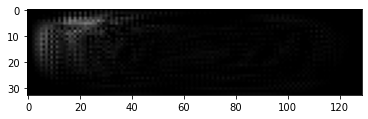

Espectrogramas Reales


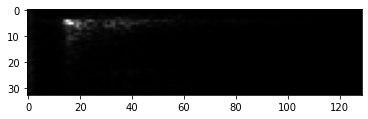

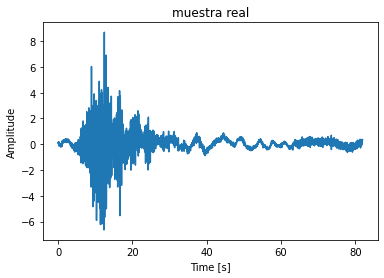

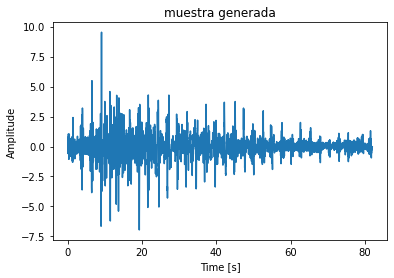

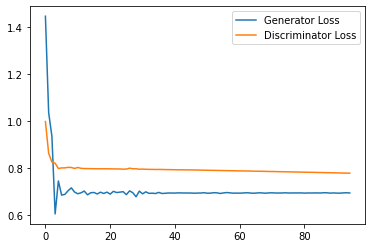

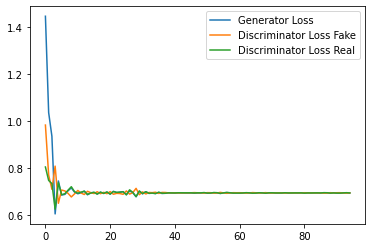

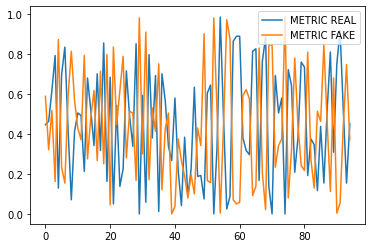

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 1950: Generator loss: 0.6931635900338492, discriminator loss: 0.7768912243843079
Espectrogramas Generados


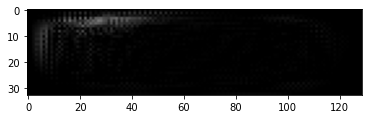

Espectrogramas Reales


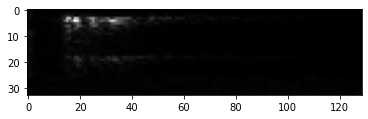

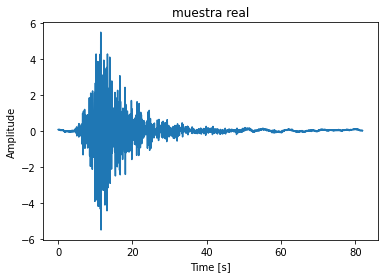

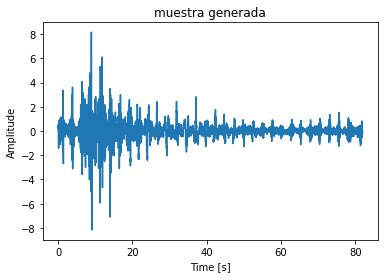

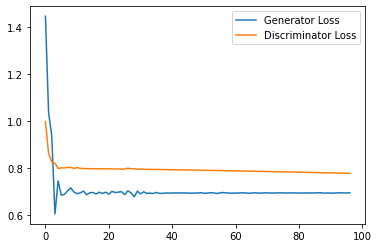

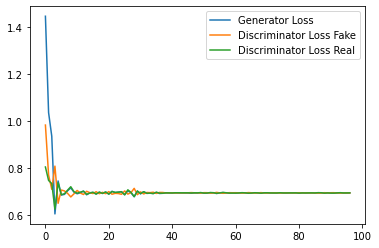

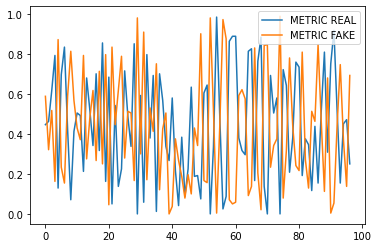

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2000: Generator loss: 0.69313139518102, discriminator loss: 0.776083984375
Espectrogramas Generados


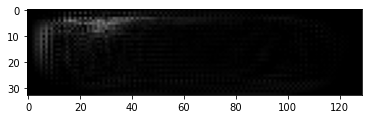

Espectrogramas Reales


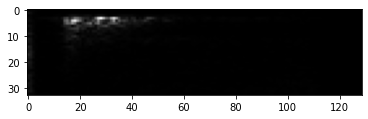

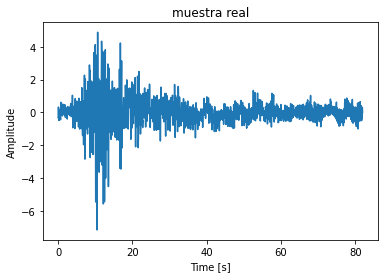

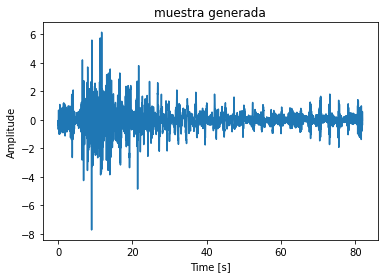

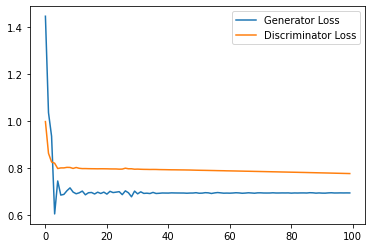

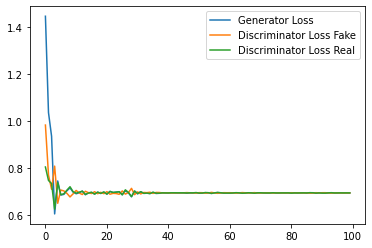

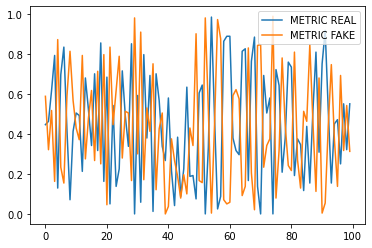

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2050: Generator loss: 0.6928706626097362, discriminator loss: 0.775274338722229
Espectrogramas Generados


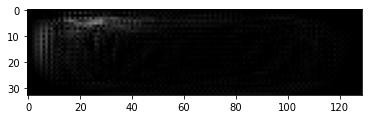

Espectrogramas Reales


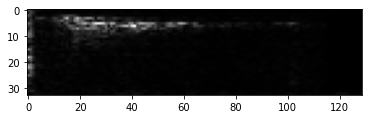

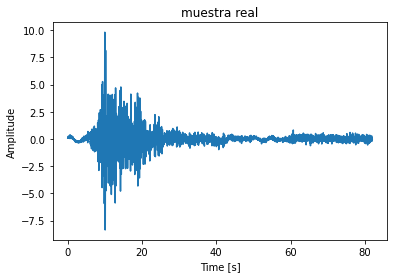

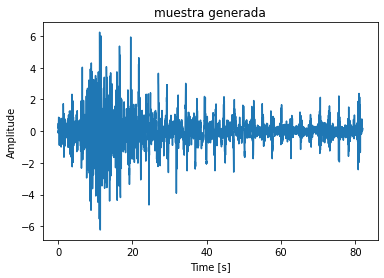

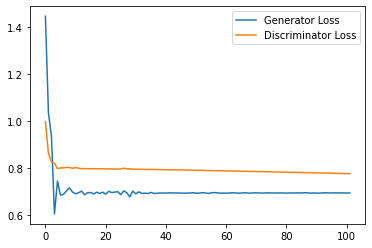

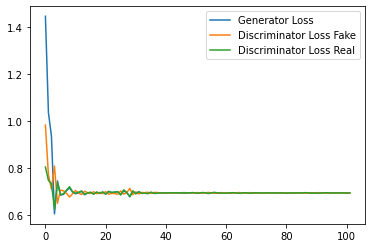

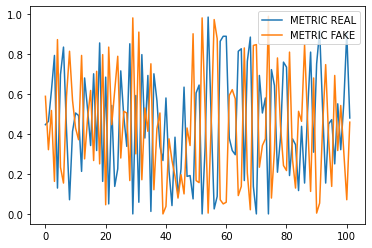

Epoch: 4


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2100: Generator loss: 0.6932239957650503, discriminator loss: 0.7744747161865234
Espectrogramas Generados


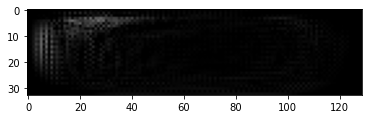

Espectrogramas Reales


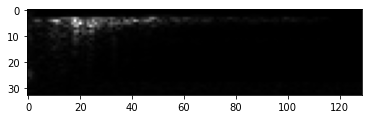

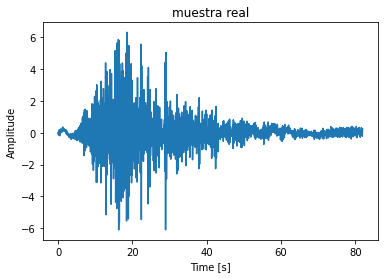

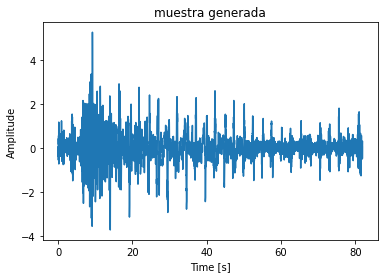

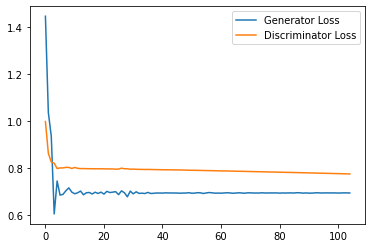

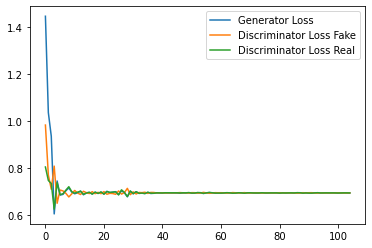

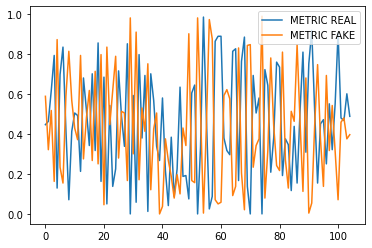

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2150: Generator loss: 0.6930041909217833, discriminator loss: 0.7736643290519715
Espectrogramas Generados


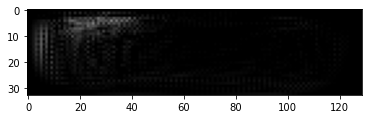

Espectrogramas Reales


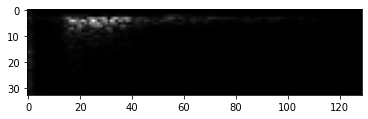

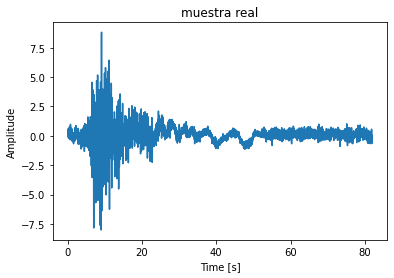

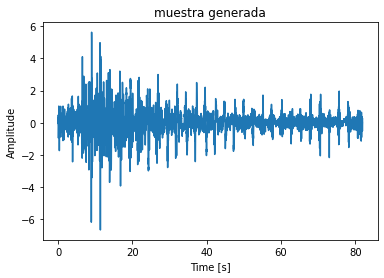

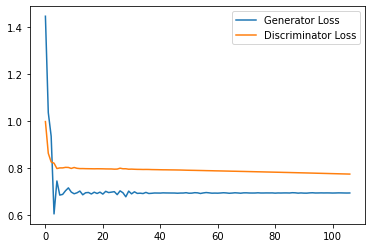

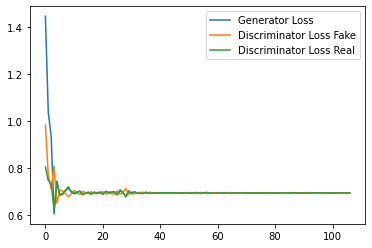

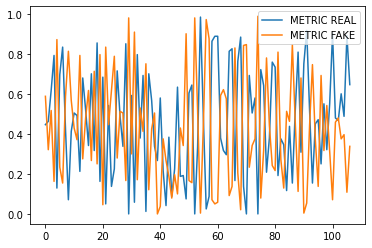

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2200: Generator loss: 0.693364777167638, discriminator loss: 0.7728513789176941
Espectrogramas Generados


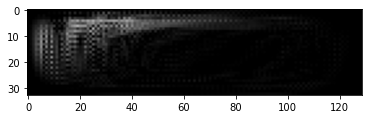

Espectrogramas Reales


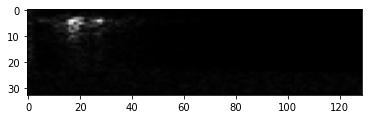

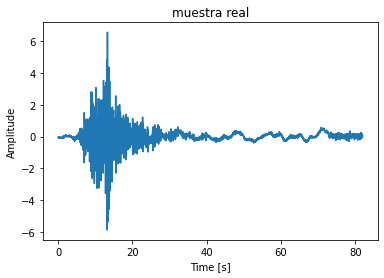

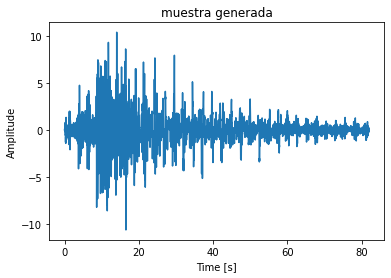

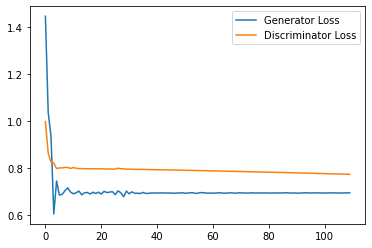

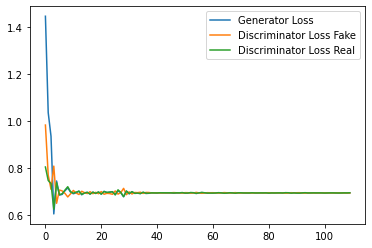

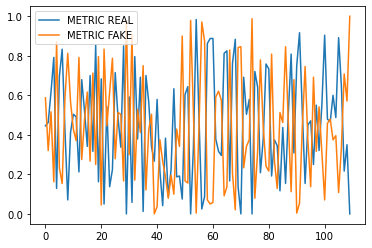

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2250: Generator loss: 0.6930722562472026, discriminator loss: 0.7720241236686707
Espectrogramas Generados


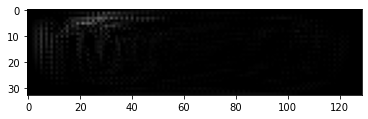

Espectrogramas Reales


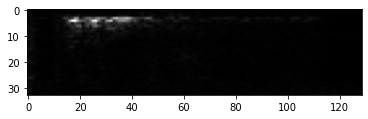

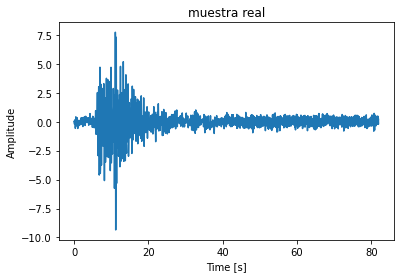

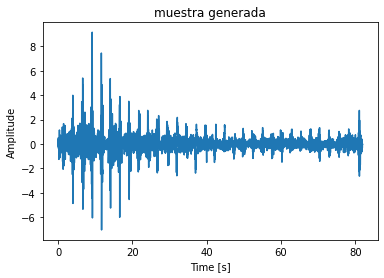

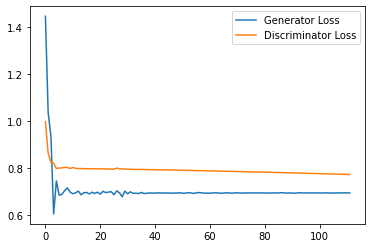

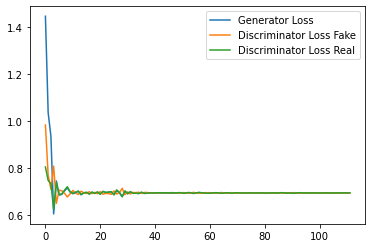

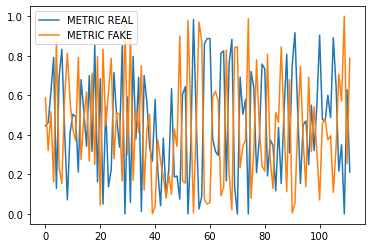

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2300: Generator loss: 0.6931911361217499, discriminator loss: 0.7711840760707855
Espectrogramas Generados


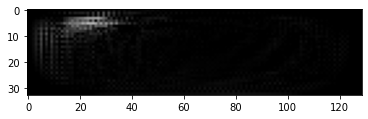

Espectrogramas Reales


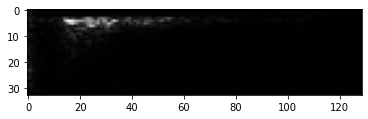

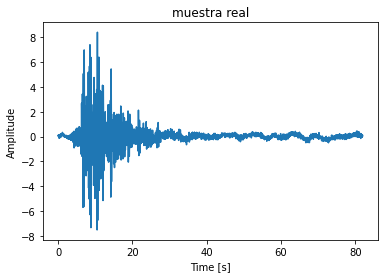

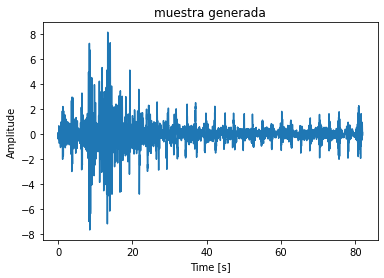

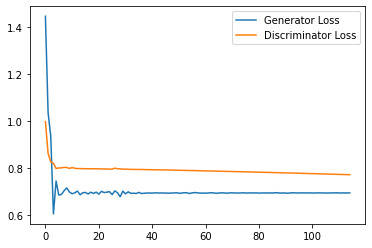

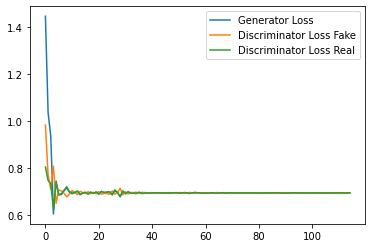

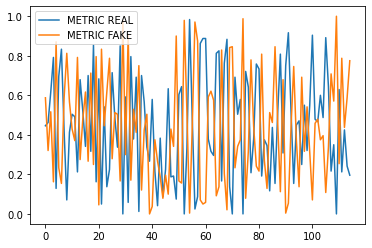

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2350: Generator loss: 0.692903915643692, discriminator loss: 0.7703342521190644
Espectrogramas Generados


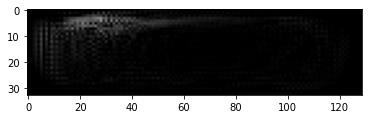

Espectrogramas Reales


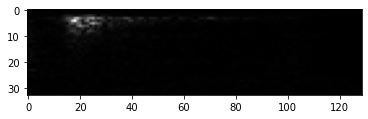

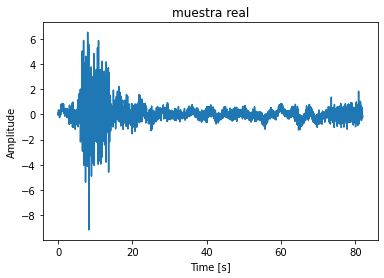

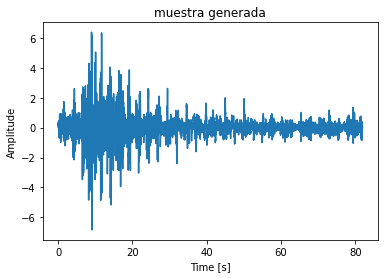

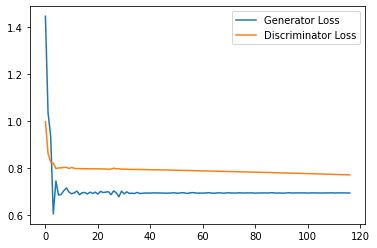

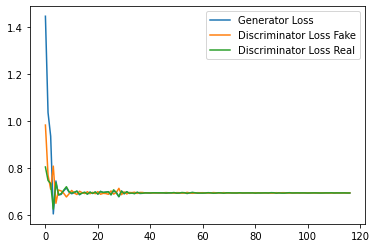

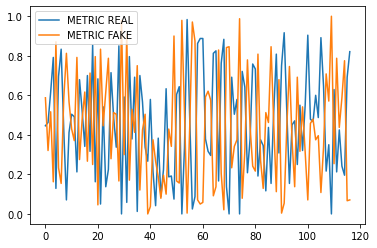

Step 2400: Generator loss: 0.693139210542043, discriminator loss: 0.7694787538051605
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


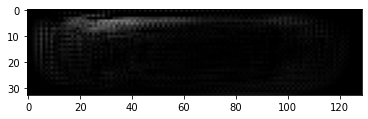

Espectrogramas Reales


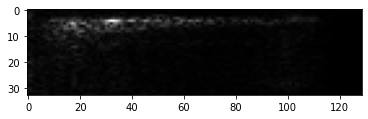

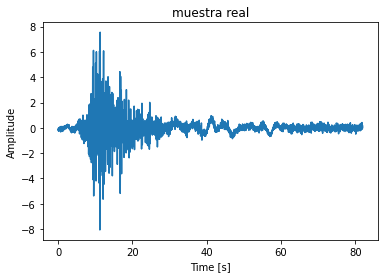

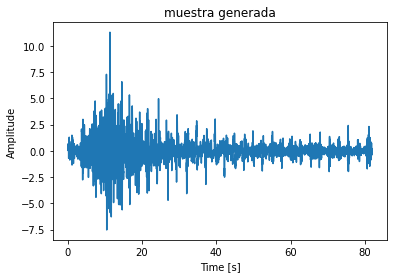

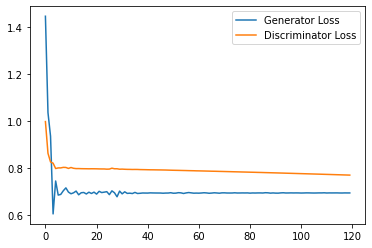

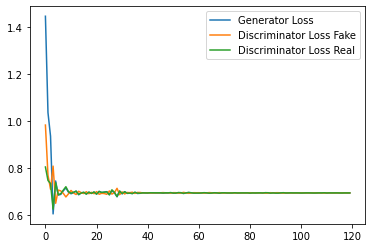

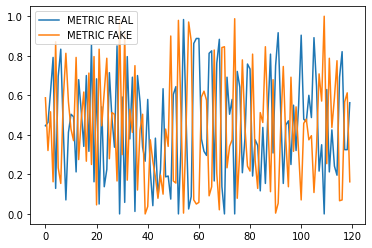

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2450: Generator loss: 0.6932243303457897, discriminator loss: 0.7686327958106994
Espectrogramas Generados


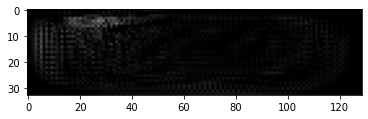

Espectrogramas Reales


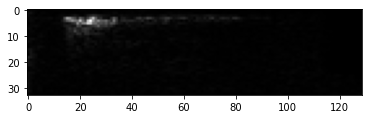

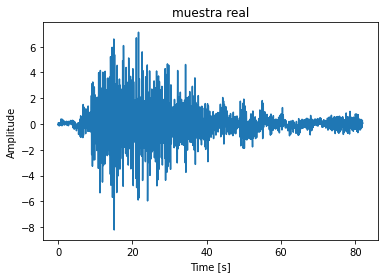

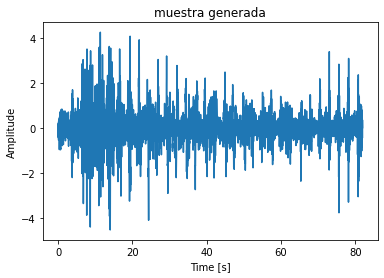

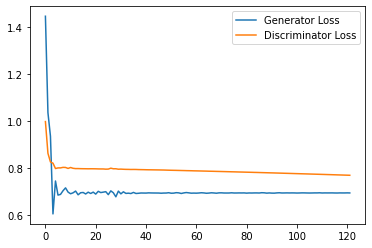

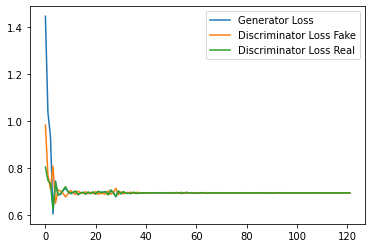

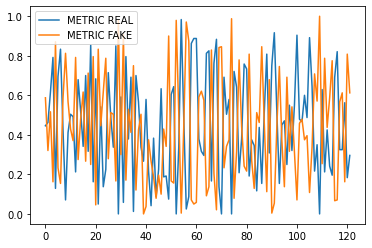

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2500: Generator loss: 0.6929357659816744, discriminator loss: 0.7677866983413696
Espectrogramas Generados


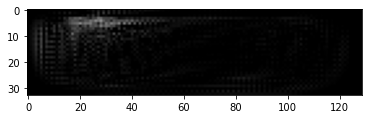

Espectrogramas Reales


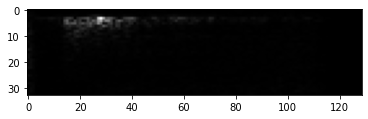

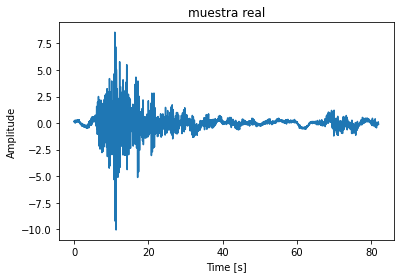

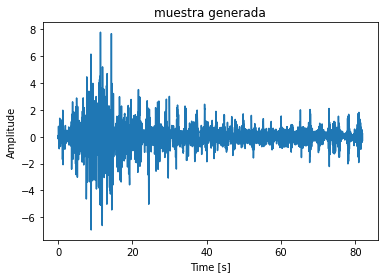

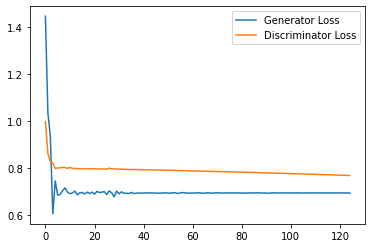

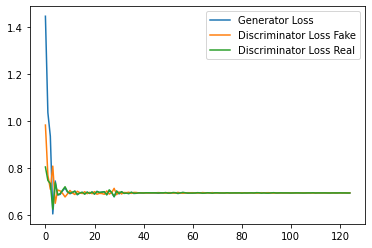

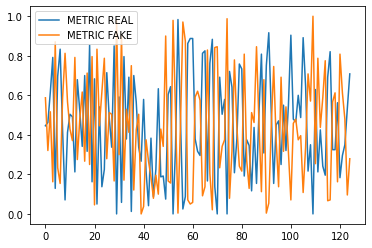

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2550: Generator loss: 0.6932936028639476, discriminator loss: 0.7669135284423828
Espectrogramas Generados


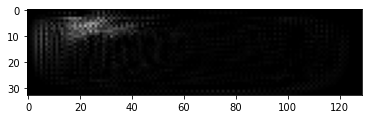

Espectrogramas Reales


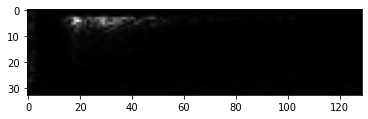

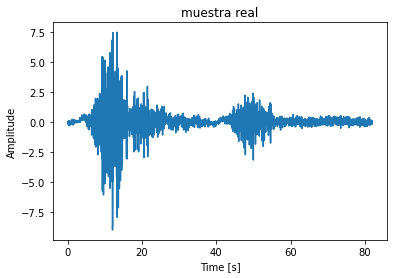

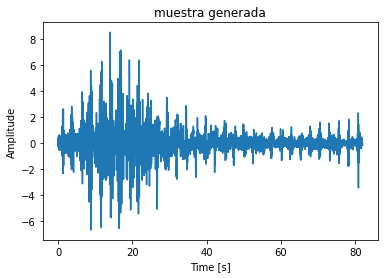

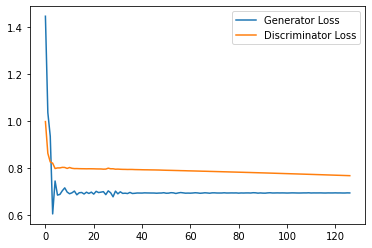

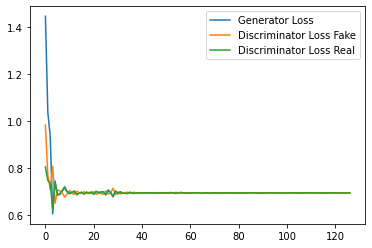

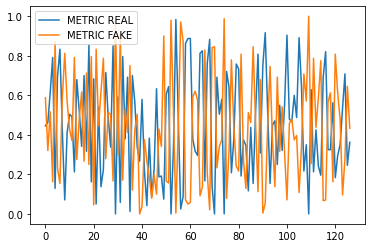

Epoch: 5


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2600: Generator loss: 0.6931121098995209, discriminator loss: 0.7660388839244843
Espectrogramas Generados


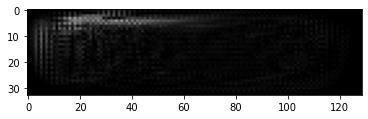

Espectrogramas Reales


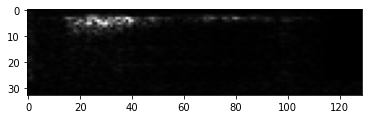

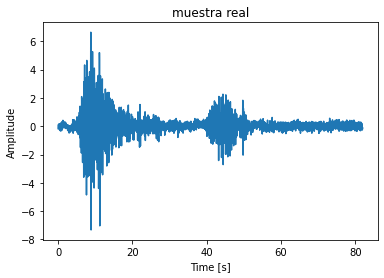

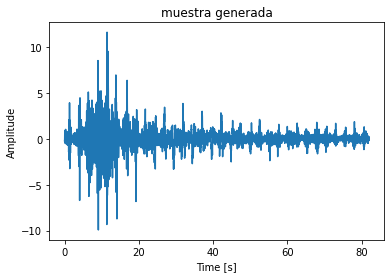

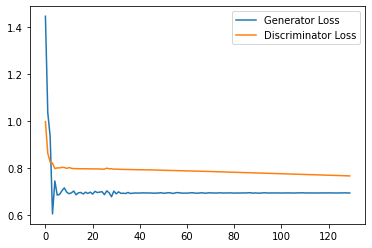

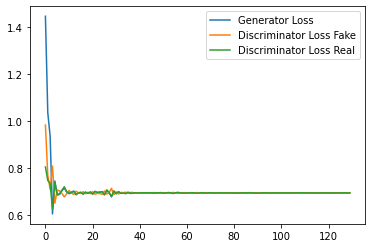

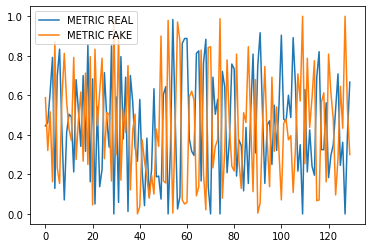

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2650: Generator loss: 0.6931058724721274, discriminator loss: 0.765153490304947
Espectrogramas Generados


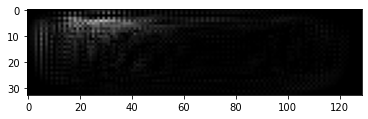

Espectrogramas Reales


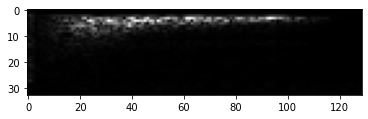

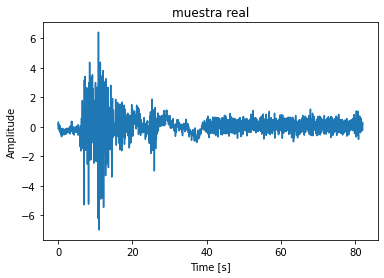

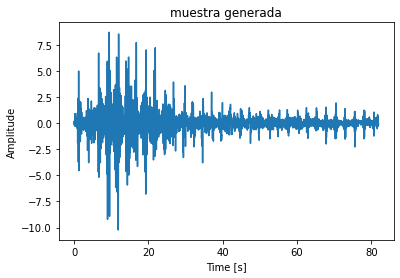

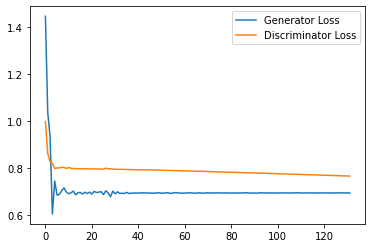

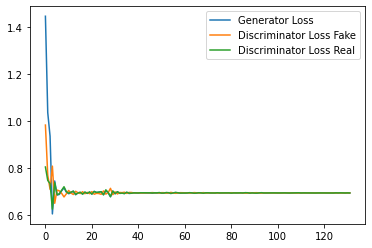

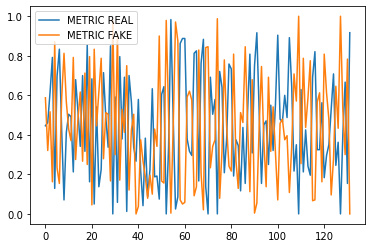

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2700: Generator loss: 0.6930321184794108, discriminator loss: 0.7642856287956238
Espectrogramas Generados


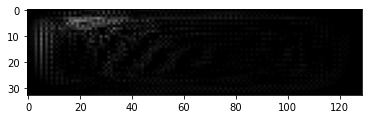

Espectrogramas Reales


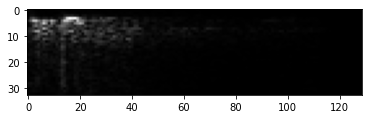

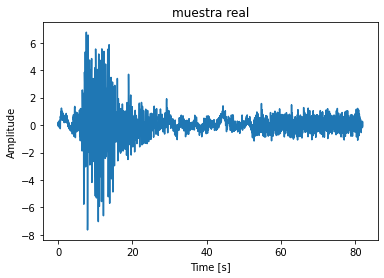

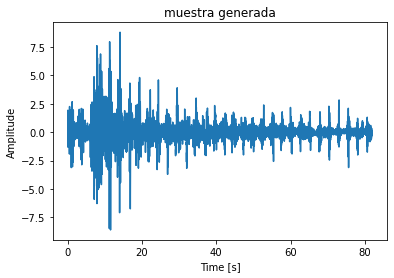

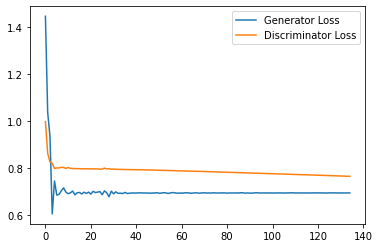

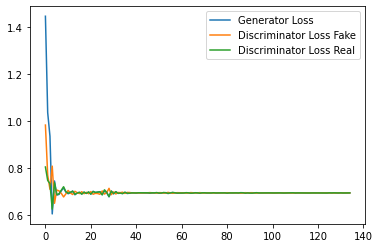

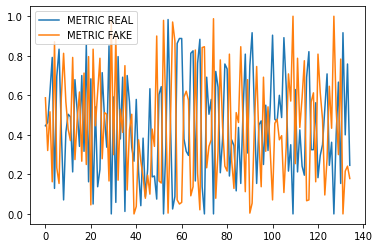

Step 2750: Generator loss: 0.6932980008920037, discriminator loss: 0.7634001970291138
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


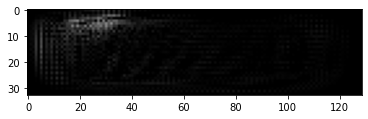

Espectrogramas Reales


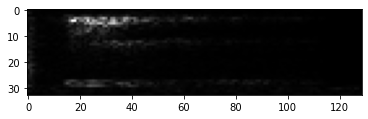

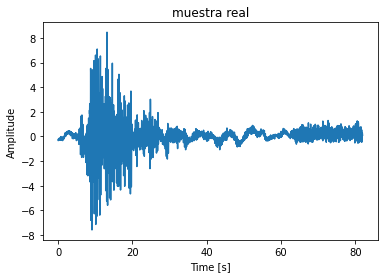

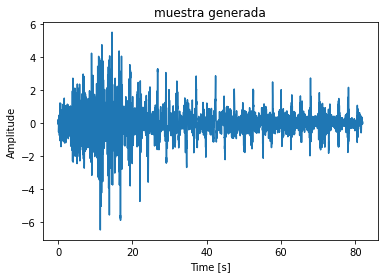

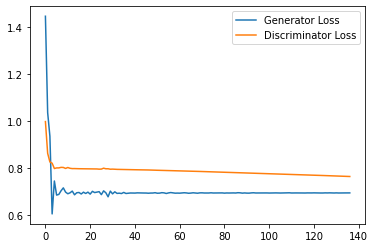

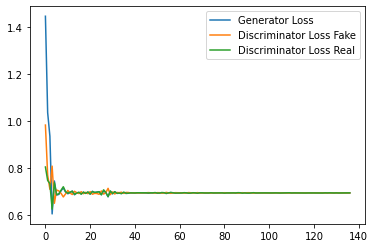

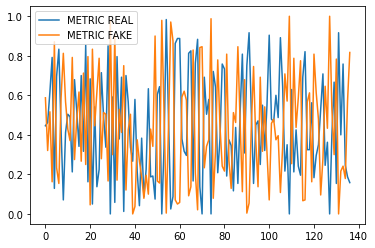

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2800: Generator loss: 0.6933571946620941, discriminator loss: 0.7624756598472595
Espectrogramas Generados


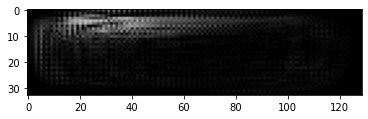

Espectrogramas Reales


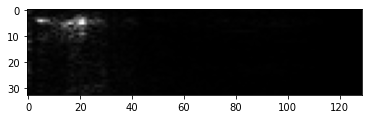

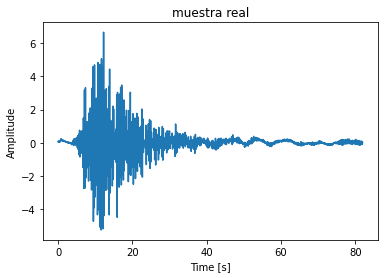

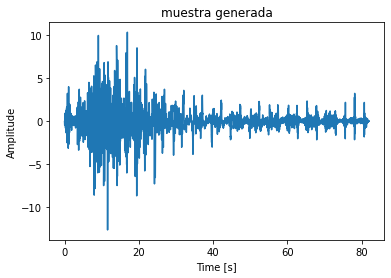

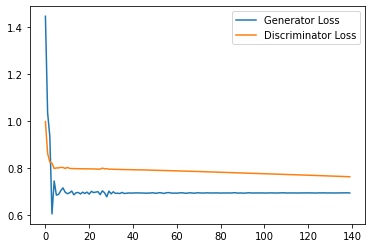

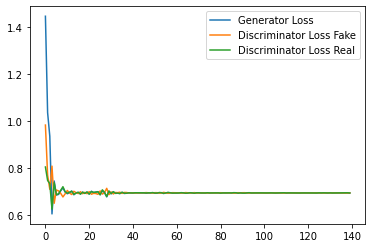

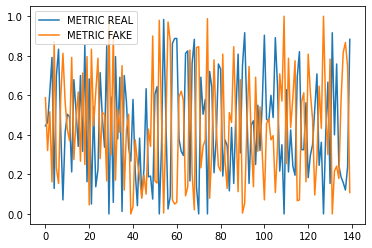

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2850: Generator loss: 0.6930790328979494, discriminator loss: 0.7615804314613343
Espectrogramas Generados


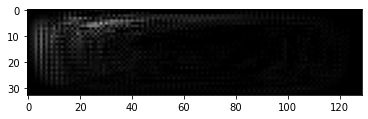

Espectrogramas Reales


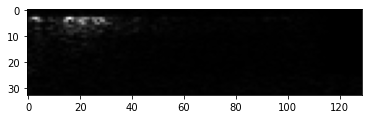

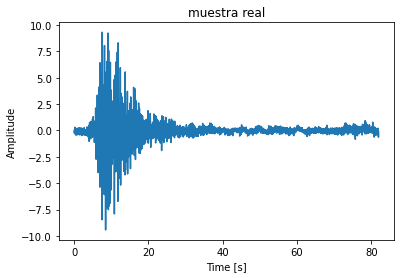

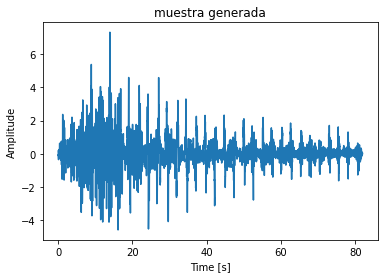

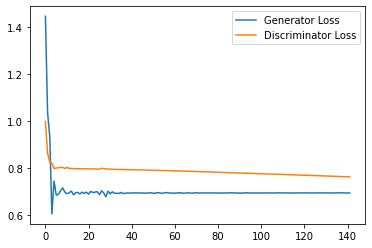

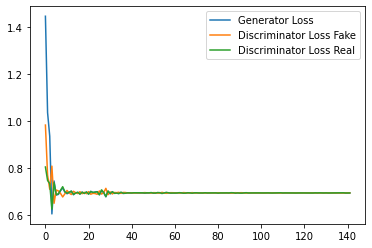

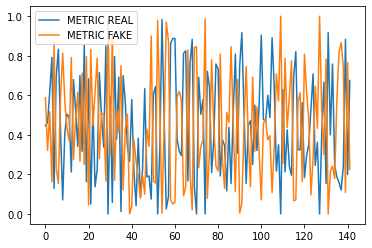

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2900: Generator loss: 0.6928822215398153, discriminator loss: 0.7606911361217499
Espectrogramas Generados


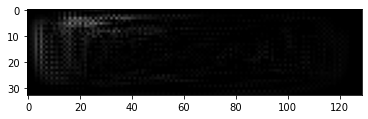

Espectrogramas Reales


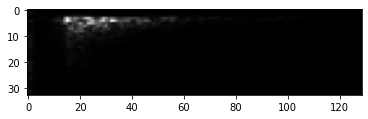

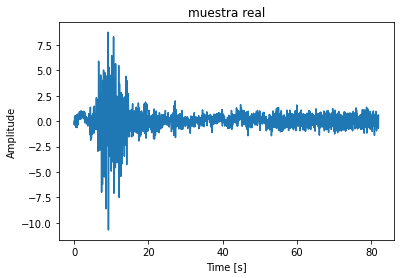

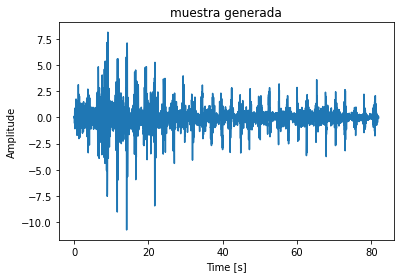

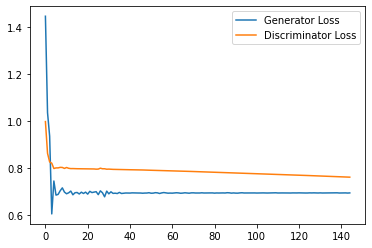

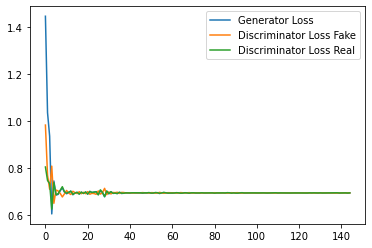

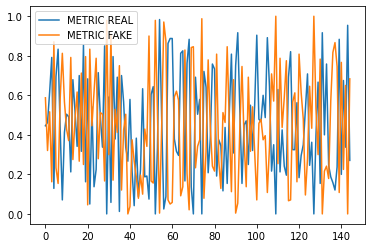

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 2950: Generator loss: 0.6932164426644642, discriminator loss: 0.7597882282733918
Espectrogramas Generados


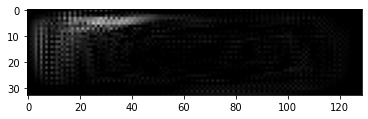

Espectrogramas Reales


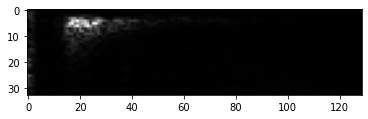

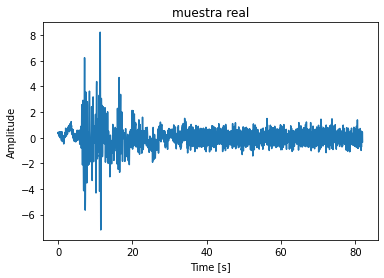

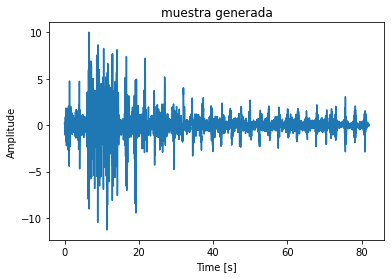

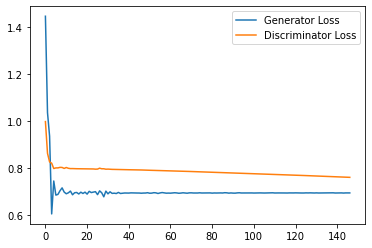

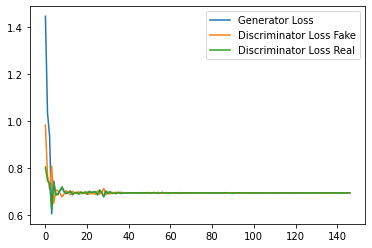

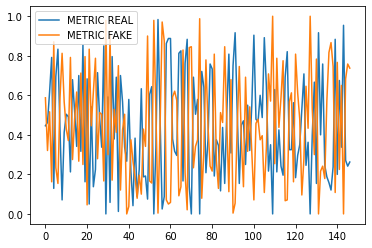

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3000: Generator loss: 0.6927172334988911, discriminator loss: 0.7588589918613434
Espectrogramas Generados


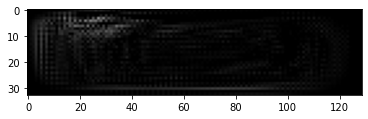

Espectrogramas Reales


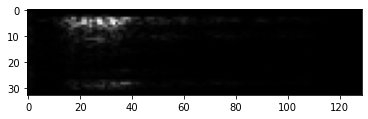

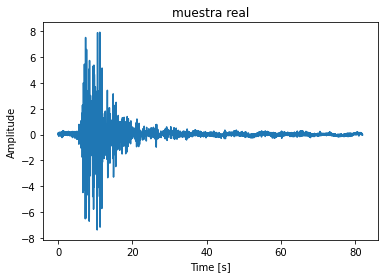

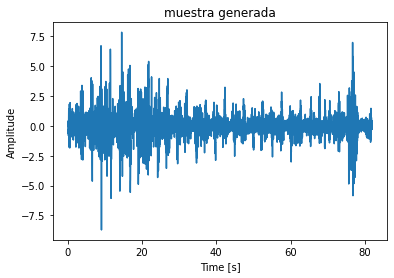

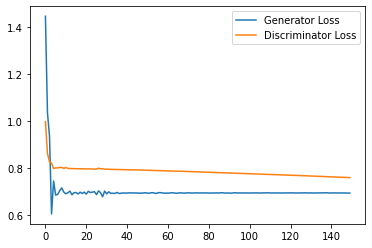

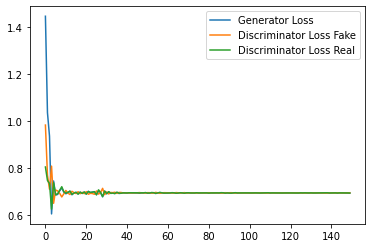

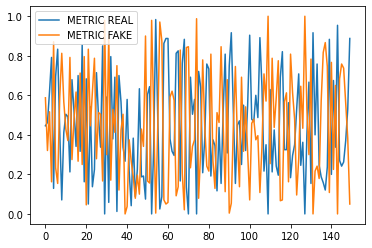

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3050: Generator loss: 0.6929359261194865, discriminator loss: 0.7579226946830749
Espectrogramas Generados


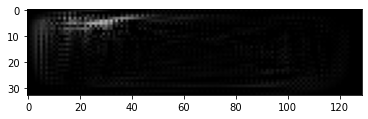

Espectrogramas Reales


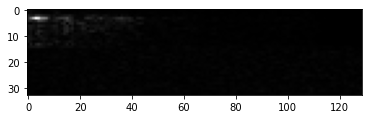

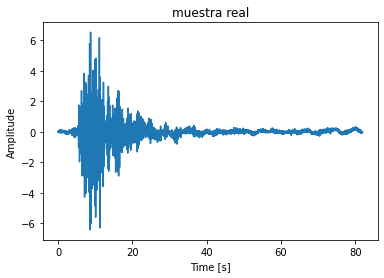

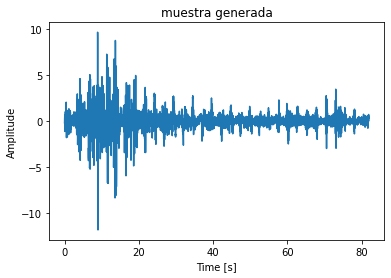

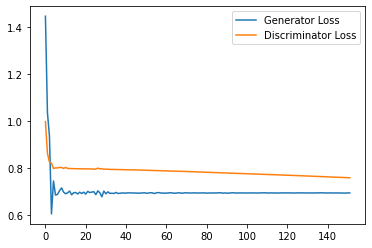

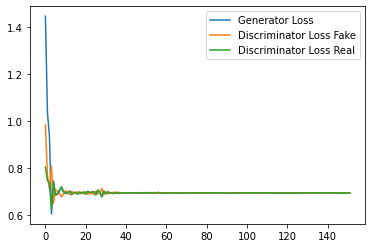

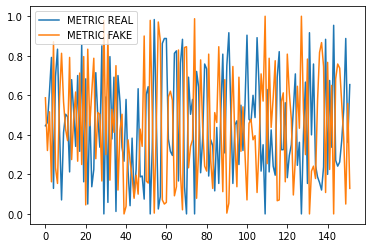

Epoch: 6


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3100: Generator loss: 0.6933685902754465, discriminator loss: 0.756981189250946
Espectrogramas Generados


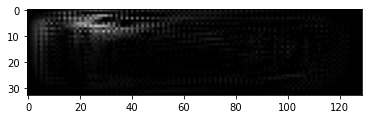

Espectrogramas Reales


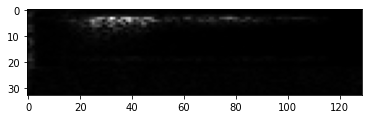

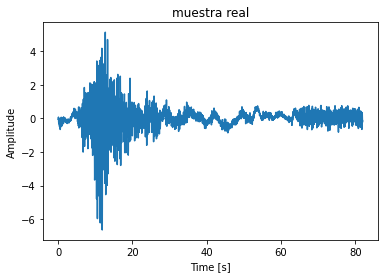

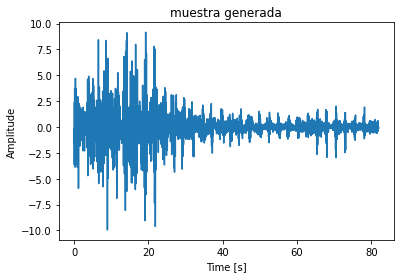

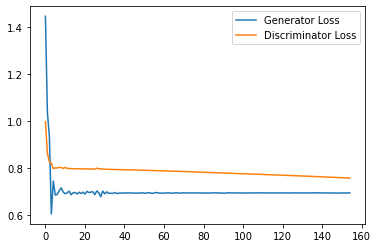

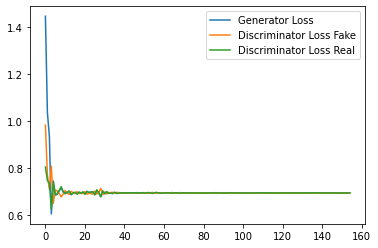

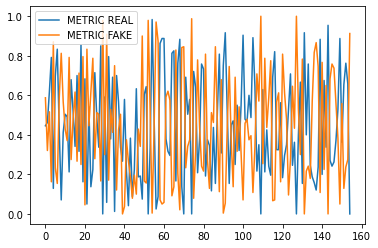

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3150: Generator loss: 0.6935896941026052, discriminator loss: 0.7560445404052735
Espectrogramas Generados


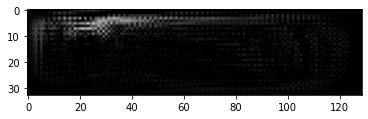

Espectrogramas Reales


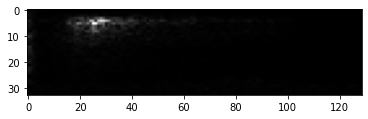

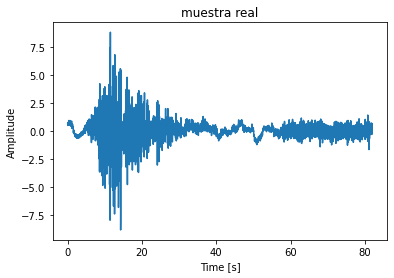

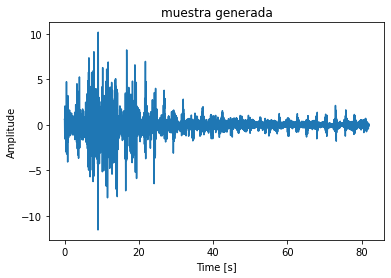

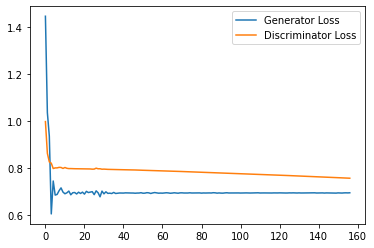

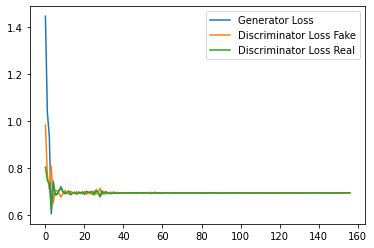

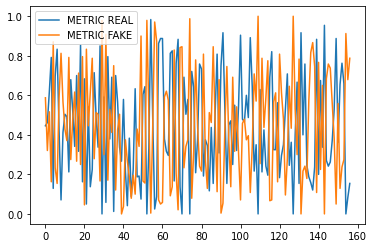

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3200: Generator loss: 0.6929971770445504, discriminator loss: 0.7551140451431274
Espectrogramas Generados


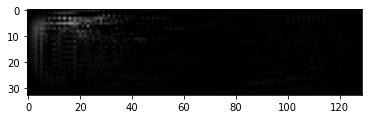

Espectrogramas Reales


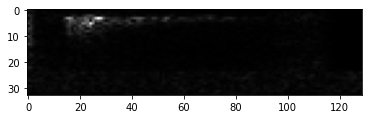

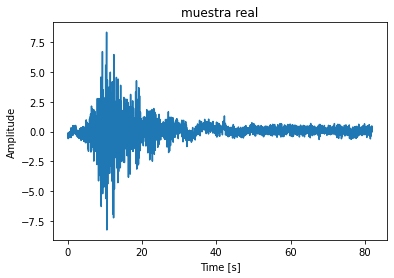

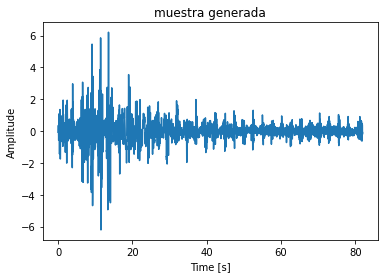

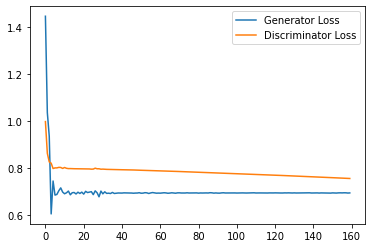

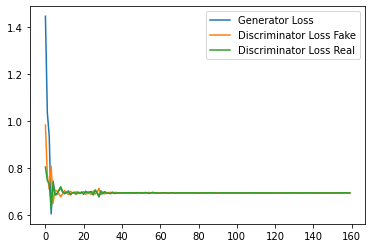

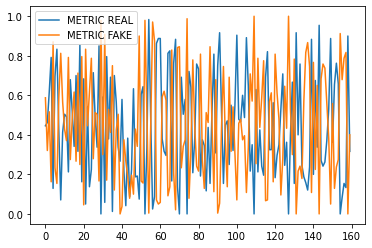

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3250: Generator loss: 0.6931743733088175, discriminator loss: 0.7541655898094177
Espectrogramas Generados


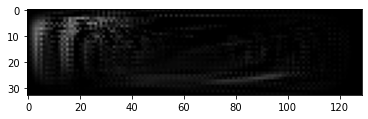

Espectrogramas Reales


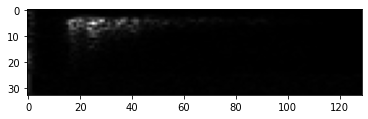

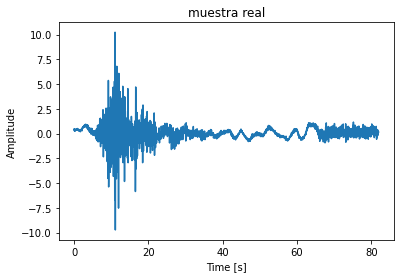

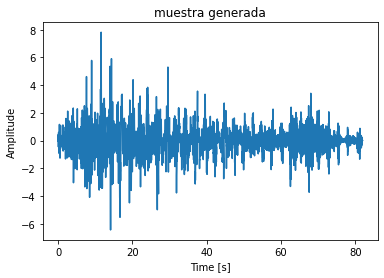

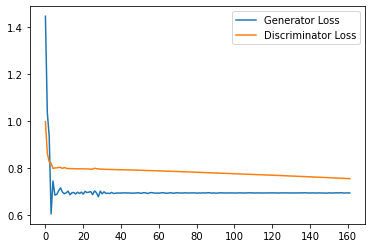

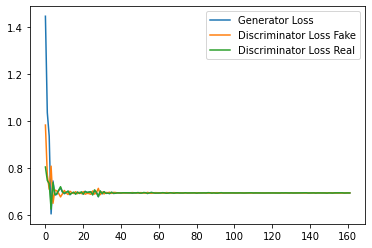

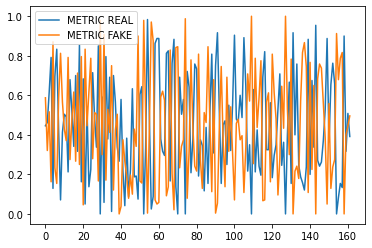

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3300: Generator loss: 0.6930974320570629, discriminator loss: 0.7532335376739502
Espectrogramas Generados


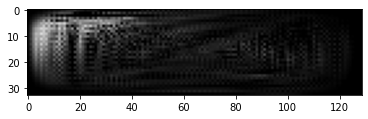

Espectrogramas Reales


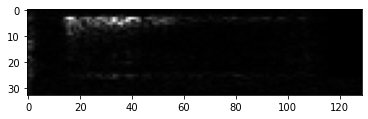

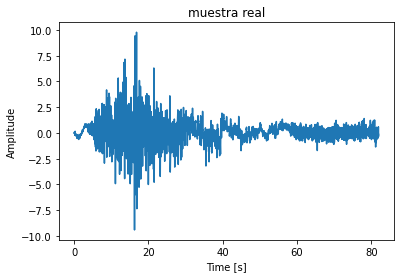

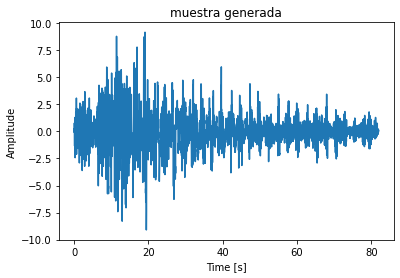

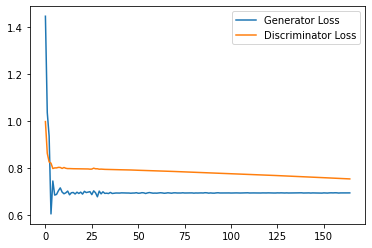

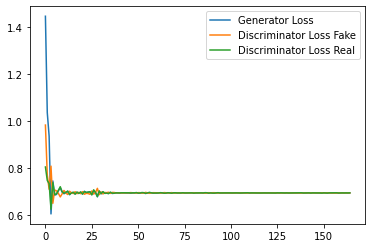

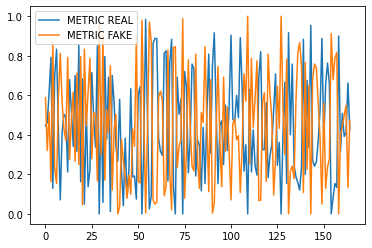

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3350: Generator loss: 0.6928127010663352, discriminator loss: 0.7522827780246735
Espectrogramas Generados


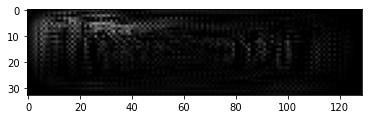

Espectrogramas Reales


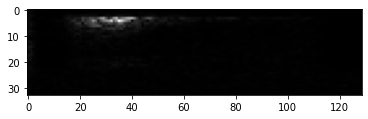

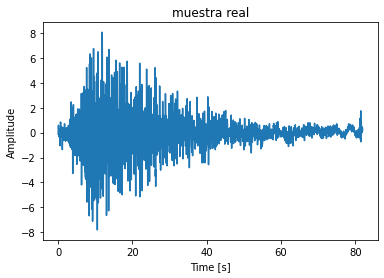

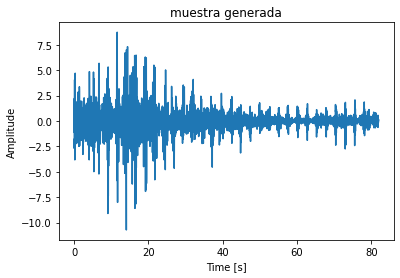

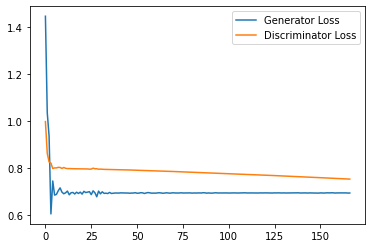

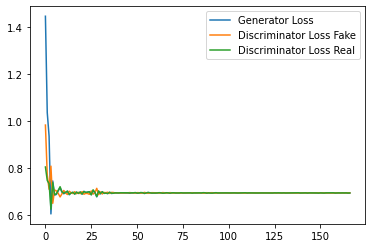

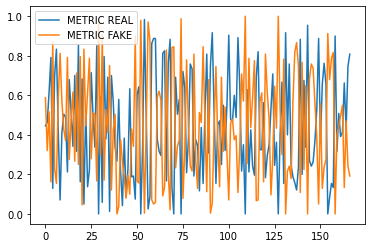

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3400: Generator loss: 0.6937559541066488, discriminator loss: 0.7513444340229034
Espectrogramas Generados


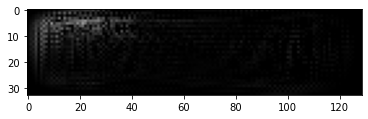

Espectrogramas Reales


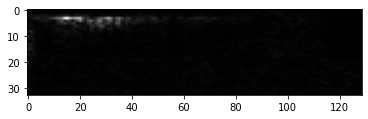

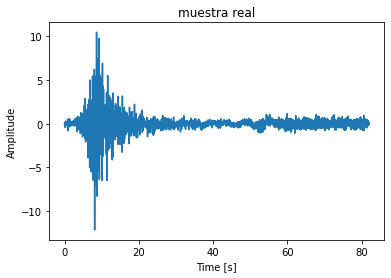

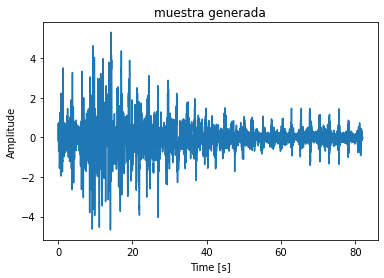

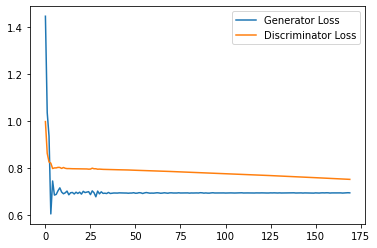

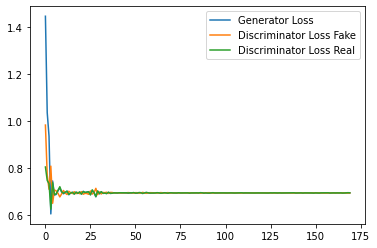

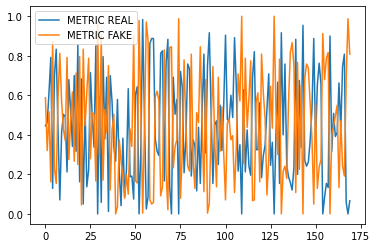

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3450: Generator loss: 0.6934961032867432, discriminator loss: 0.750383791923523
Espectrogramas Generados


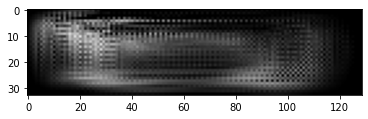

Espectrogramas Reales


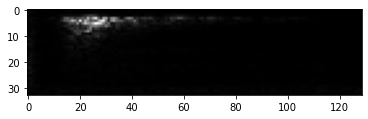

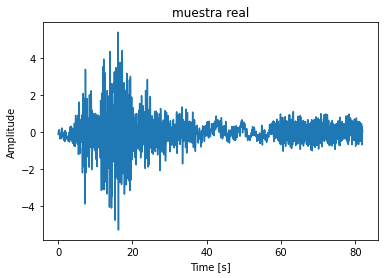

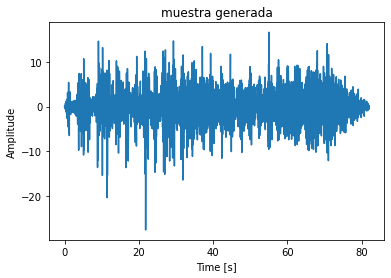

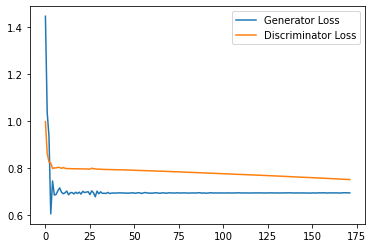

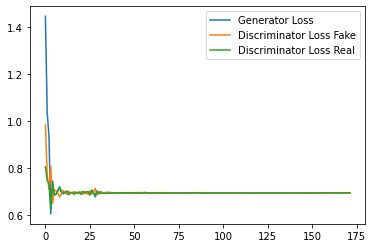

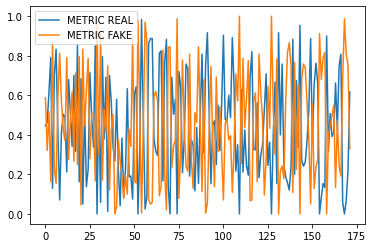

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3500: Generator loss: 0.6931781895955403, discriminator loss: 0.7494751727581024
Espectrogramas Generados


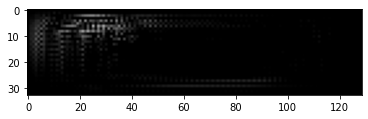

Espectrogramas Reales


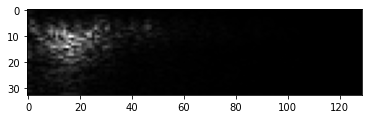

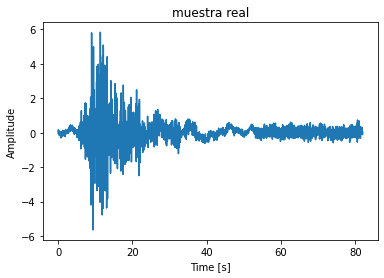

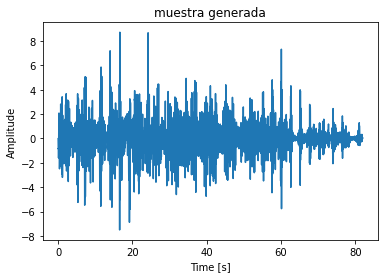

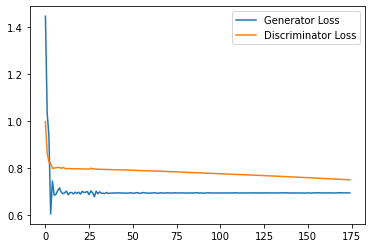

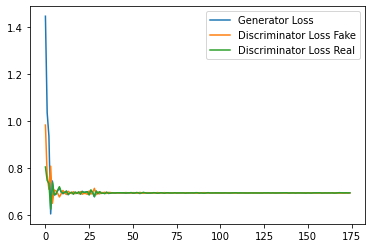

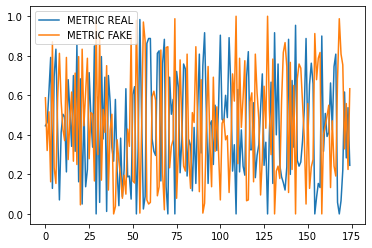

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3550: Generator loss: 0.6940816477934519, discriminator loss: 0.7485254442691803
Espectrogramas Generados


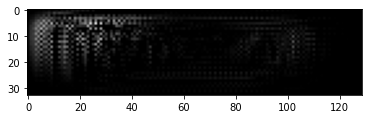

Espectrogramas Reales


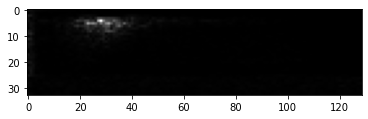

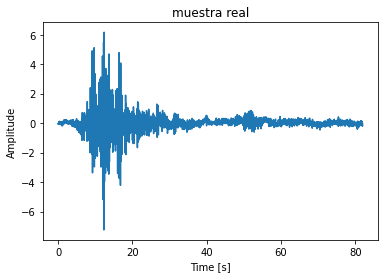

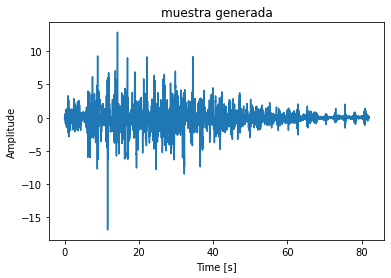

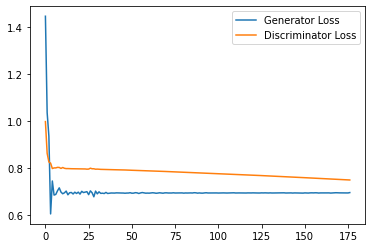

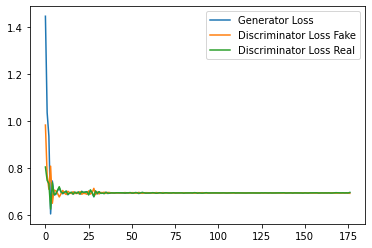

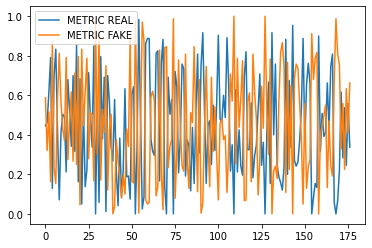

Epoch: 7


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3600: Generator loss: 0.6938971940676372, discriminator loss: 0.7475177729129792
Espectrogramas Generados


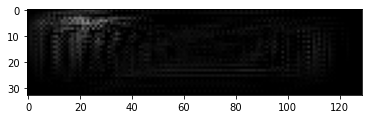

Espectrogramas Reales


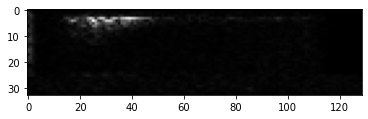

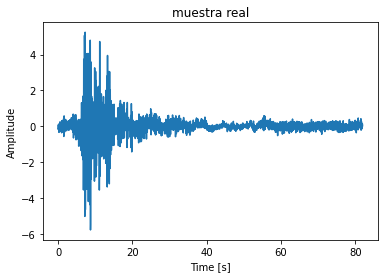

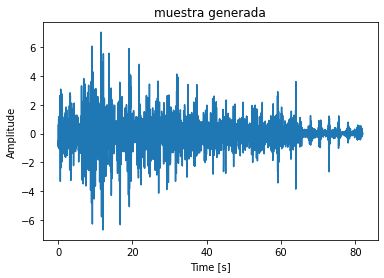

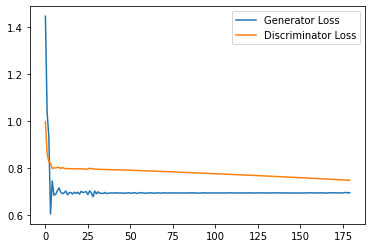

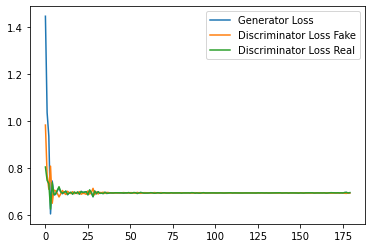

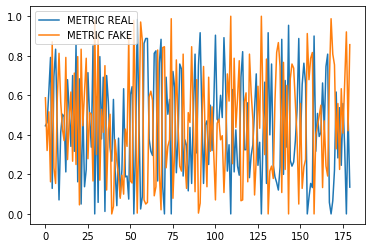

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3650: Generator loss: 0.6920035223166149, discriminator loss: 0.7465233969688415
Espectrogramas Generados


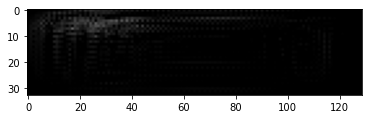

Espectrogramas Reales


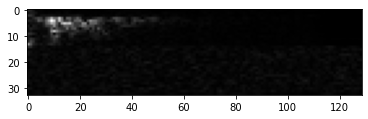

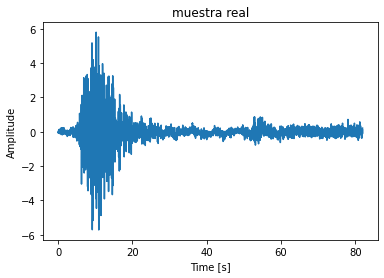

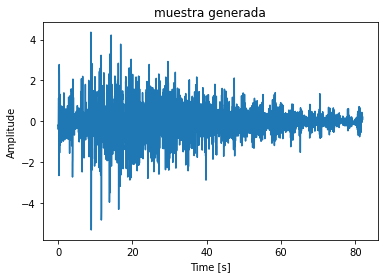

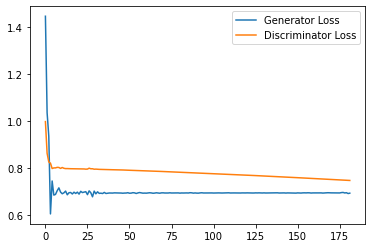

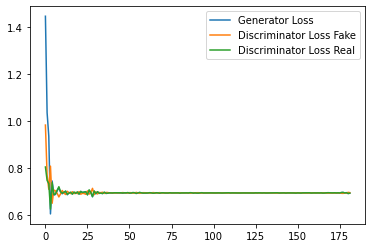

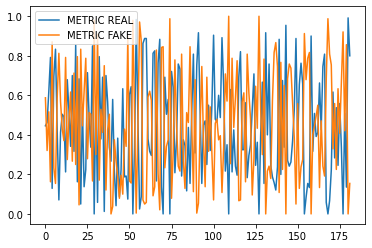

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3700: Generator loss: 0.6928605600198111, discriminator loss: 0.7455144464969635
Espectrogramas Generados


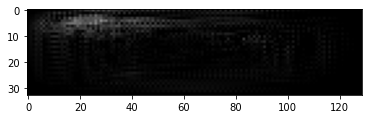

Espectrogramas Reales


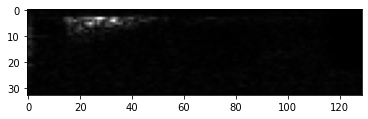

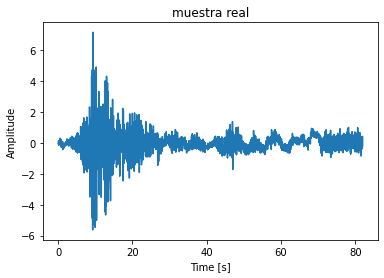

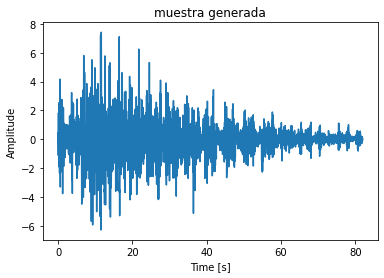

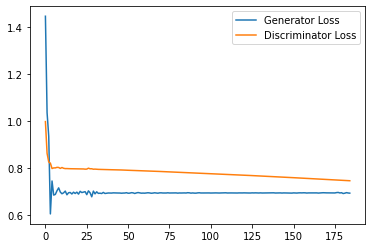

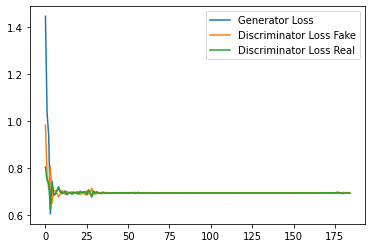

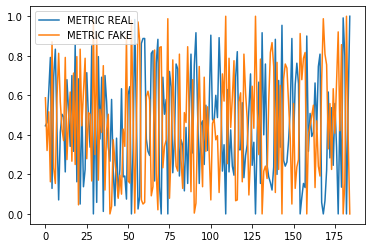

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3750: Generator loss: 0.6933130323886875, discriminator loss: 0.7444978296756745
Espectrogramas Generados


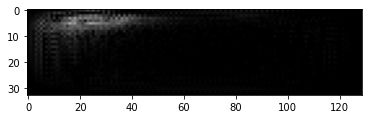

Espectrogramas Reales


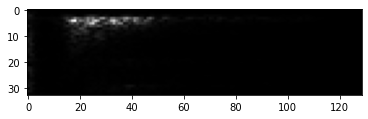

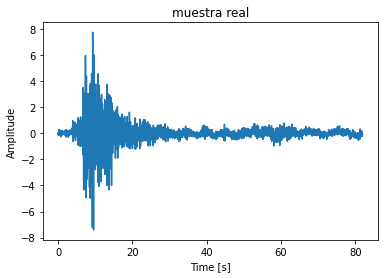

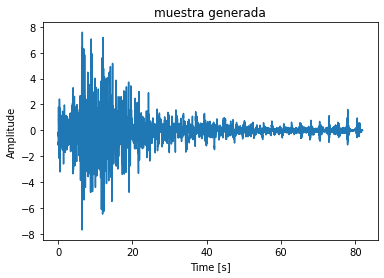

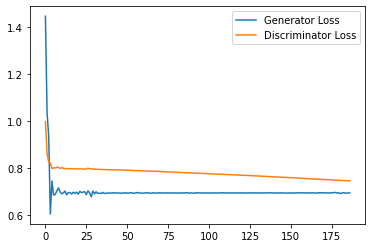

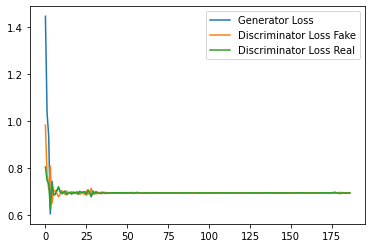

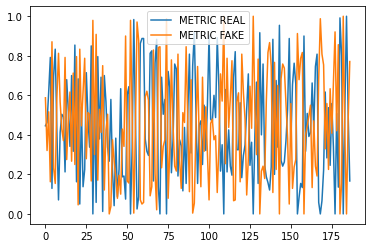

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3800: Generator loss: 0.692625863949458, discriminator loss: 0.7435083508491516
Espectrogramas Generados


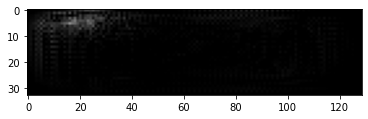

Espectrogramas Reales


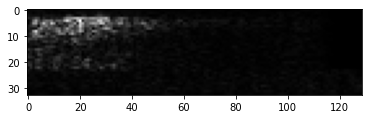

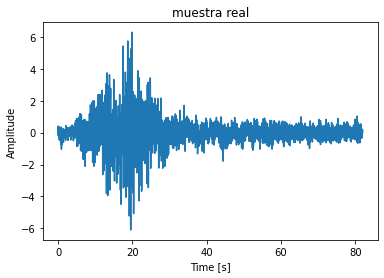

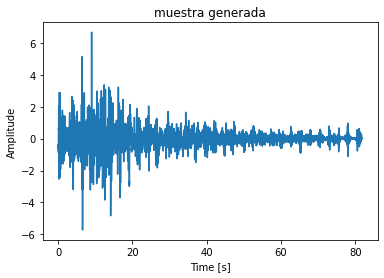

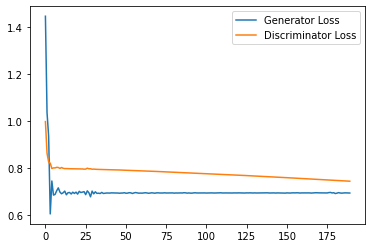

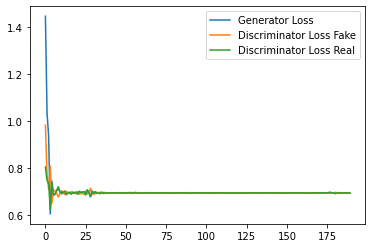

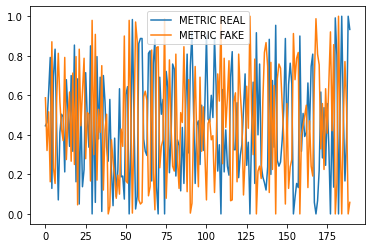

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3850: Generator loss: 0.6930374391873677, discriminator loss: 0.742513325214386
Espectrogramas Generados


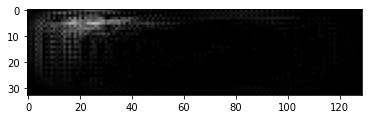

Espectrogramas Reales


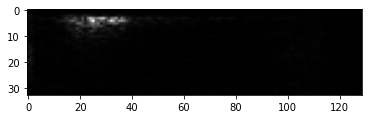

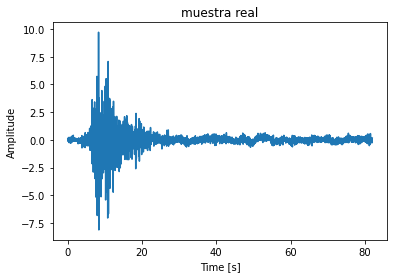

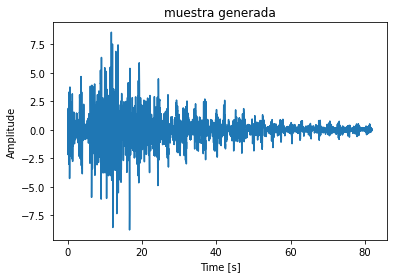

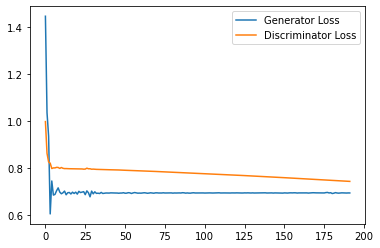

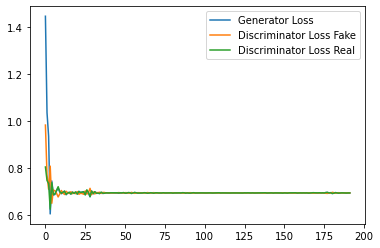

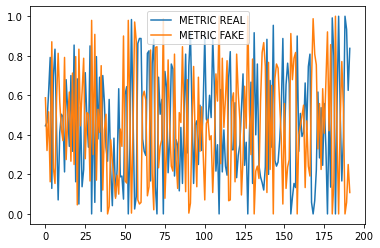

Step 3900: Generator loss: 0.6926908536752064, discriminator loss: 0.7415252196788787
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


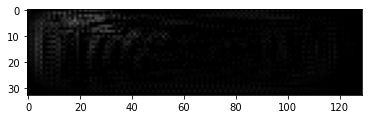

Espectrogramas Reales


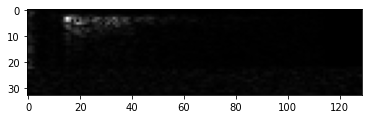

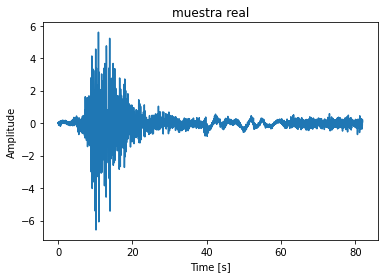

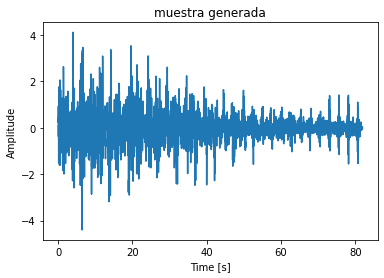

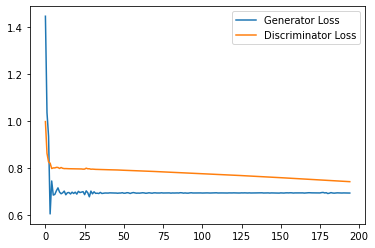

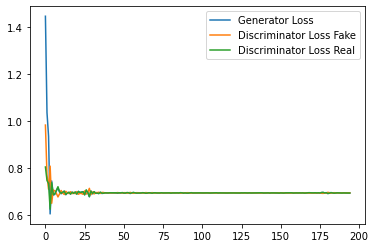

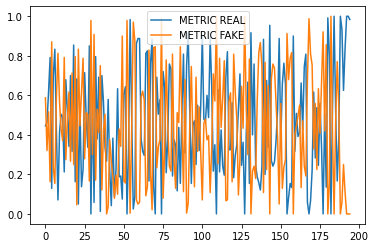

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 3950: Generator loss: 0.6930212835470836, discriminator loss: 0.7405305182933808
Espectrogramas Generados


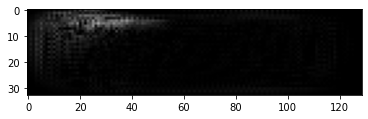

Espectrogramas Reales


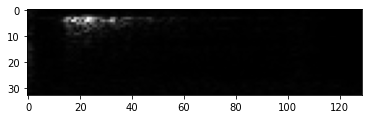

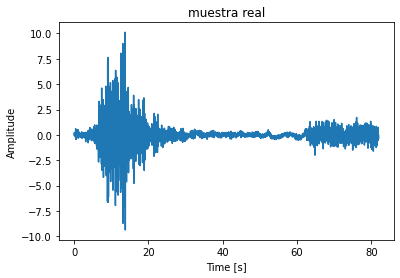

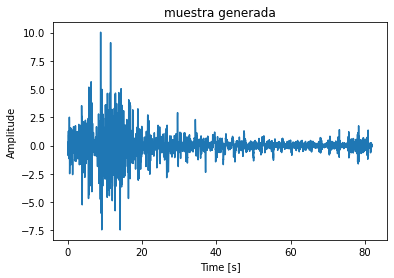

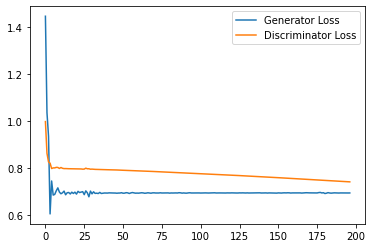

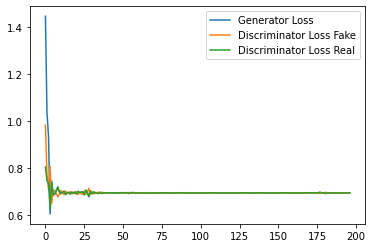

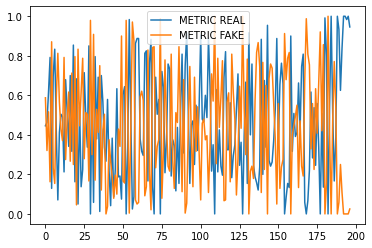

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4000: Generator loss: 0.6932453536987306, discriminator loss: 0.7395382714271546
Espectrogramas Generados


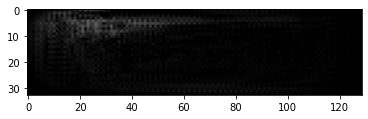

Espectrogramas Reales


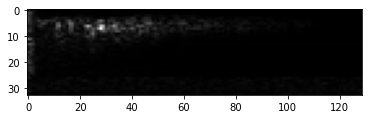

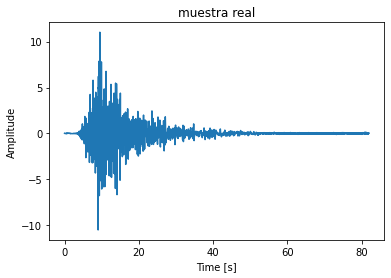

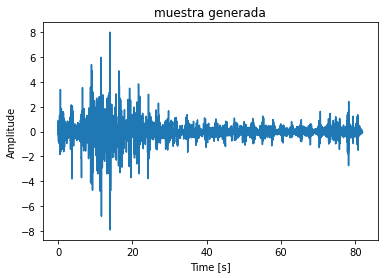

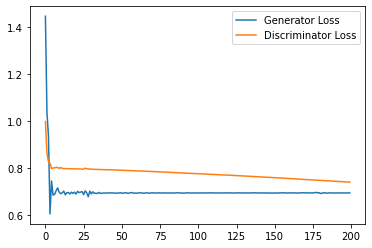

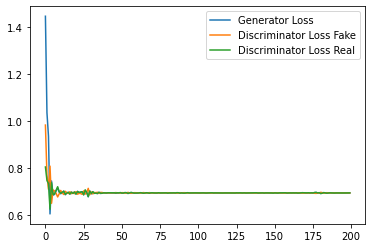

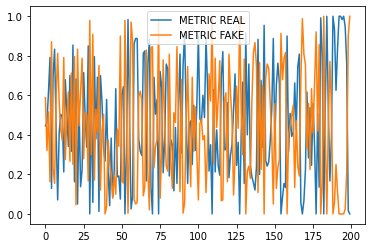

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4050: Generator loss: 0.6931414461135865, discriminator loss: 0.7385459351539612
Espectrogramas Generados


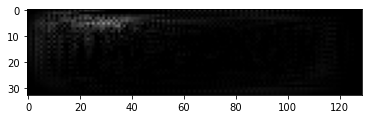

Espectrogramas Reales


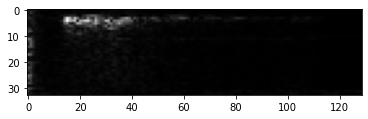

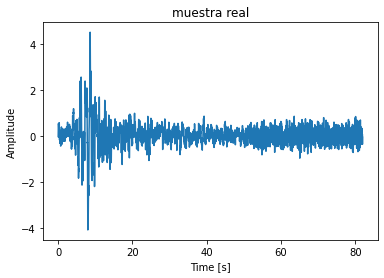

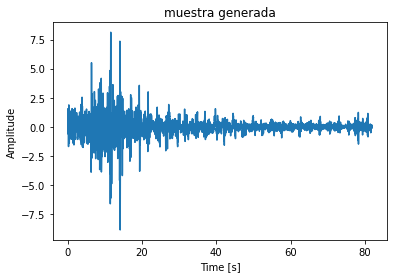

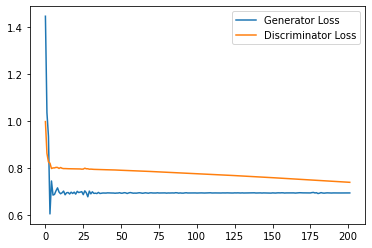

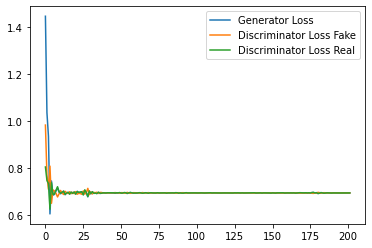

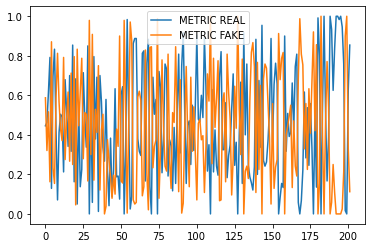

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4100: Generator loss: 0.6931362092494964, discriminator loss: 0.7375555872917176
Espectrogramas Generados


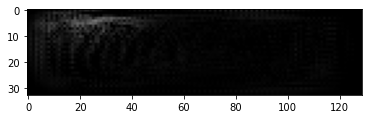

Espectrogramas Reales


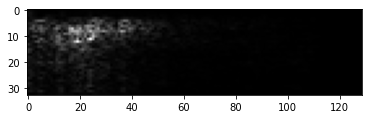

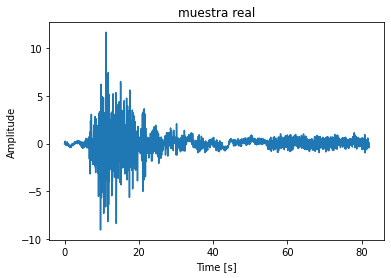

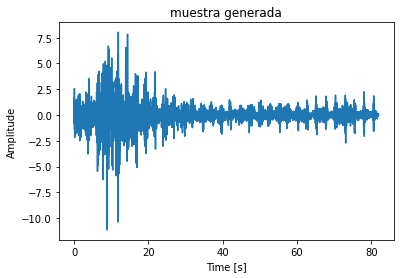

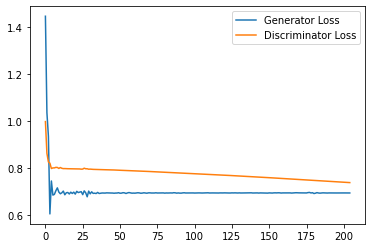

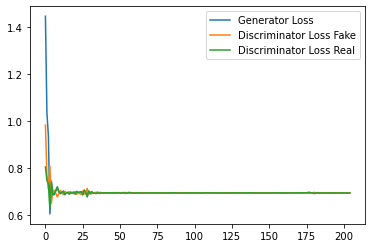

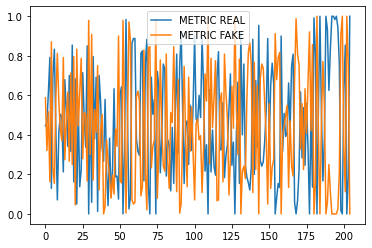

Epoch: 8


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4150: Generator loss: 0.6931048560142515, discriminator loss: 0.736562317609787
Espectrogramas Generados


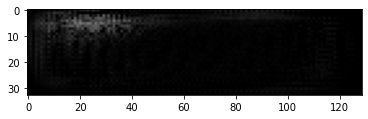

Espectrogramas Reales


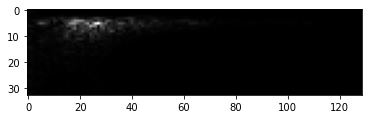

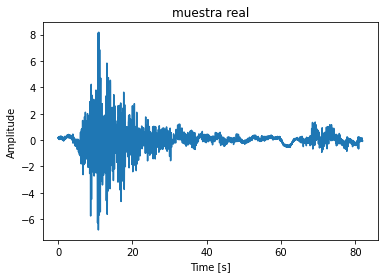

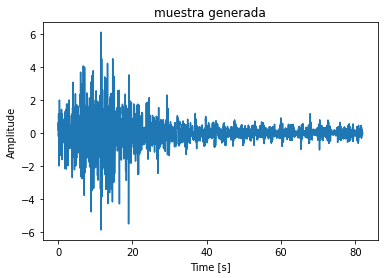

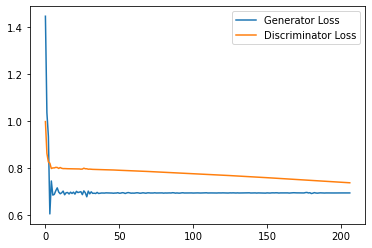

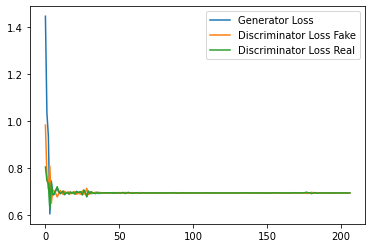

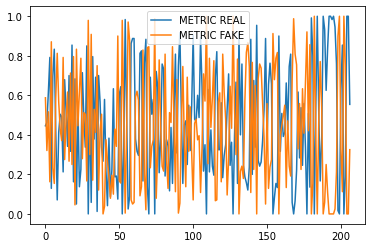

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4200: Generator loss: 0.693257172505061, discriminator loss: 0.7355711448192597
Espectrogramas Generados


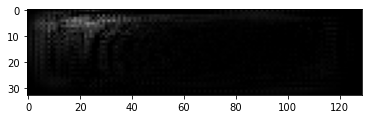

Espectrogramas Reales


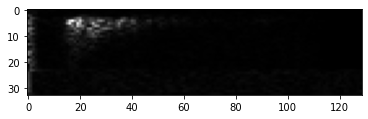

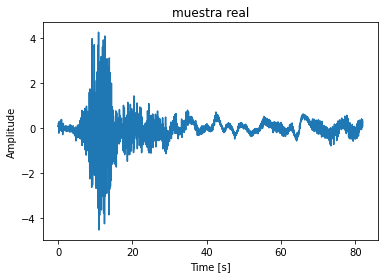

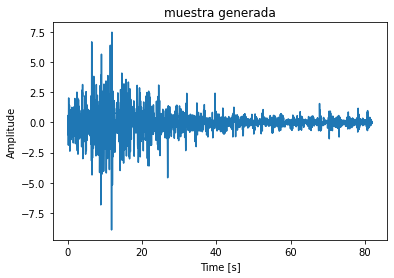

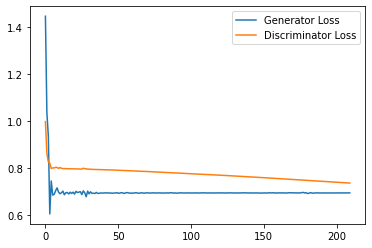

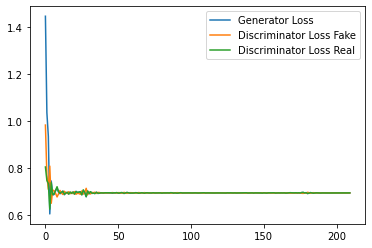

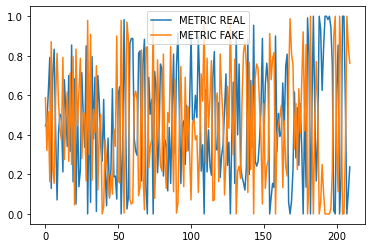

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4250: Generator loss: 0.6932063011328377, discriminator loss: 0.7345824575424195
Espectrogramas Generados


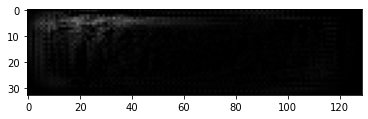

Espectrogramas Reales


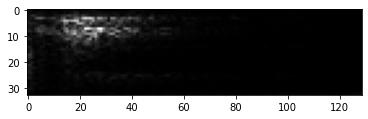

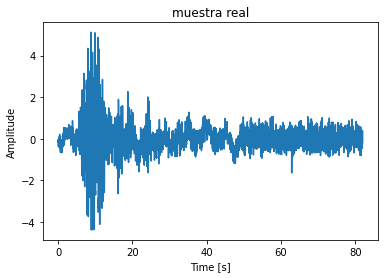

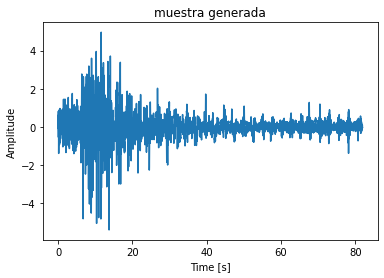

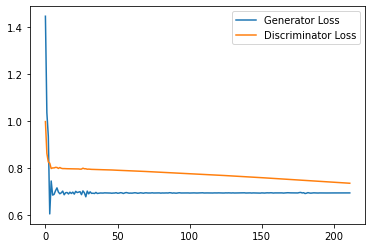

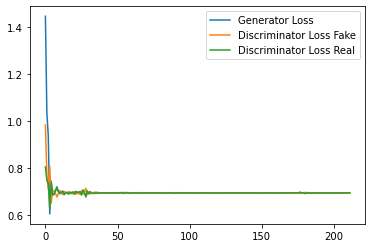

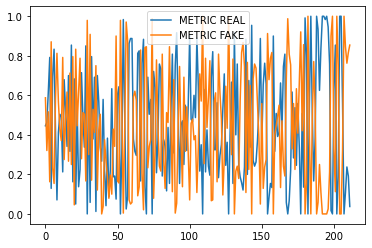

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4300: Generator loss: 0.6931776567300162, discriminator loss: 0.7335918366909027
Espectrogramas Generados


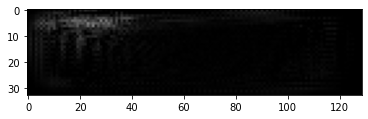

Espectrogramas Reales


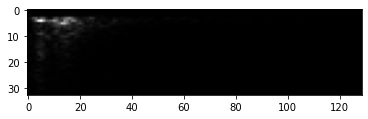

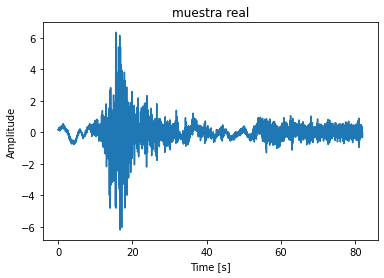

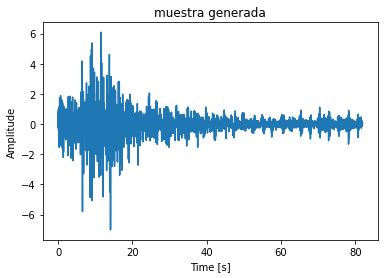

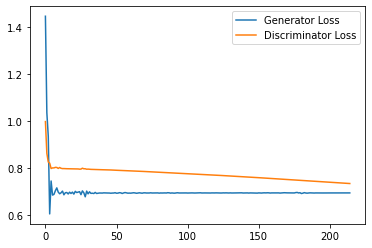

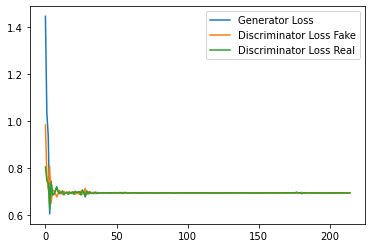

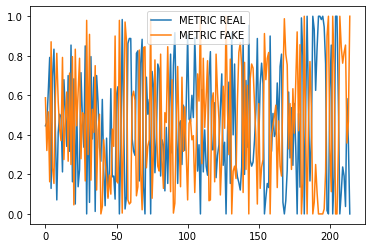

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4350: Generator loss: 0.6932381018002826, discriminator loss: 0.7326018476486206
Espectrogramas Generados


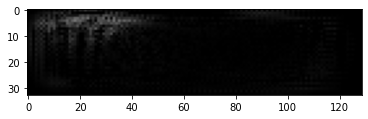

Espectrogramas Reales


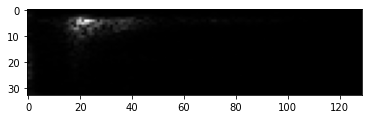

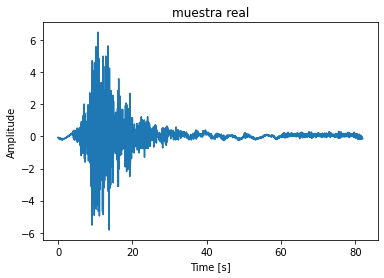

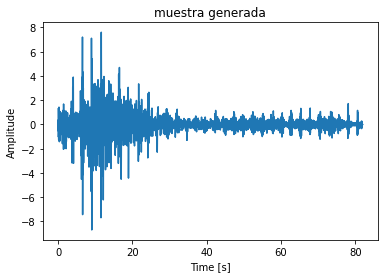

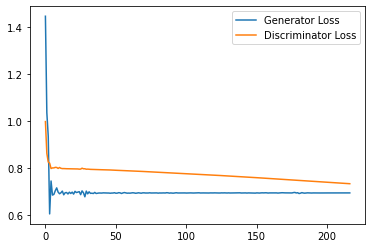

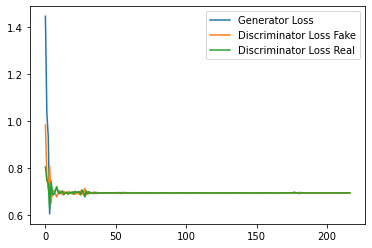

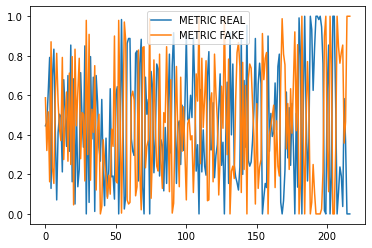

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4400: Generator loss: 0.6932077129681903, discriminator loss: 0.7316146862506866
Espectrogramas Generados


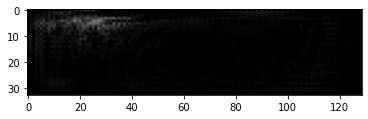

Espectrogramas Reales


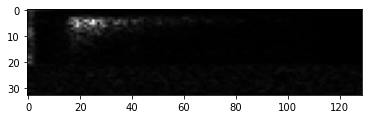

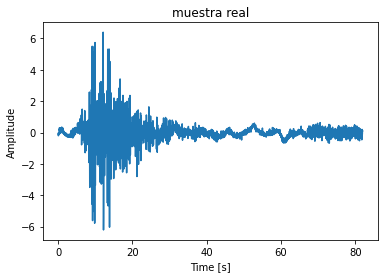

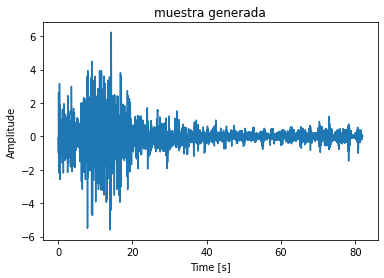

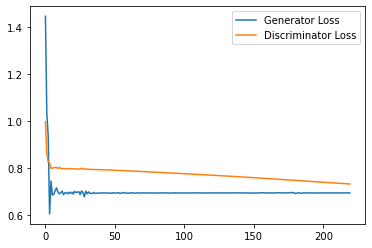

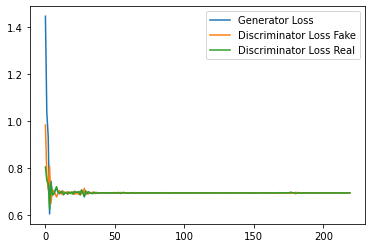

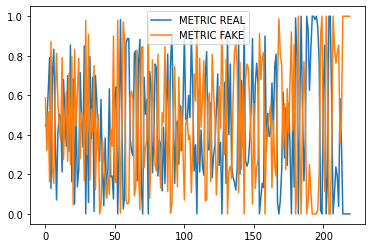

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4450: Generator loss: 0.69322736620903, discriminator loss: 0.7306288123130799
Espectrogramas Generados


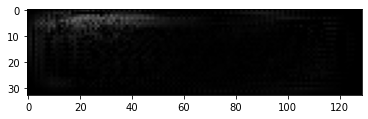

Espectrogramas Reales


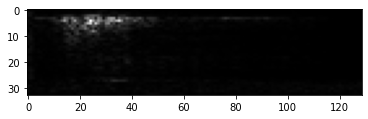

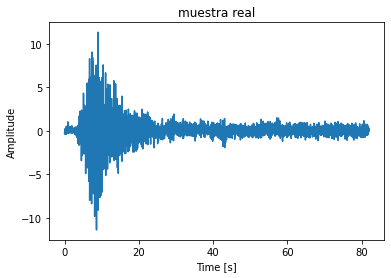

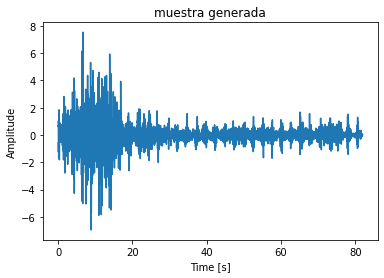

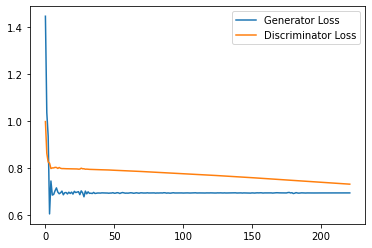

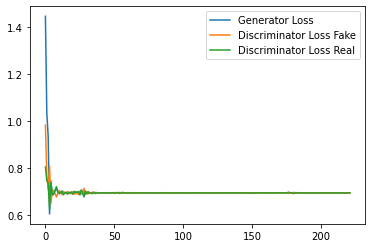

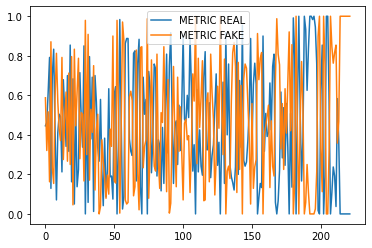

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4500: Generator loss: 0.6931957523028057, discriminator loss: 0.729643976688385
Espectrogramas Generados


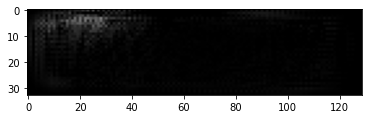

Espectrogramas Reales


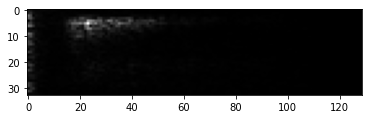

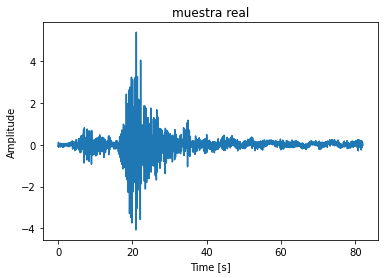

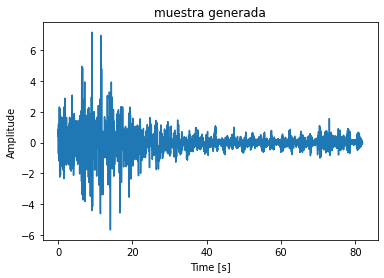

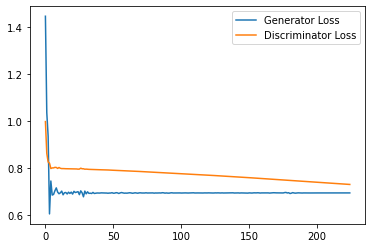

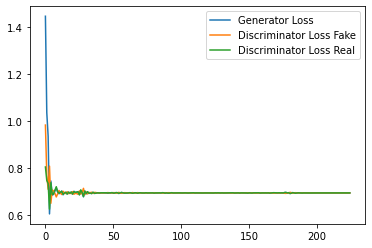

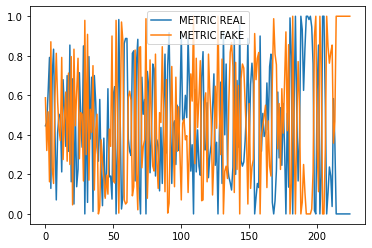

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4550: Generator loss: 0.6932087739308677, discriminator loss: 0.728663125038147
Espectrogramas Generados


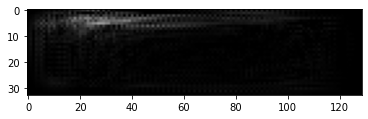

Espectrogramas Reales


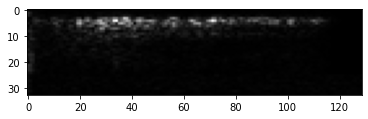

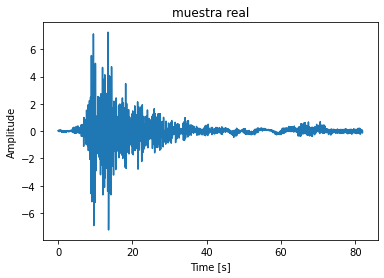

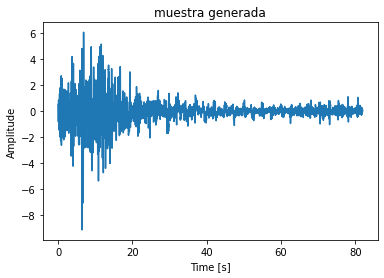

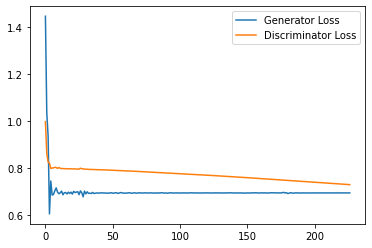

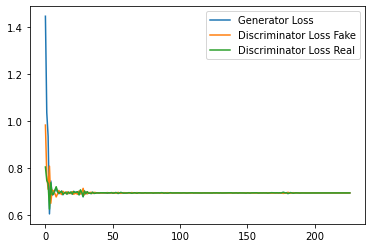

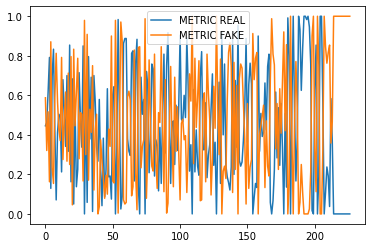

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4600: Generator loss: 0.6932352785269417, discriminator loss: 0.7276854693889618
Espectrogramas Generados


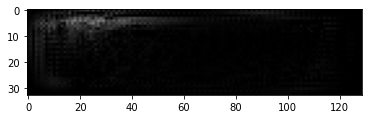

Espectrogramas Reales


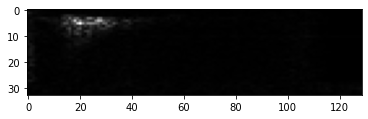

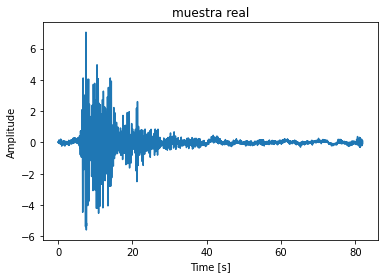

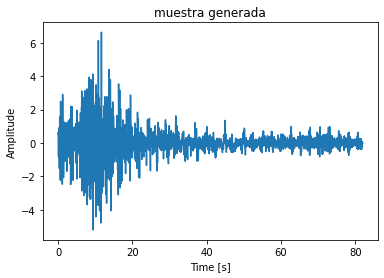

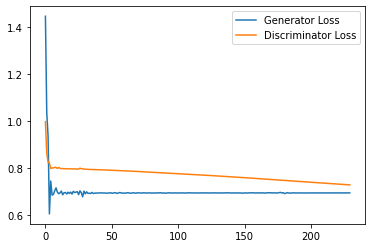

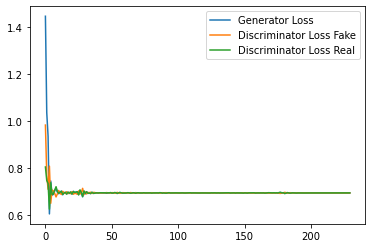

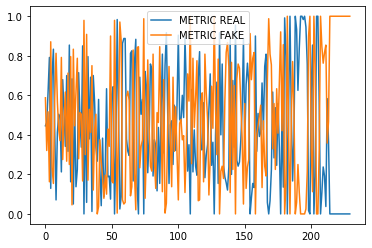

Epoch: 9


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4650: Generator loss: 0.6932530736923218, discriminator loss: 0.7267133796215057
Espectrogramas Generados


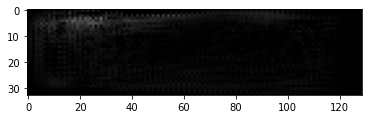

Espectrogramas Reales


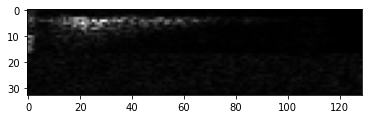

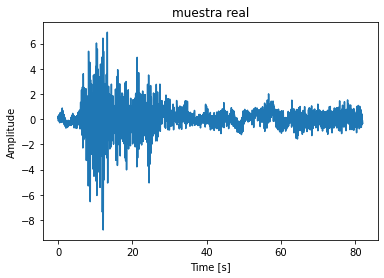

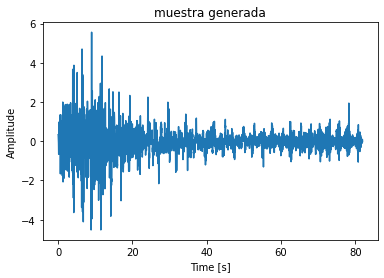

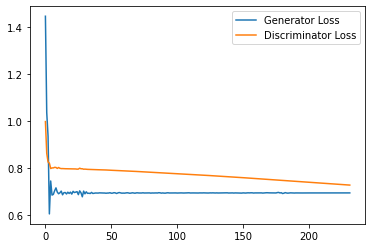

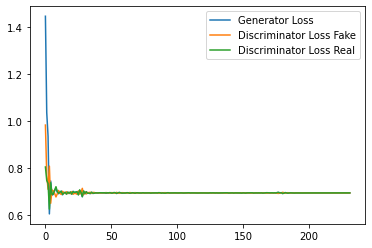

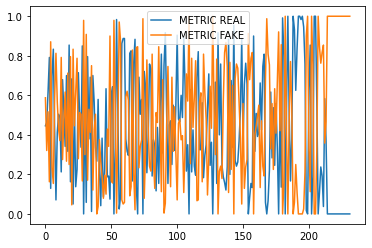

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4700: Generator loss: 0.693187303940455, discriminator loss: 0.7257443428039551
Espectrogramas Generados


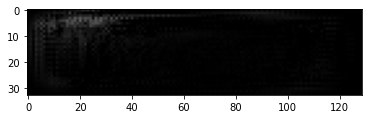

Espectrogramas Reales


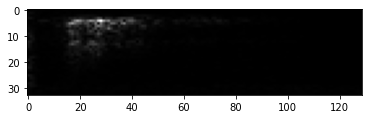

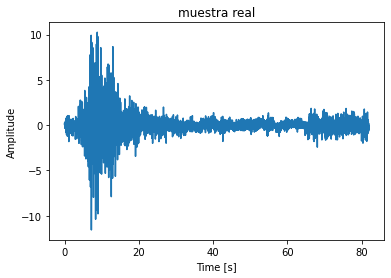

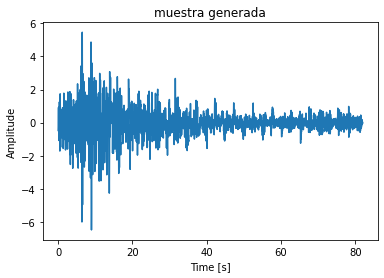

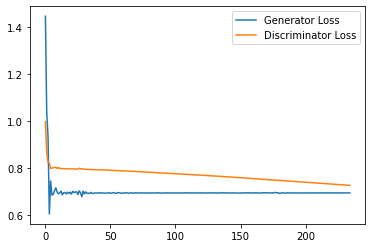

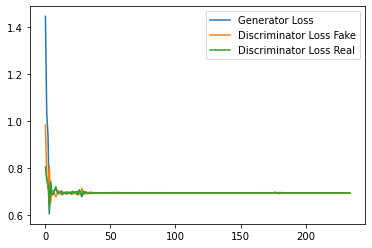

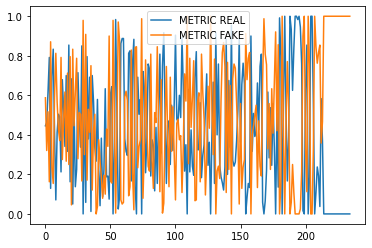

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4750: Generator loss: 0.6932162714004515, discriminator loss: 0.7247827911376953
Espectrogramas Generados


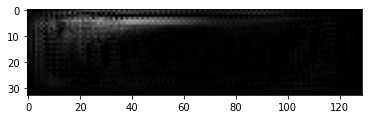

Espectrogramas Reales


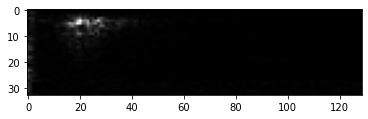

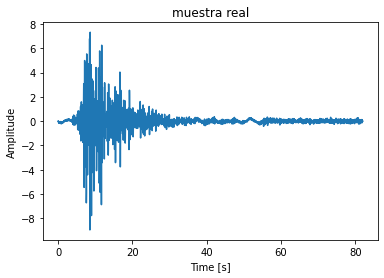

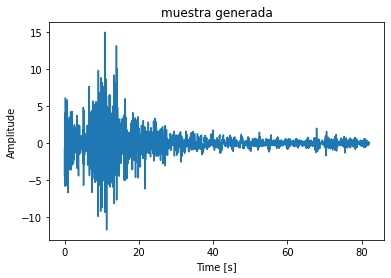

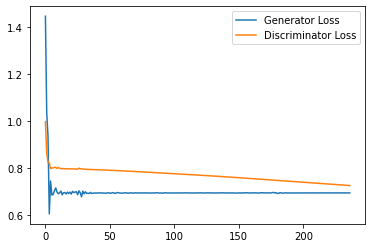

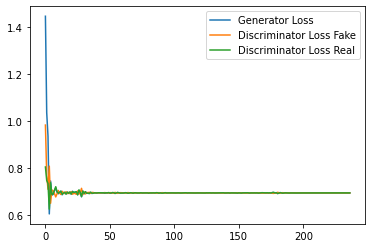

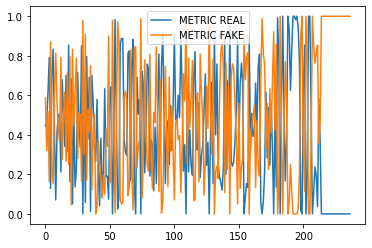

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4800: Generator loss: 0.6932064119974772, discriminator loss: 0.7238288867473602
Espectrogramas Generados


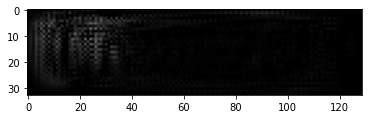

Espectrogramas Reales


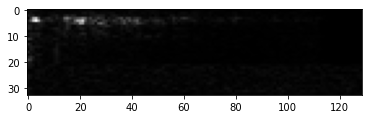

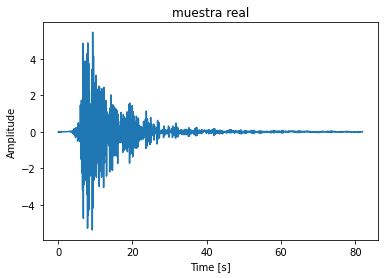

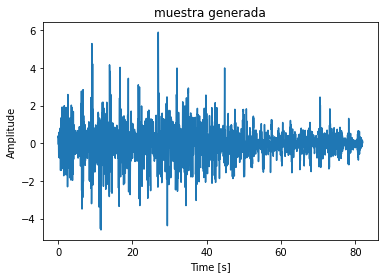

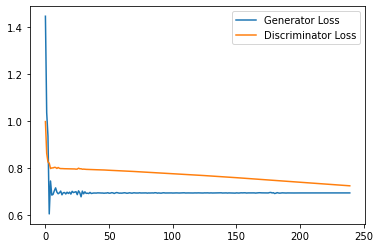

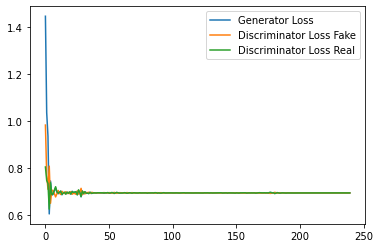

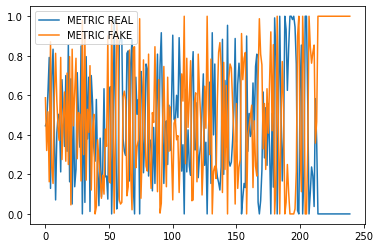

Step 4850: Generator loss: 0.6931340142091116, discriminator loss: 0.7228815257549286
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


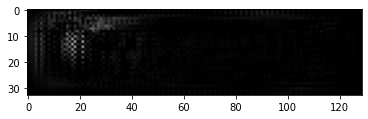

Espectrogramas Reales


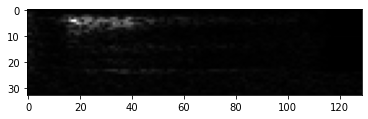

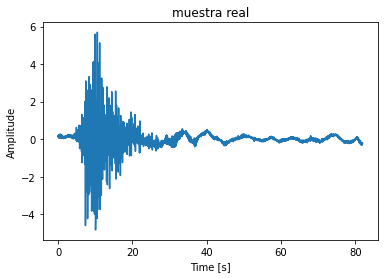

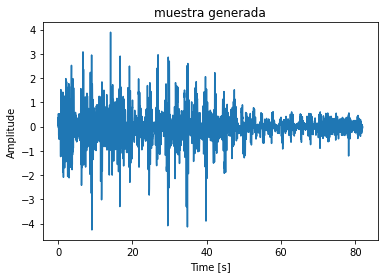

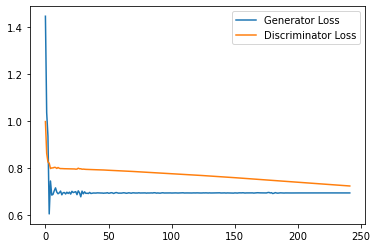

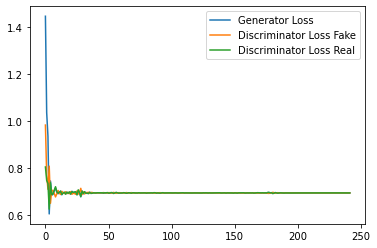

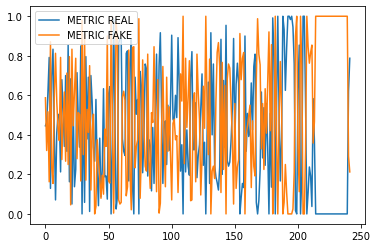

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4900: Generator loss: 0.6931329409281412, discriminator loss: 0.7219331216812134
Espectrogramas Generados


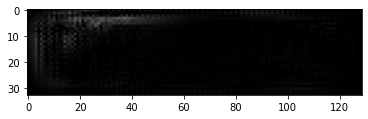

Espectrogramas Reales


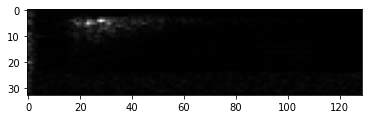

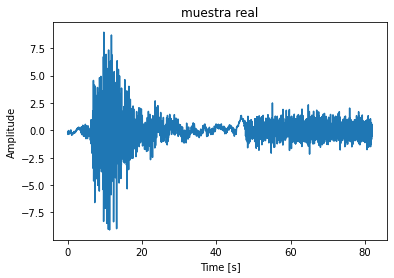

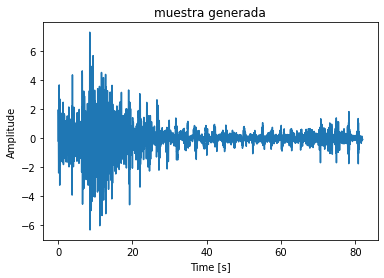

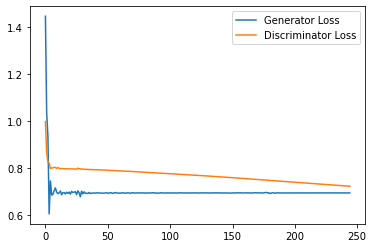

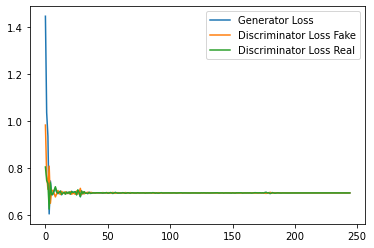

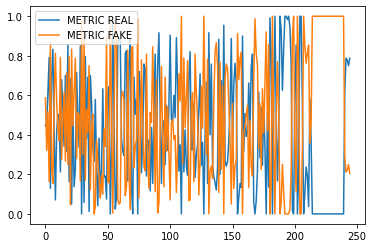

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 4950: Generator loss: 0.6931729622681935, discriminator loss: 0.7209956860542297
Espectrogramas Generados


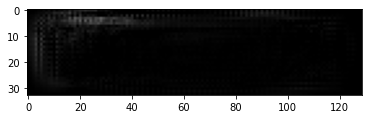

Espectrogramas Reales


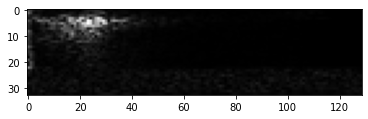

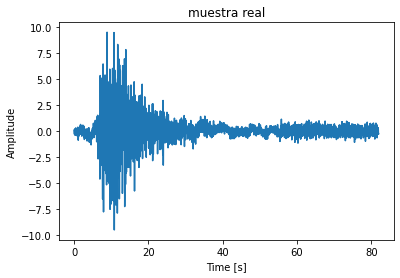

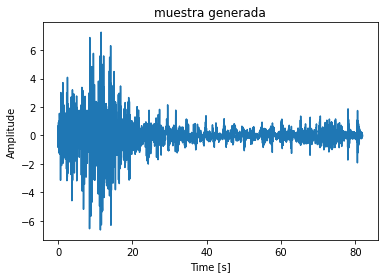

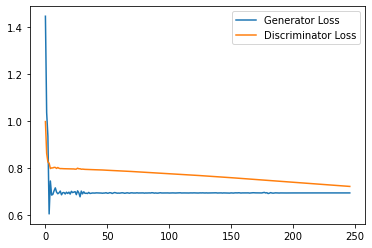

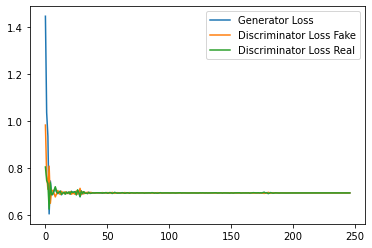

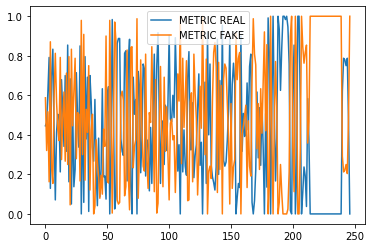

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5000: Generator loss: 0.6932047828038533, discriminator loss: 0.7200692665576934
Espectrogramas Generados


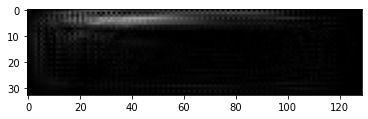

Espectrogramas Reales


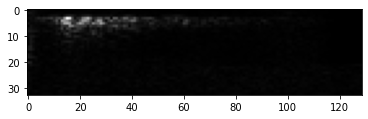

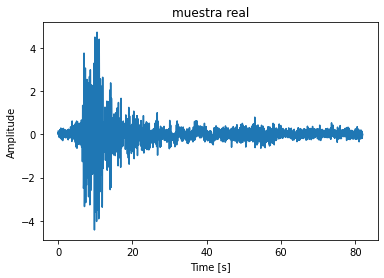

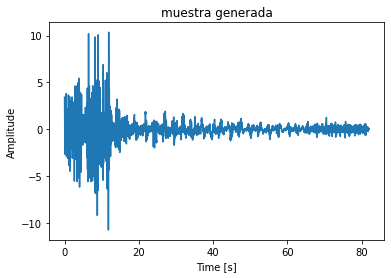

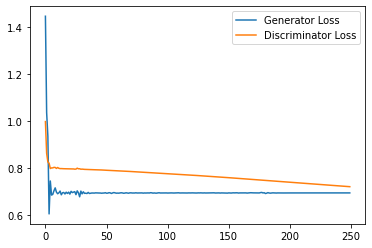

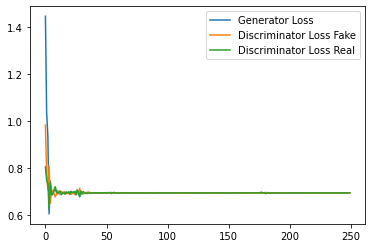

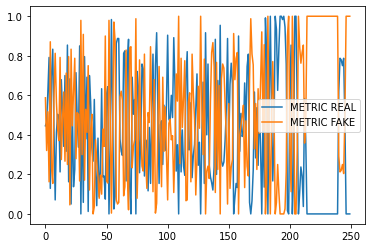

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5050: Generator loss: 0.6932182240486146, discriminator loss: 0.7191555070877075
Espectrogramas Generados


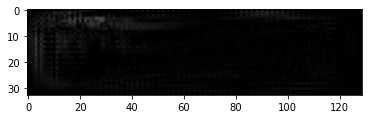

Espectrogramas Reales


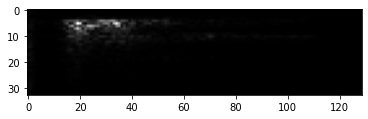

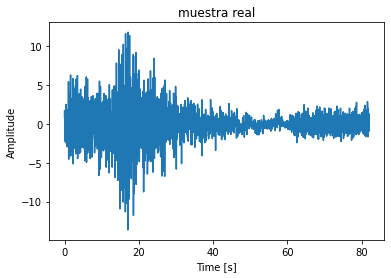

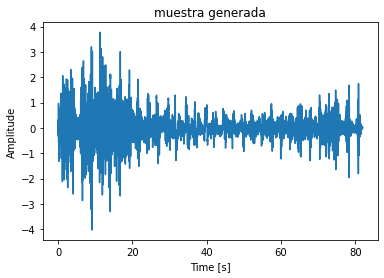

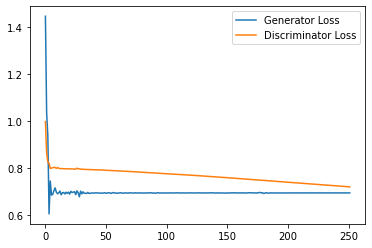

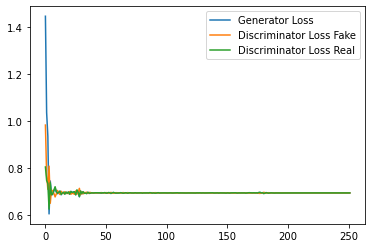

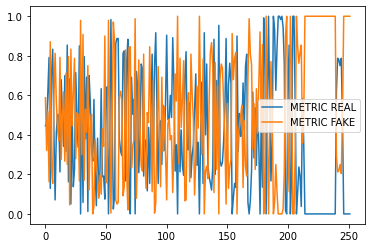

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5100: Generator loss: 0.6931787300109861, discriminator loss: 0.7182559514045715
Espectrogramas Generados


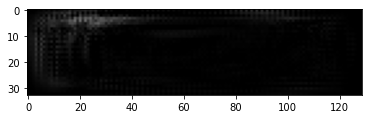

Espectrogramas Reales


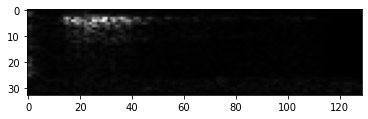

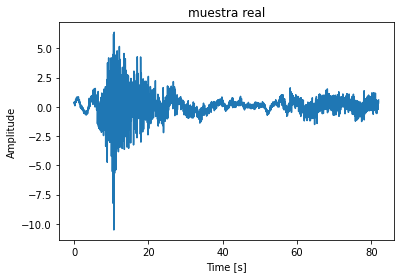

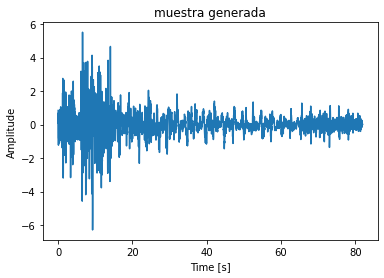

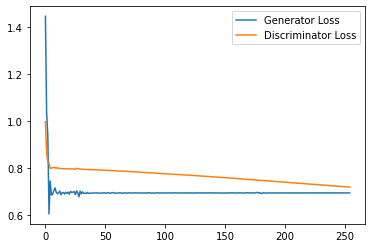

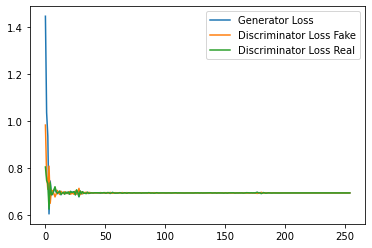

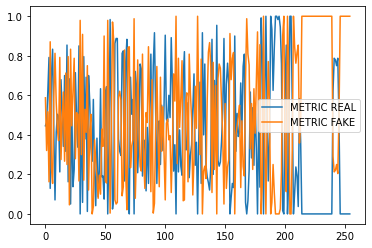

Epoch: 10


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5150: Generator loss: 0.6931945323944093, discriminator loss: 0.717372944355011
Espectrogramas Generados


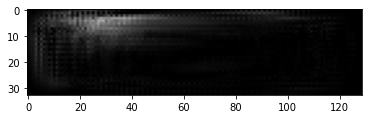

Espectrogramas Reales


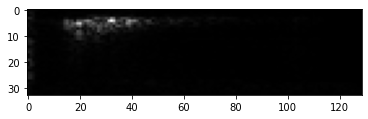

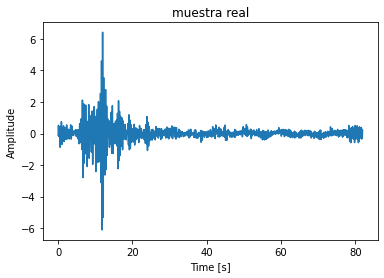

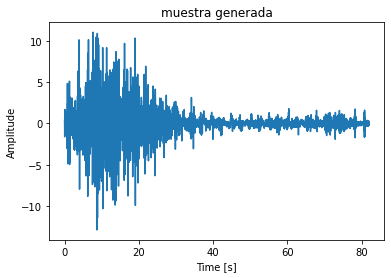

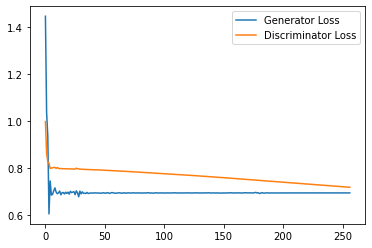

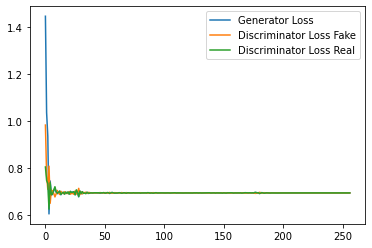

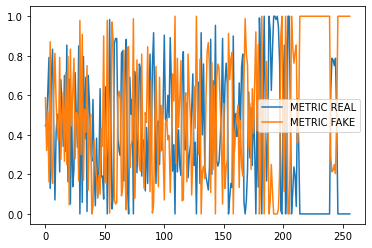

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5200: Generator loss: 0.6931685304641724, discriminator loss: 0.7165105032920838
Espectrogramas Generados


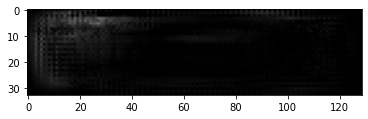

Espectrogramas Reales


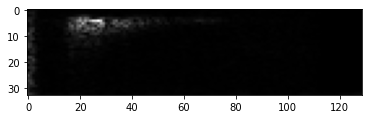

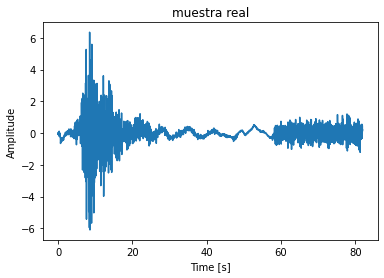

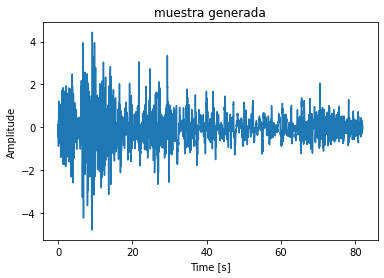

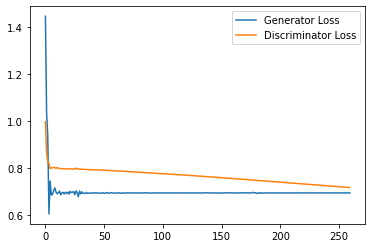

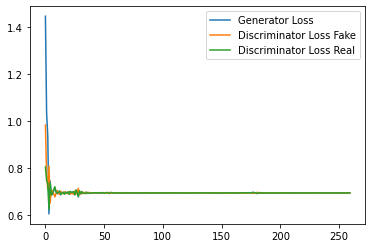

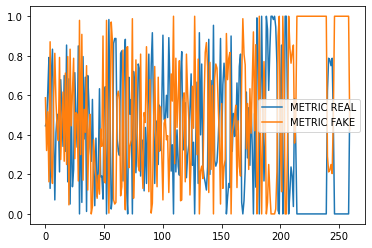

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5250: Generator loss: 0.6931829245885216, discriminator loss: 0.7156731534004211
Espectrogramas Generados


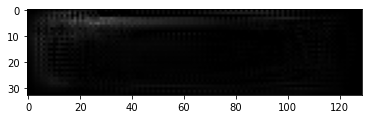

Espectrogramas Reales


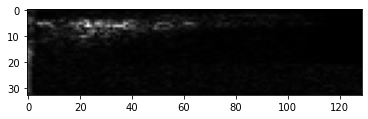

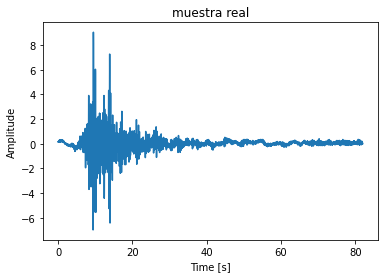

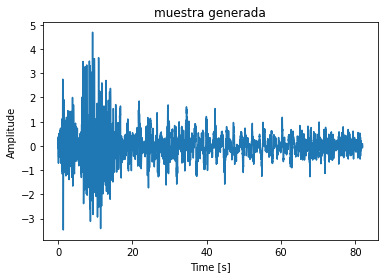

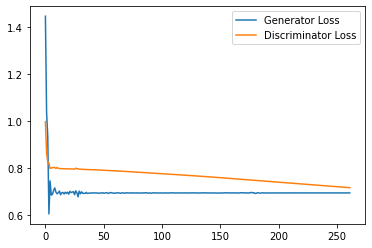

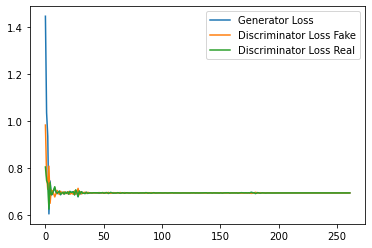

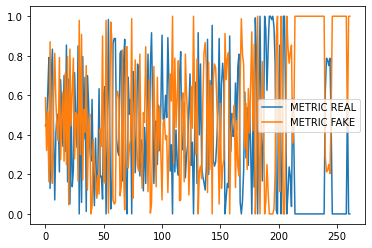

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5300: Generator loss: 0.693147017558416, discriminator loss: 0.714873629808426
Espectrogramas Generados


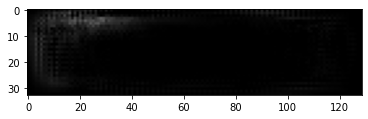

Espectrogramas Reales


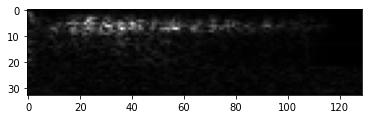

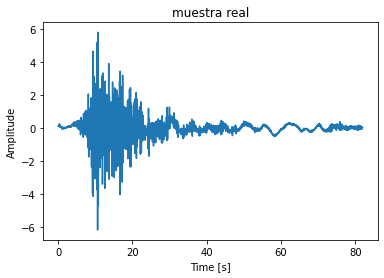

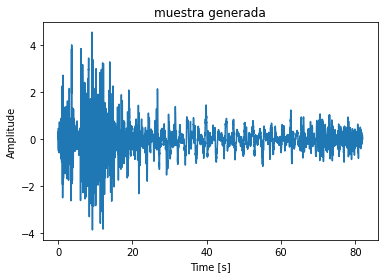

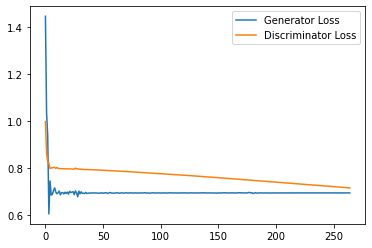

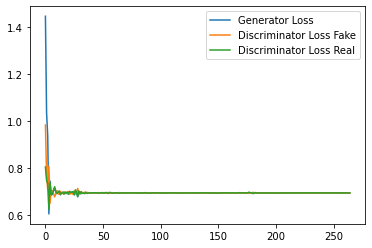

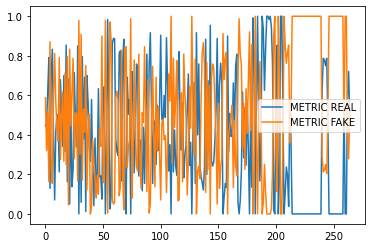

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5350: Generator loss: 0.6931678342819214, discriminator loss: 0.7141864049434662
Espectrogramas Generados


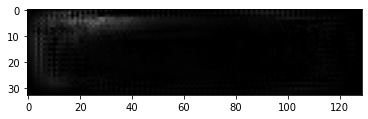

Espectrogramas Reales


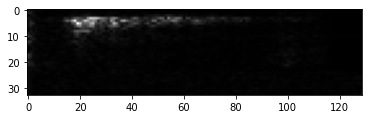

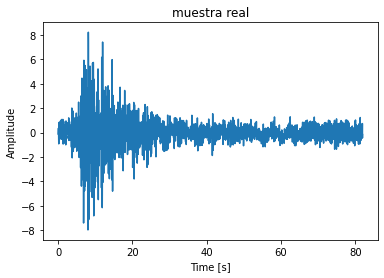

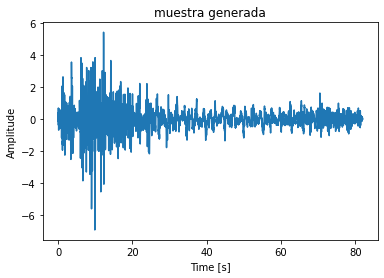

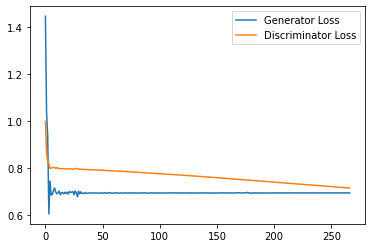

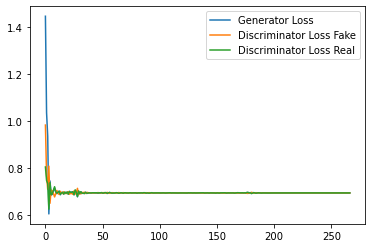

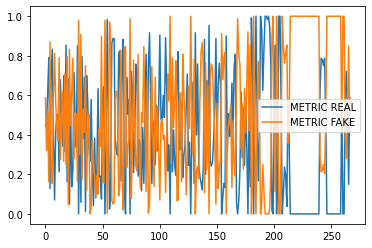

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5400: Generator loss: 0.6931424895922343, discriminator loss: 0.7136638677120208
Espectrogramas Generados


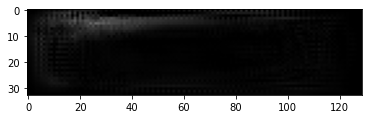

Espectrogramas Reales


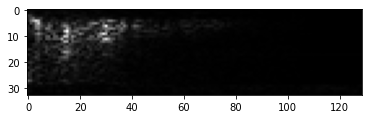

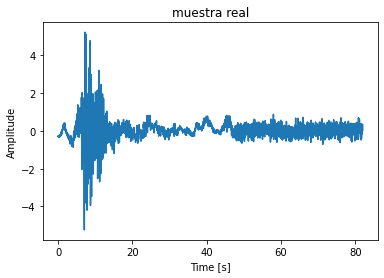

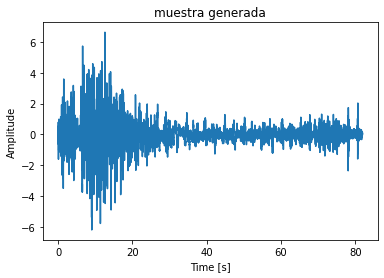

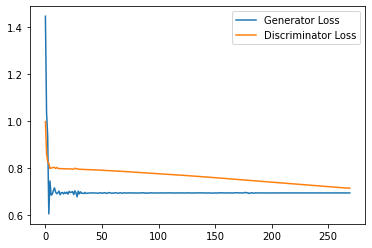

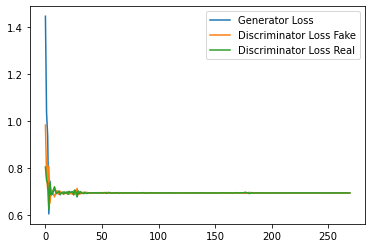

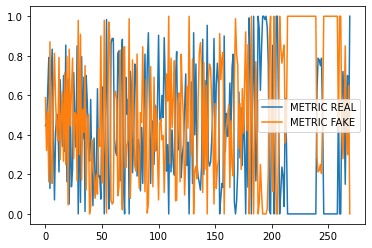

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5450: Generator loss: 0.6931492972373963, discriminator loss: 0.7131497514247894
Espectrogramas Generados


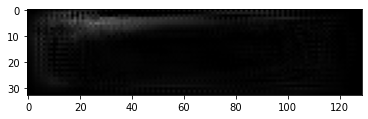

Espectrogramas Reales


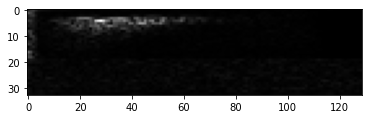

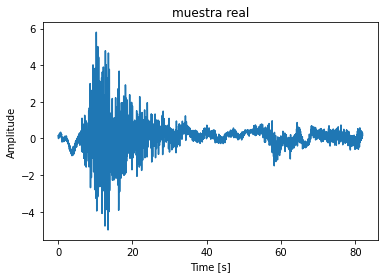

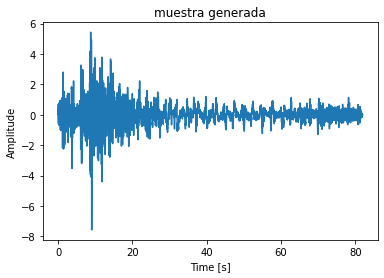

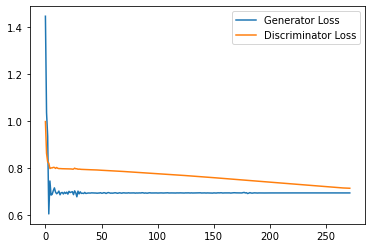

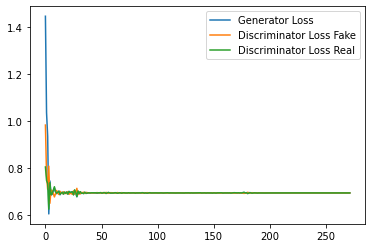

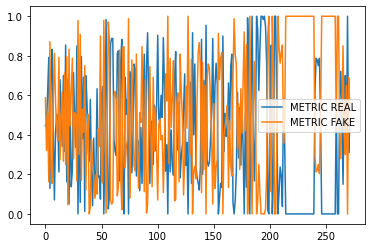

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5500: Generator loss: 0.6931224433581034, discriminator loss: 0.7126368355751037
Espectrogramas Generados


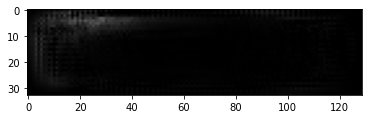

Espectrogramas Reales


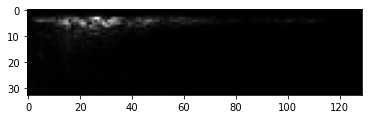

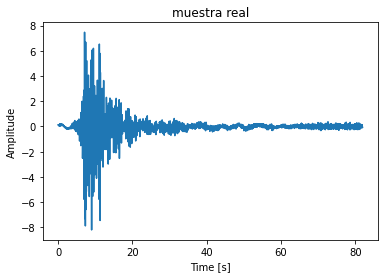

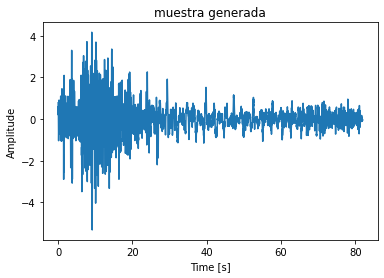

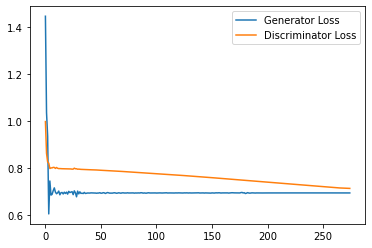

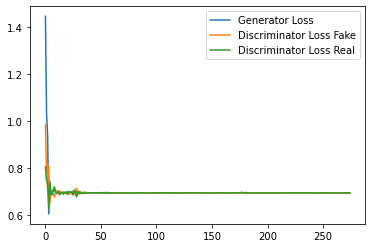

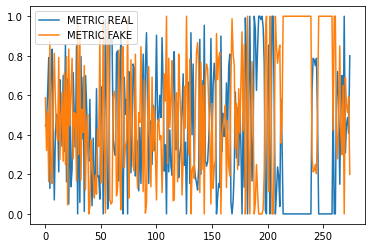

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5550: Generator loss: 0.6931037290891012, discriminator loss: 0.7121261310577393
Espectrogramas Generados


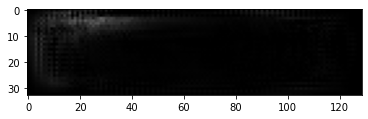

Espectrogramas Reales


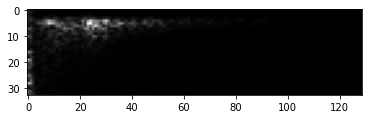

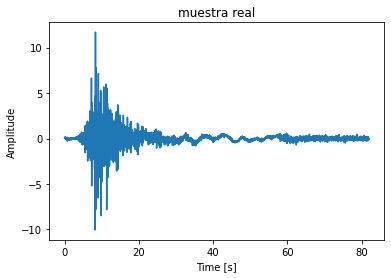

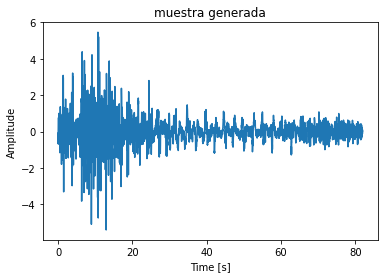

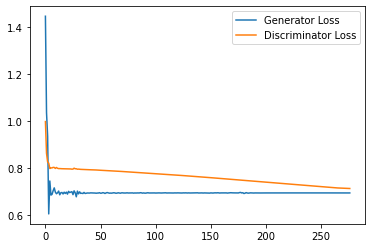

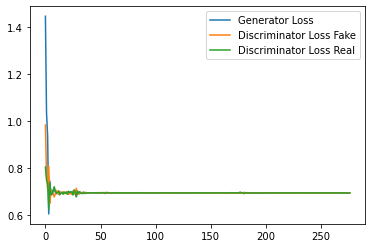

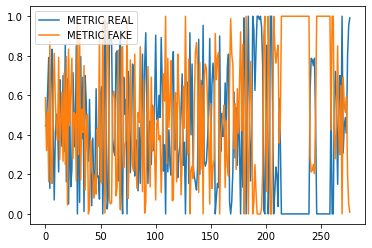

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5600: Generator loss: 0.693132440249125, discriminator loss: 0.7116148245334625
Espectrogramas Generados


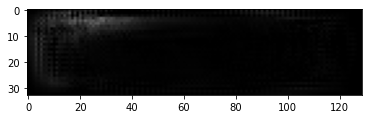

Espectrogramas Reales


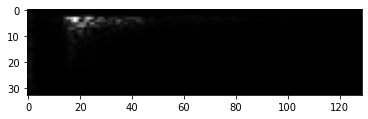

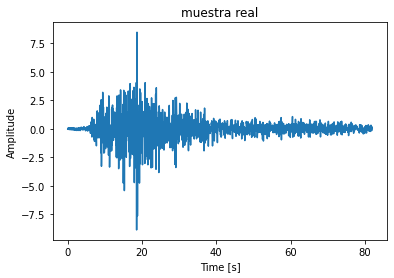

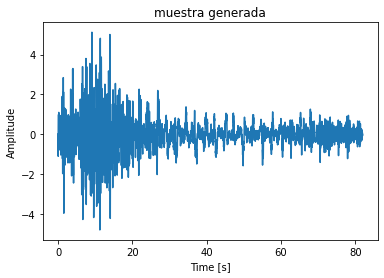

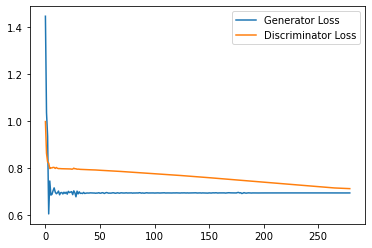

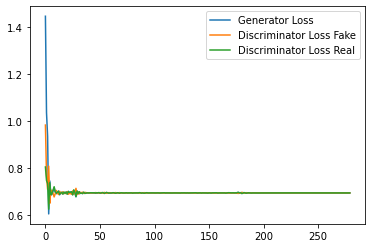

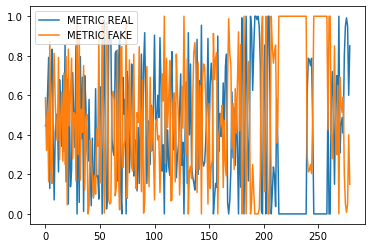

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5650: Generator loss: 0.693144154548645, discriminator loss: 0.7111048483848572
Espectrogramas Generados


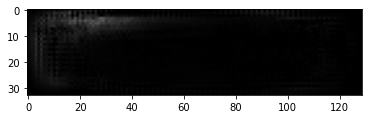

Espectrogramas Reales


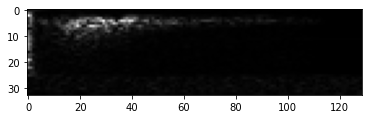

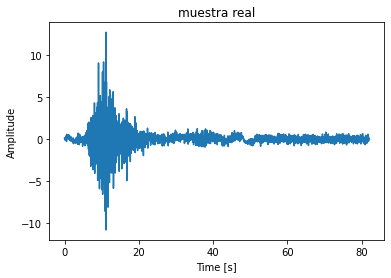

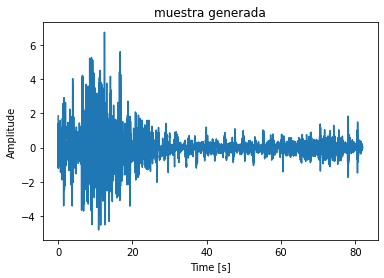

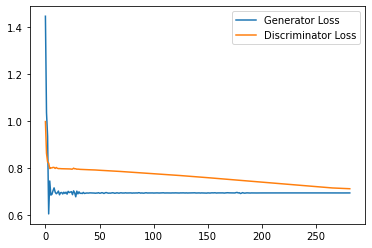

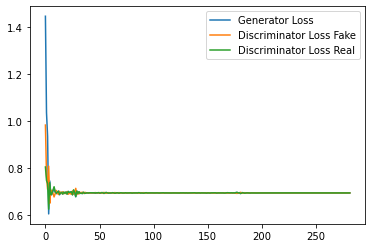

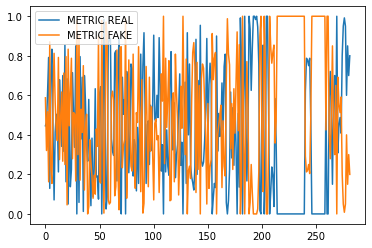

Epoch: 11


  0%|          | 0/514 [00:00<?, ?it/s]

Step 5700: Generator loss: 0.6931452703475952, discriminator loss: 0.7105961954593658
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


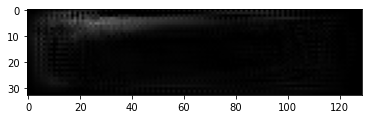

Espectrogramas Reales


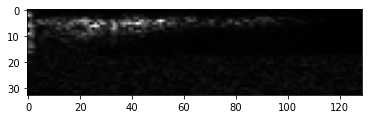

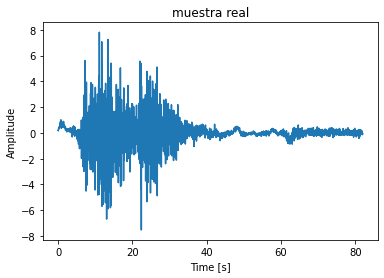

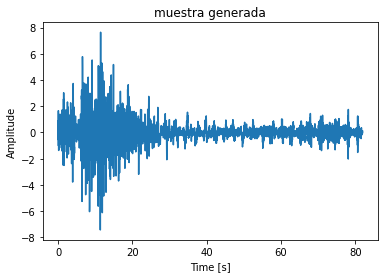

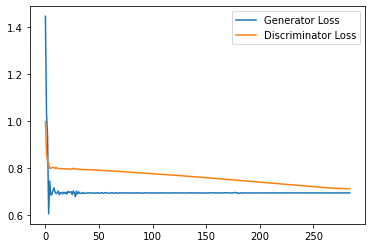

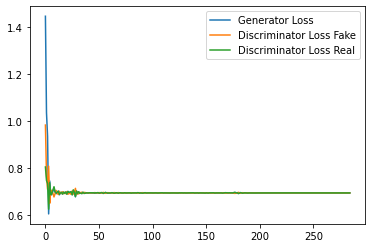

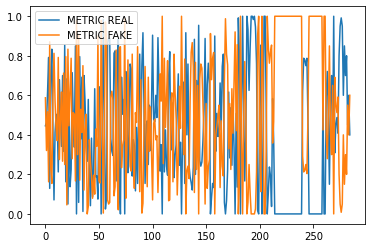

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5750: Generator loss: 0.6931442999839783, discriminator loss: 0.7100881695747375
Espectrogramas Generados


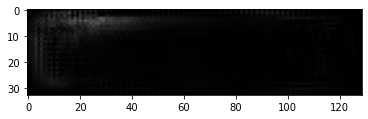

Espectrogramas Reales


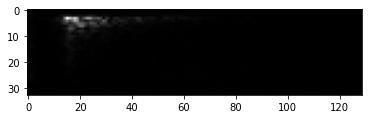

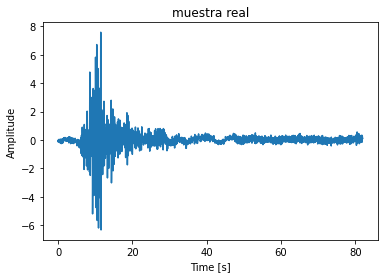

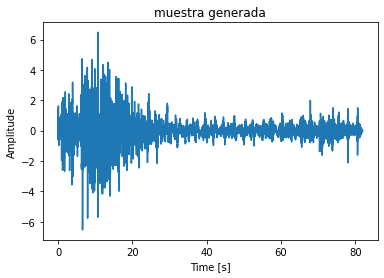

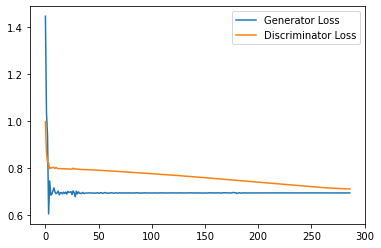

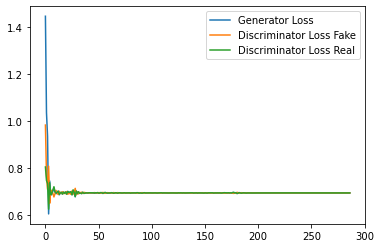

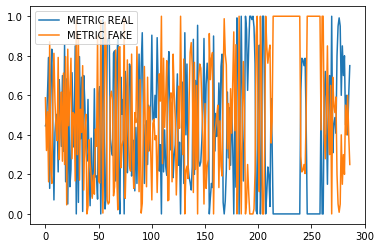

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5800: Generator loss: 0.6931409299373626, discriminator loss: 0.7095835196971894
Espectrogramas Generados


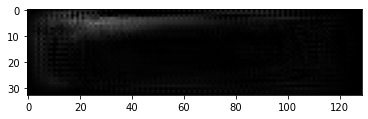

Espectrogramas Reales


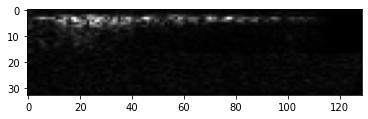

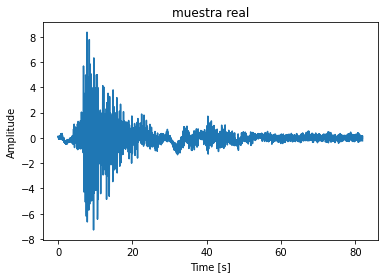

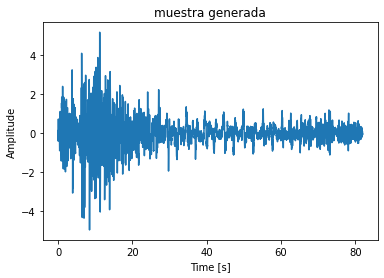

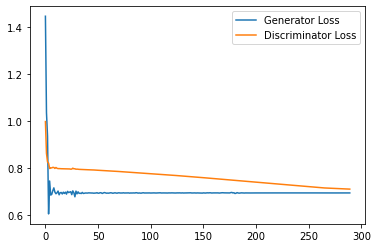

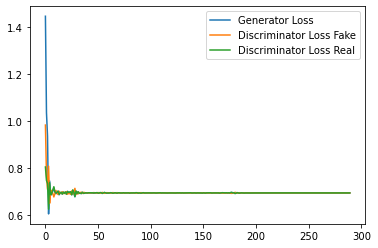

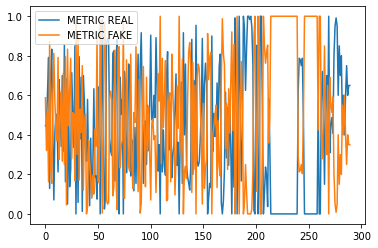

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5850: Generator loss: 0.6931453788280487, discriminator loss: 0.7090760624408722
Espectrogramas Generados


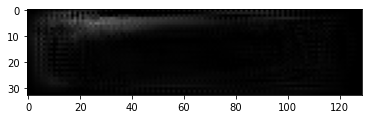

Espectrogramas Reales


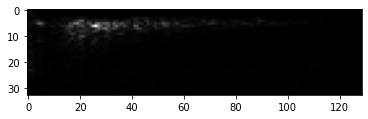

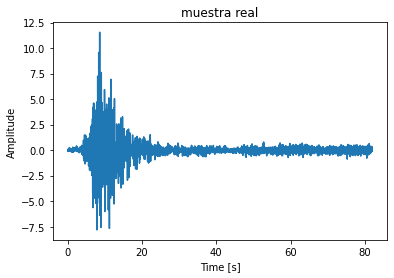

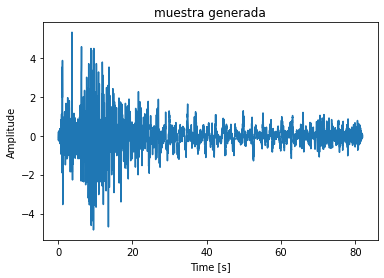

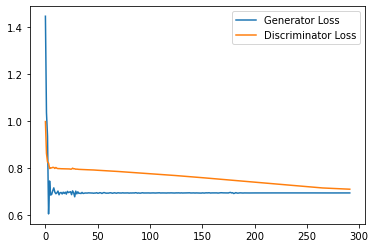

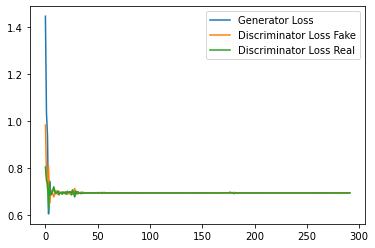

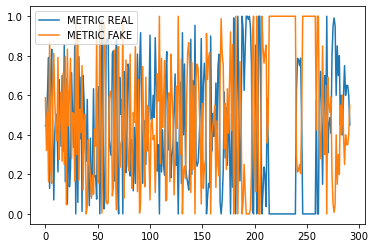

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5900: Generator loss: 0.6931469476222992, discriminator loss: 0.7085729813575745
Espectrogramas Generados


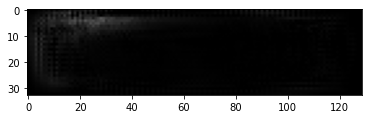

Espectrogramas Reales


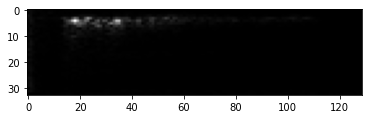

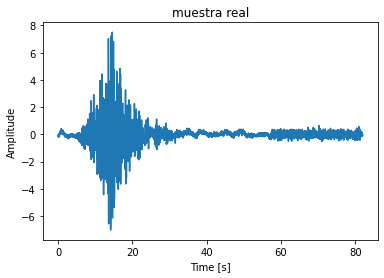

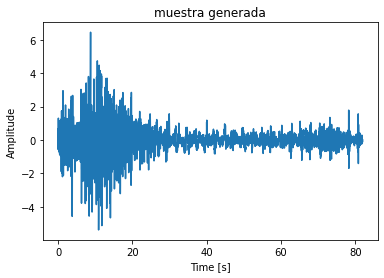

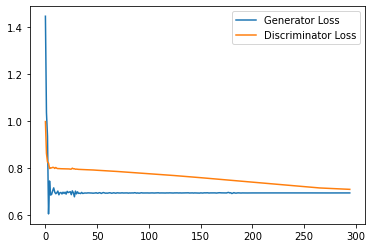

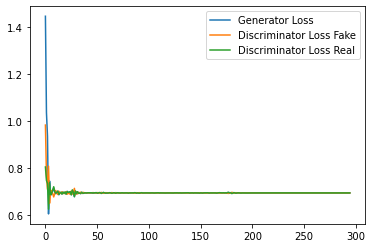

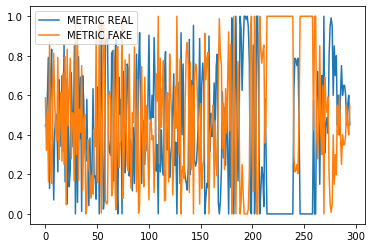

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 5950: Generator loss: 0.6931478464603424, discriminator loss: 0.7080717968940735
Espectrogramas Generados


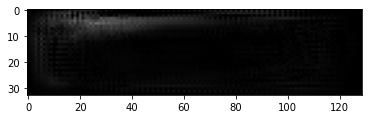

Espectrogramas Reales


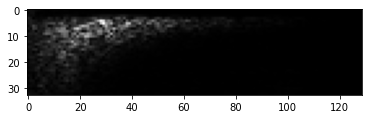

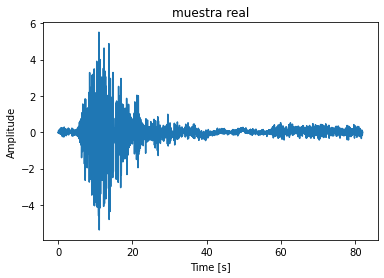

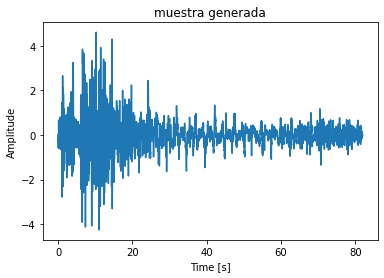

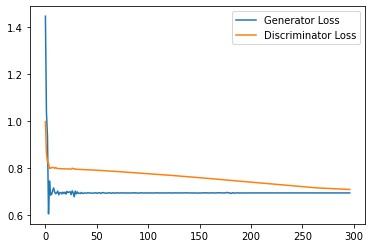

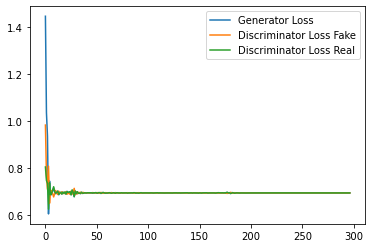

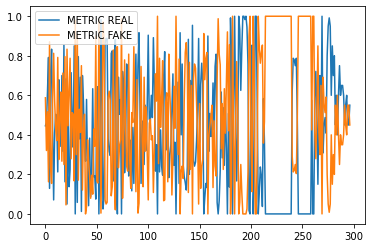

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6000: Generator loss: 0.6931471896171569, discriminator loss: 0.7075733196735382
Espectrogramas Generados


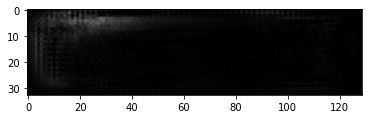

Espectrogramas Reales


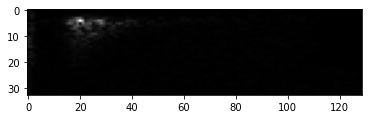

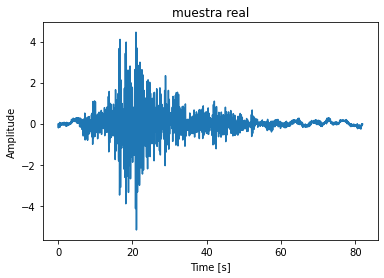

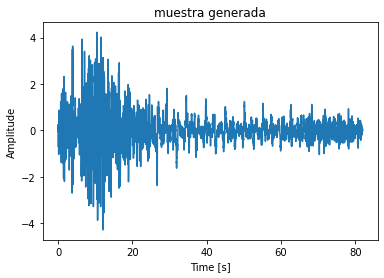

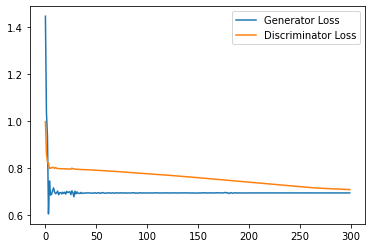

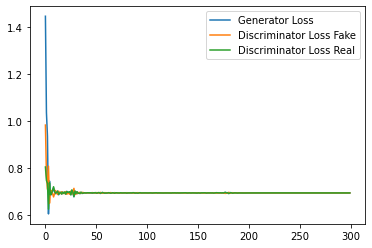

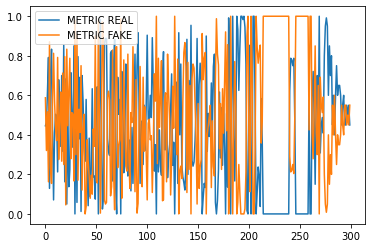

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6050: Generator loss: 0.6931465196609498, discriminator loss: 0.7070784652233124
Espectrogramas Generados


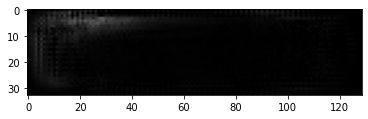

Espectrogramas Reales


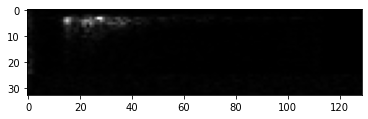

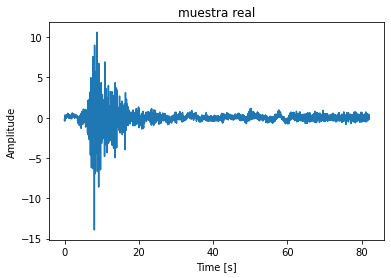

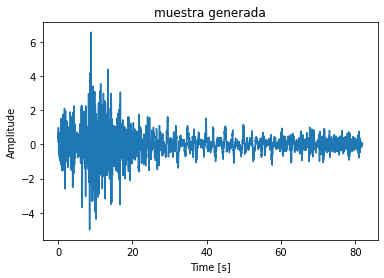

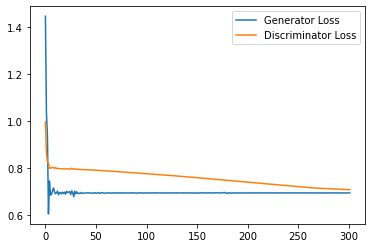

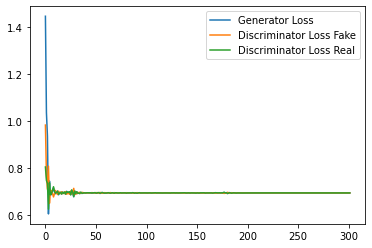

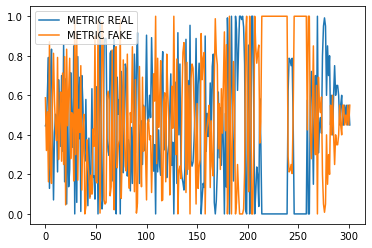

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6100: Generator loss: 0.6931479501724244, discriminator loss: 0.7065876483917236
Espectrogramas Generados


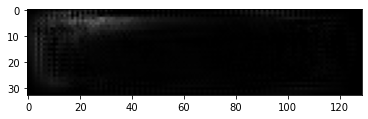

Espectrogramas Reales


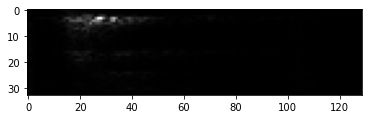

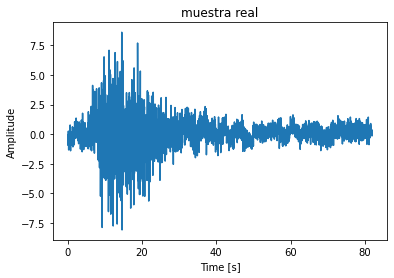

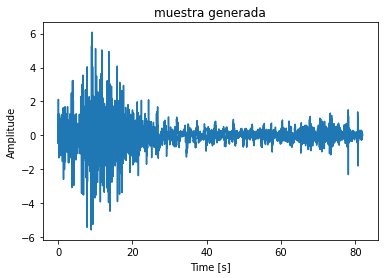

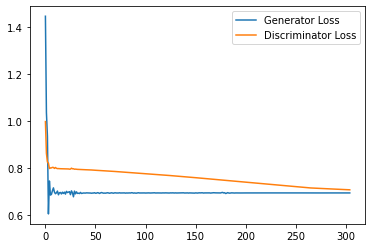

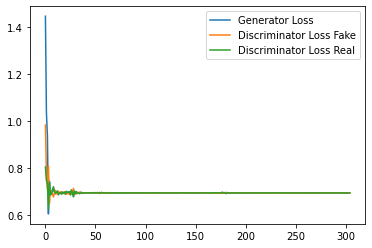

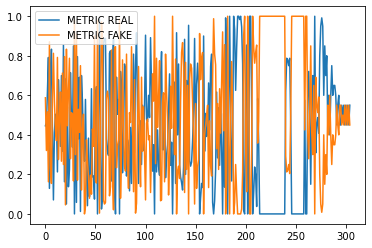

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6150: Generator loss: 0.6931476950645447, discriminator loss: 0.7061013436317444
Espectrogramas Generados


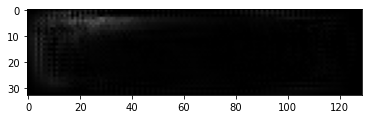

Espectrogramas Reales


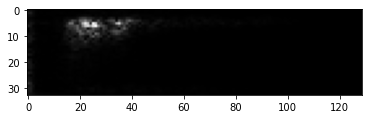

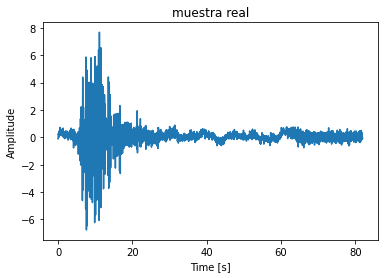

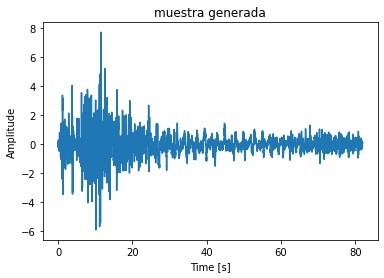

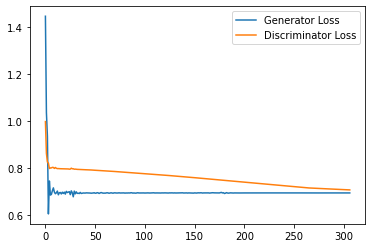

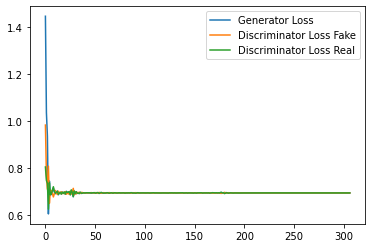

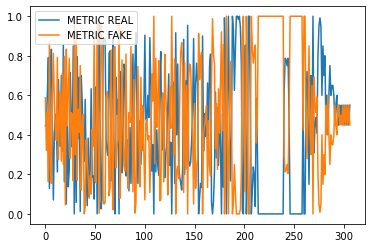

Epoch: 12


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6200: Generator loss: 0.6931474018096924, discriminator loss: 0.7056209552288055
Espectrogramas Generados


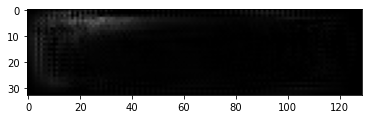

Espectrogramas Reales


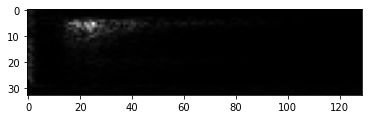

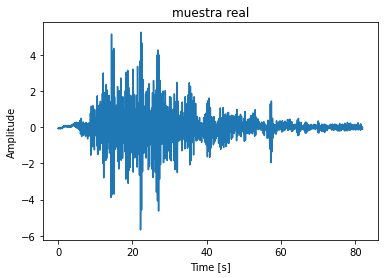

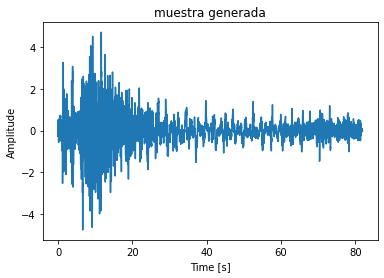

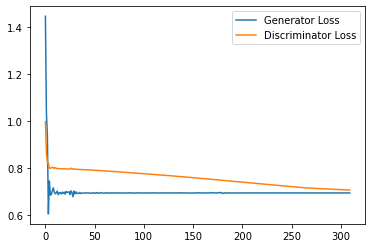

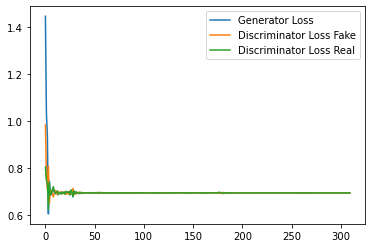

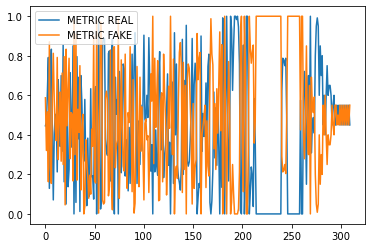

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6250: Generator loss: 0.6931464672088623, discriminator loss: 0.7051470291614532
Espectrogramas Generados


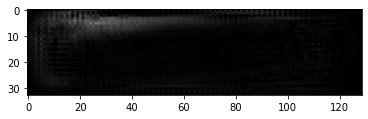

Espectrogramas Reales


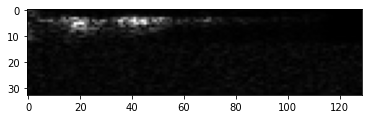

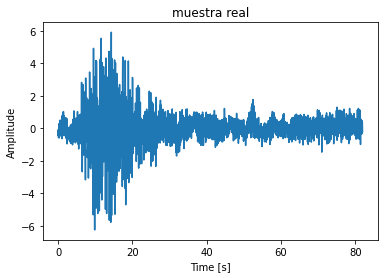

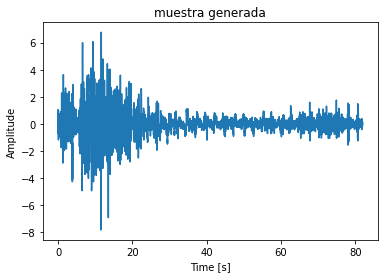

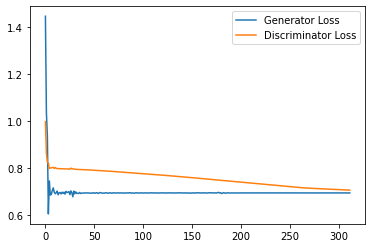

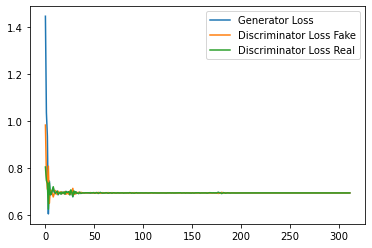

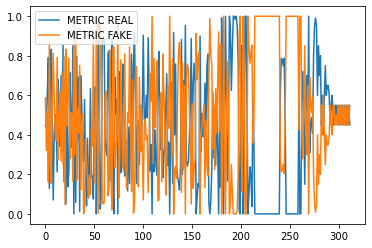

Step 6300: Generator loss: 0.6931475007534027, discriminator loss: 0.7046813035011291
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


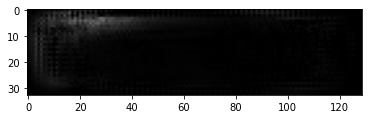

Espectrogramas Reales


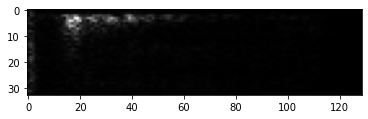

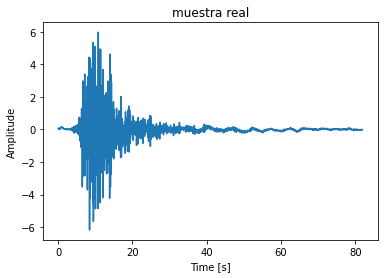

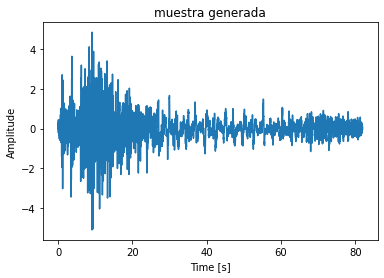

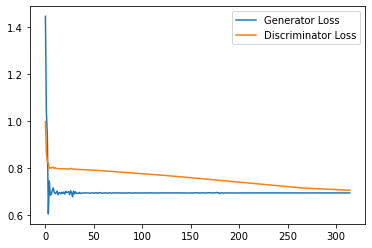

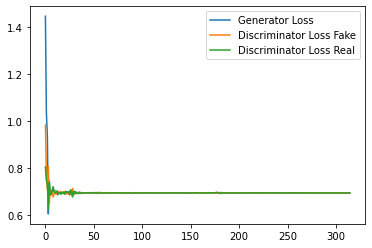

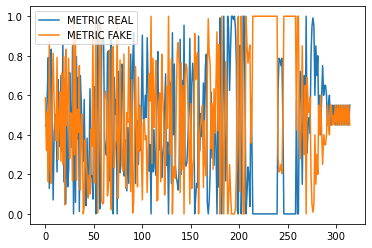

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6350: Generator loss: 0.6931478655338288, discriminator loss: 0.7042253744602204
Espectrogramas Generados


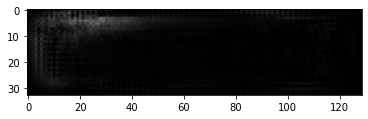

Espectrogramas Reales


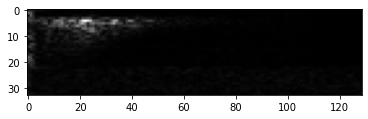

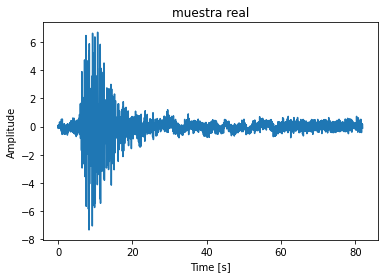

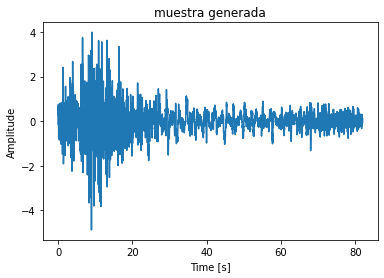

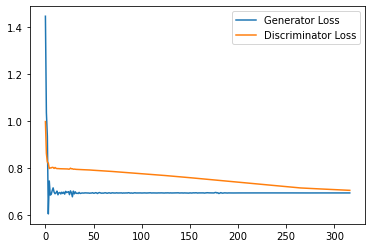

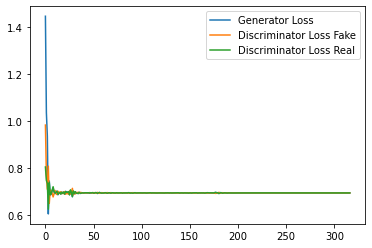

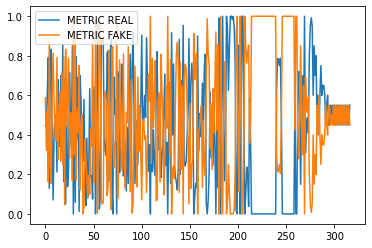

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6400: Generator loss: 0.6931471884250641, discriminator loss: 0.7037815892696381
Espectrogramas Generados


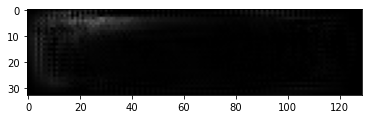

Espectrogramas Reales


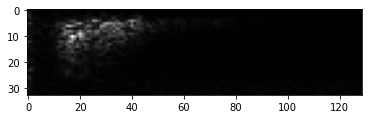

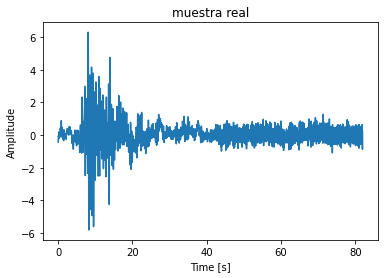

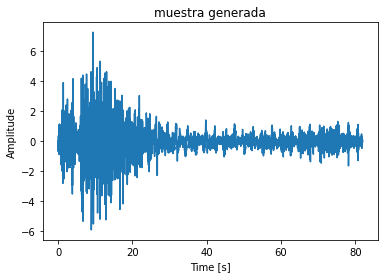

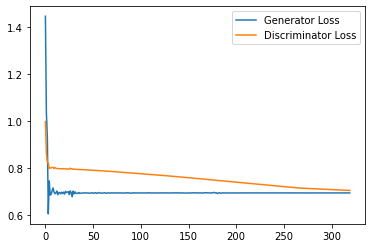

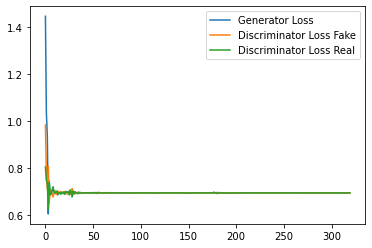

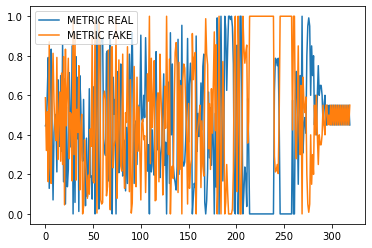

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6450: Generator loss: 0.6931467914581299, discriminator loss: 0.7033539199829102
Espectrogramas Generados


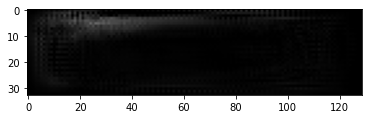

Espectrogramas Reales


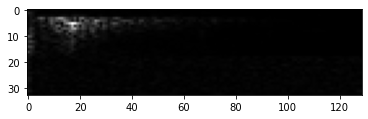

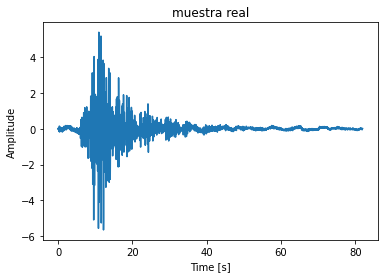

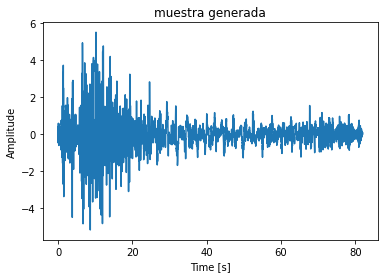

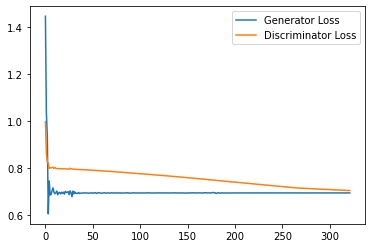

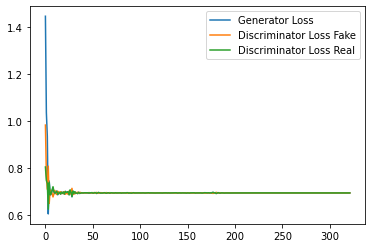

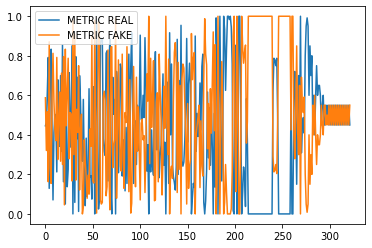

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6500: Generator loss: 0.6931472933292389, discriminator loss: 0.7029496514797211
Espectrogramas Generados


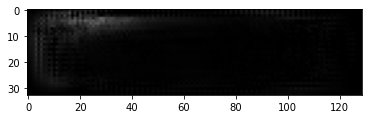

Espectrogramas Reales


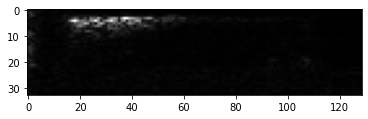

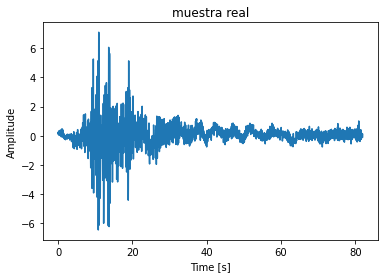

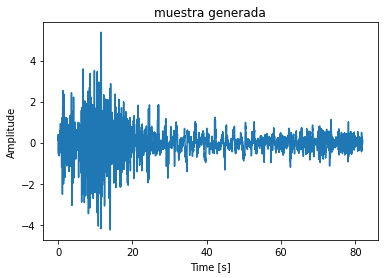

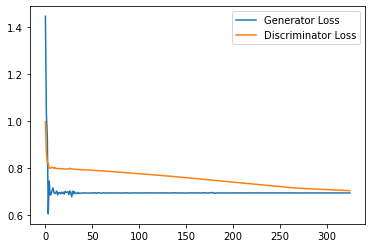

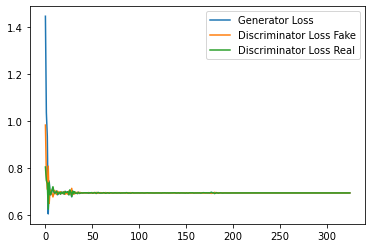

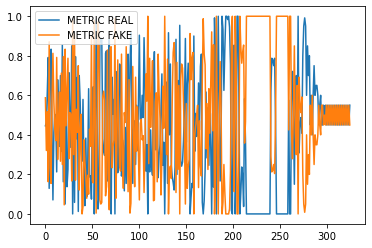

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6550: Generator loss: 0.6931477057933807, discriminator loss: 0.702613788843155
Espectrogramas Generados


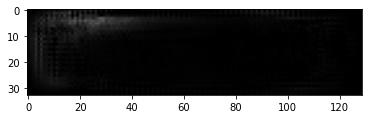

Espectrogramas Reales


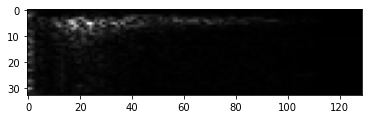

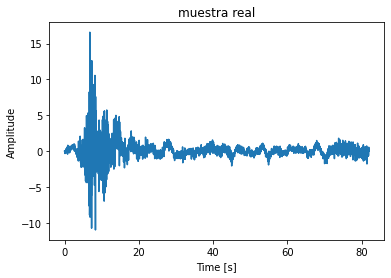

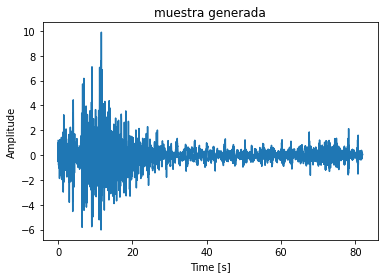

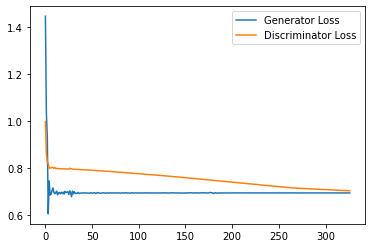

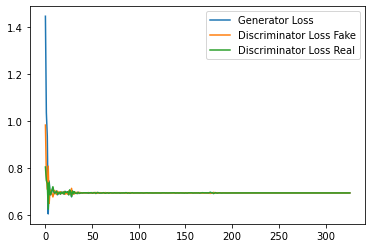

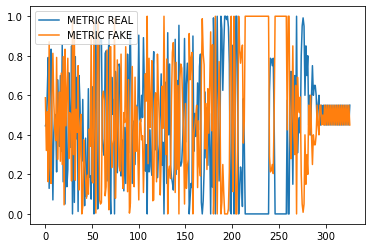

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6600: Generator loss: 0.6931471574306488, discriminator loss: 0.7023747611045837
Espectrogramas Generados


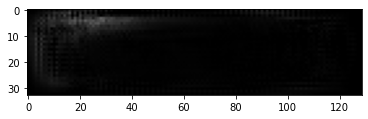

Espectrogramas Reales


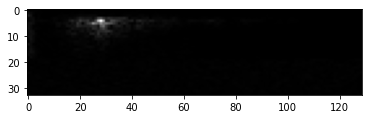

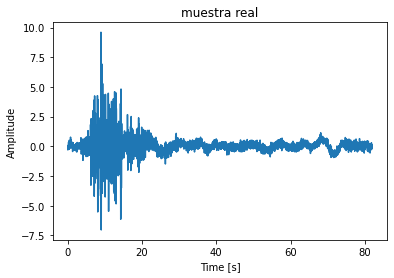

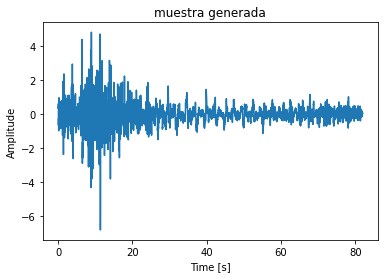

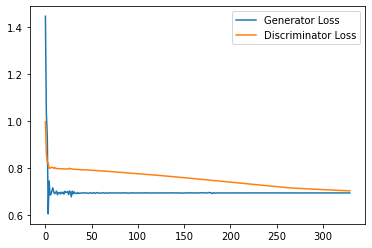

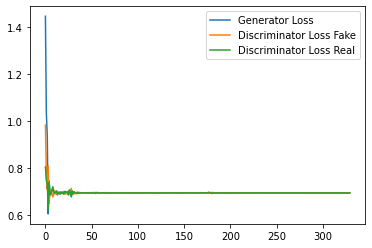

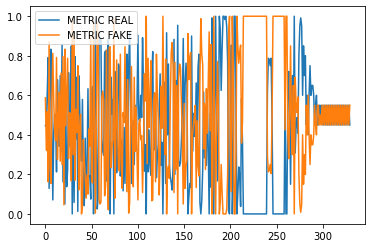

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6650: Generator loss: 0.6931467092037201, discriminator loss: 0.7021492290496826
Espectrogramas Generados


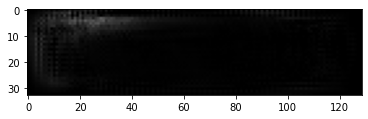

Espectrogramas Reales


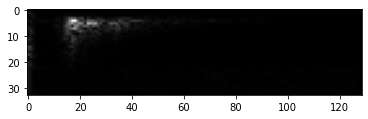

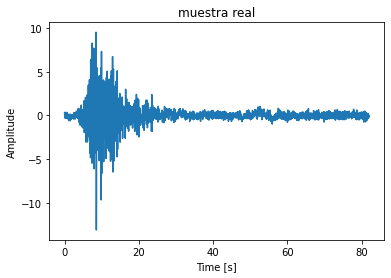

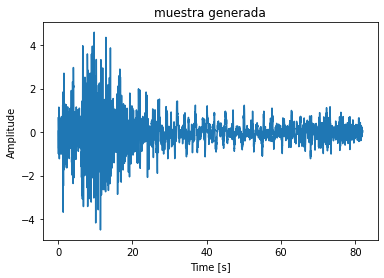

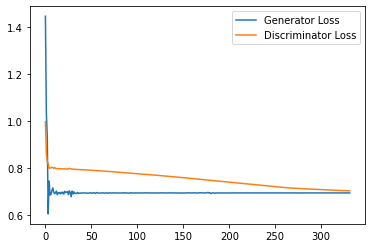

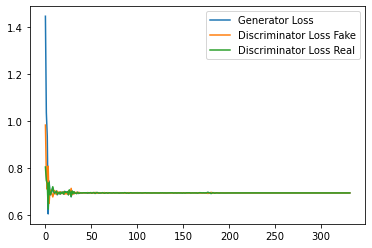

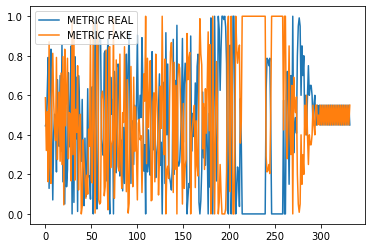

Epoch: 13


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6700: Generator loss: 0.6931473016738892, discriminator loss: 0.7019248580932618
Espectrogramas Generados


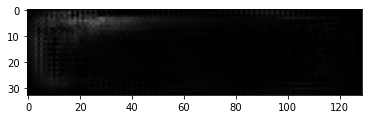

Espectrogramas Reales


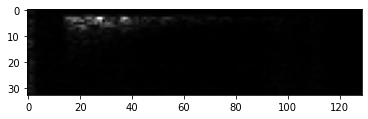

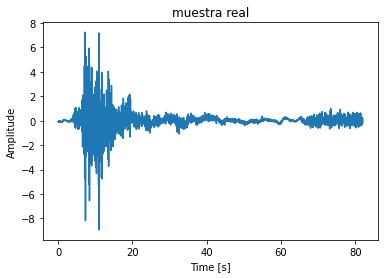

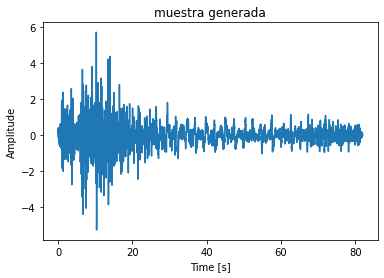

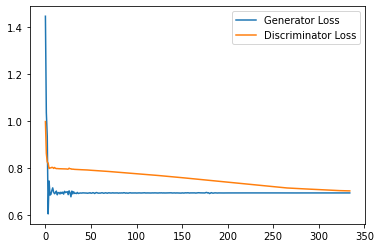

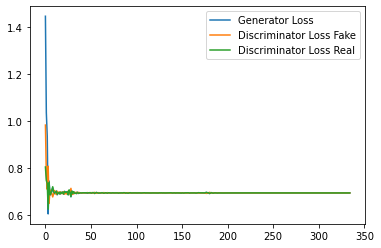

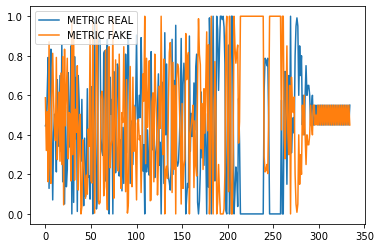

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6750: Generator loss: 0.6931477510929107, discriminator loss: 0.7017002749443054
Espectrogramas Generados


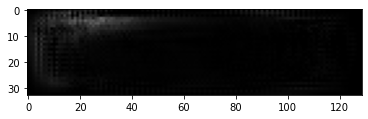

Espectrogramas Reales


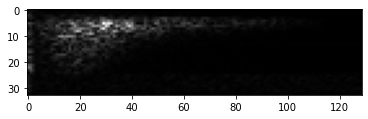

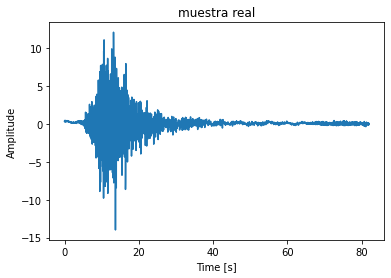

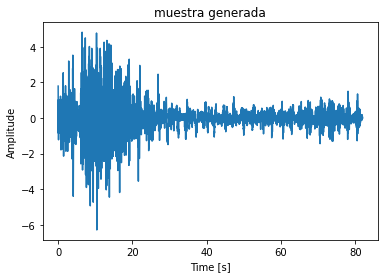

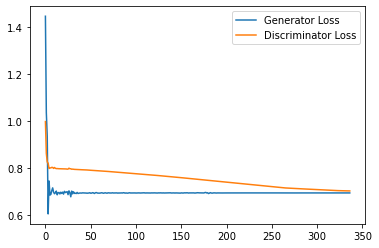

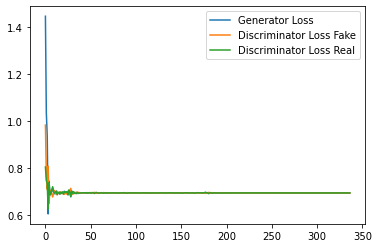

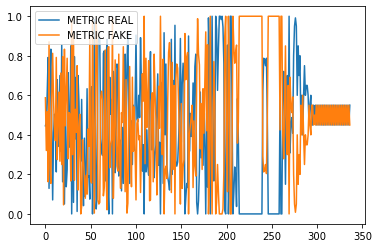

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6800: Generator loss: 0.6931471598148345, discriminator loss: 0.7014767003059387
Espectrogramas Generados


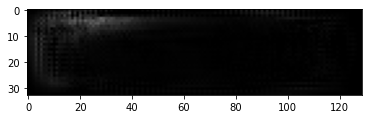

Espectrogramas Reales


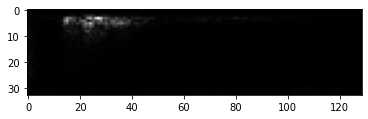

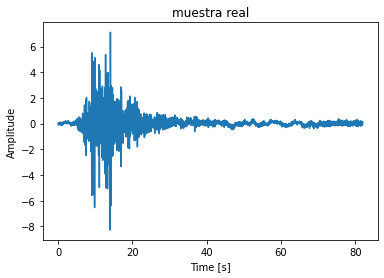

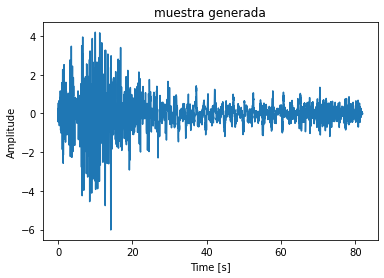

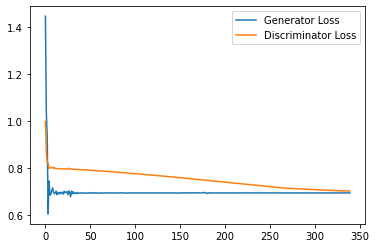

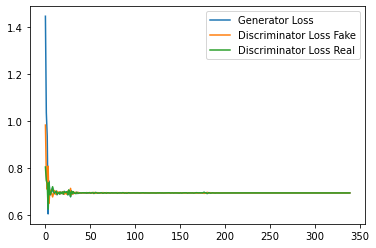

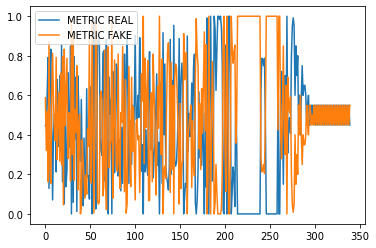

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6850: Generator loss: 0.6931466674804687, discriminator loss: 0.7012509298324585
Espectrogramas Generados


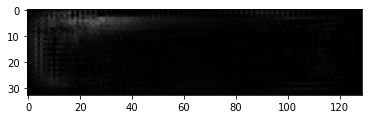

Espectrogramas Reales


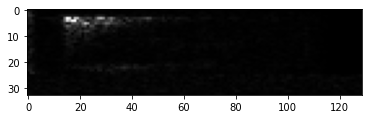

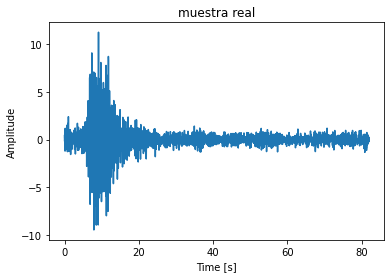

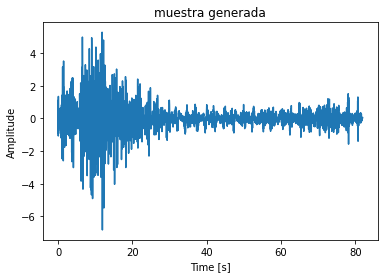

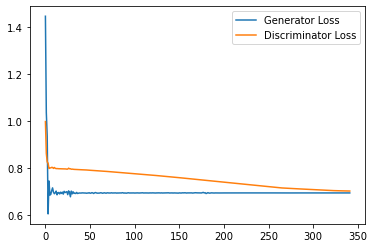

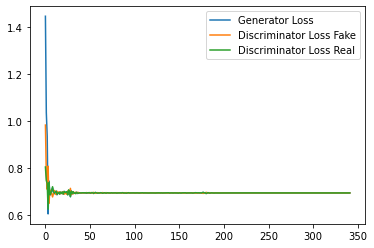

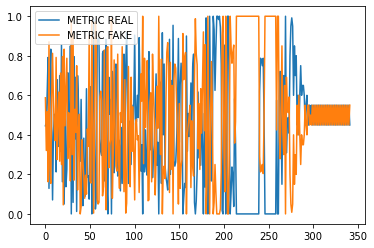

Step 6900: Generator loss: 0.6931472873687744, discriminator loss: 0.701026337146759
Espectrogramas Generados


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


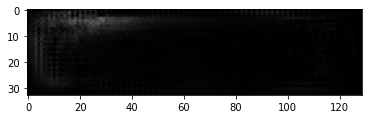

Espectrogramas Reales


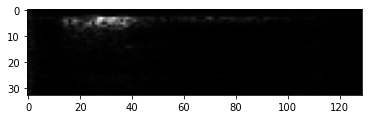

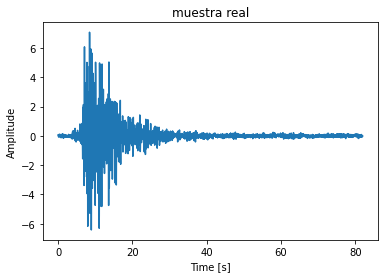

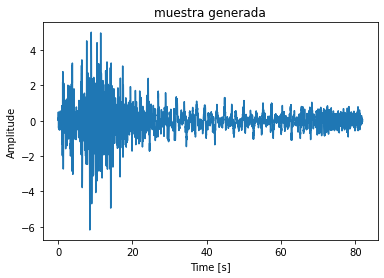

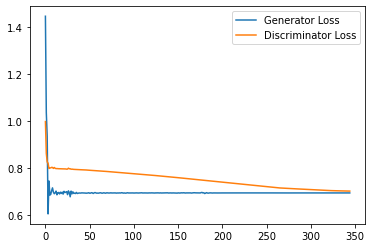

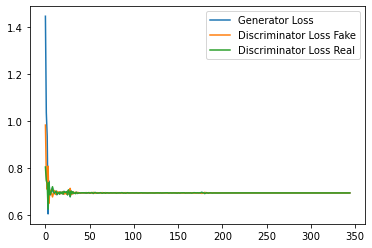

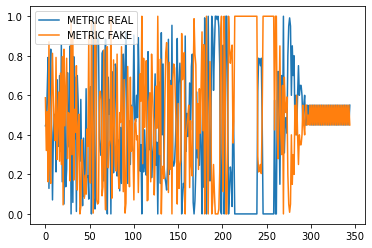

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 6950: Generator loss: 0.6931477916240693, discriminator loss: 0.7008032298088074
Espectrogramas Generados


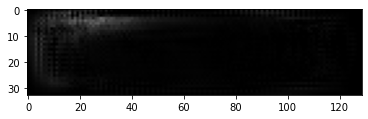

Espectrogramas Reales


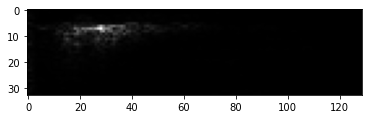

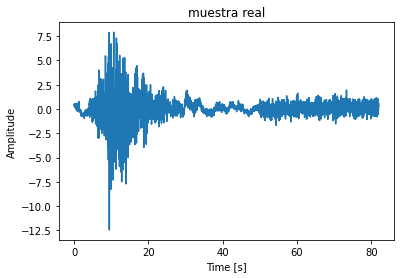

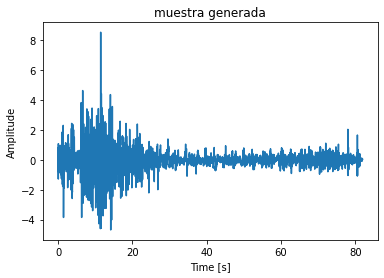

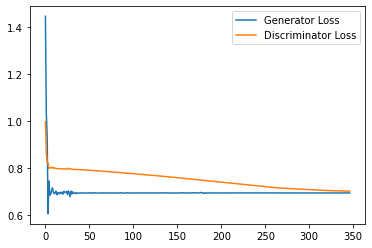

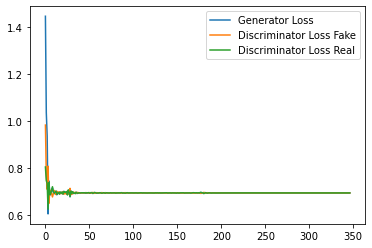

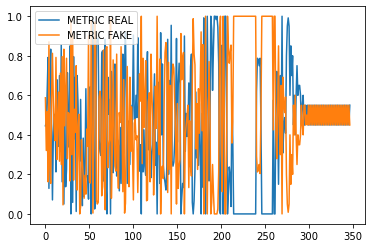

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7000: Generator loss: 0.6931471514701844, discriminator loss: 0.7005782151222228
Espectrogramas Generados


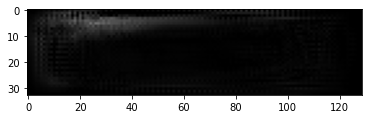

Espectrogramas Reales


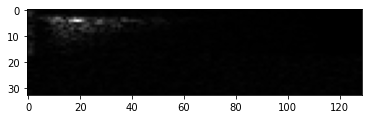

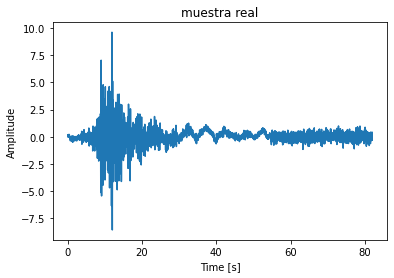

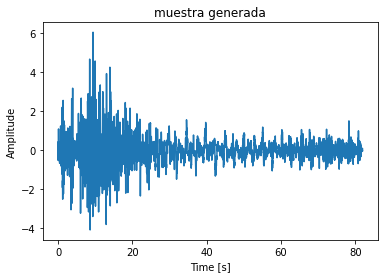

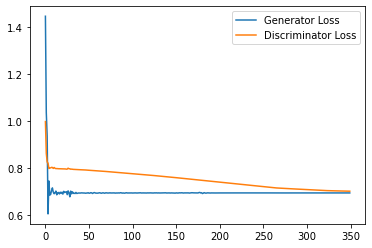

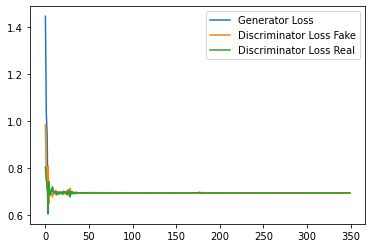

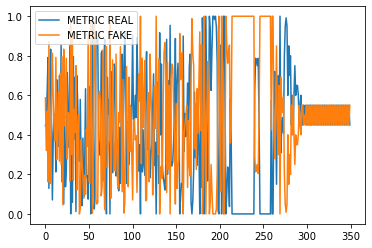

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7050: Generator loss: 0.6931466579437255, discriminator loss: 0.7003546917438507
Espectrogramas Generados


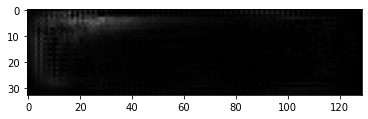

Espectrogramas Reales


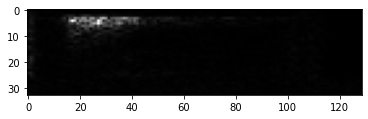

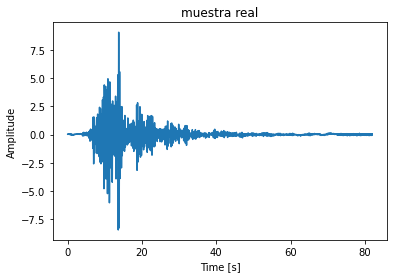

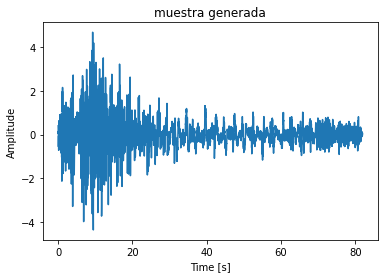

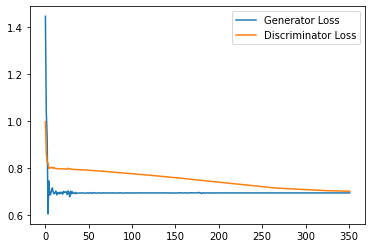

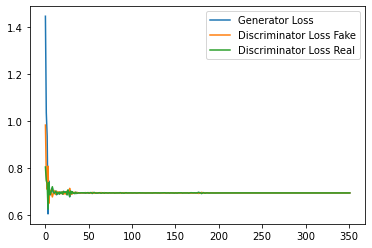

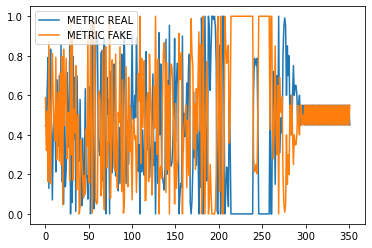

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7100: Generator loss: 0.6931472933292389, discriminator loss: 0.7001316058635711
Espectrogramas Generados


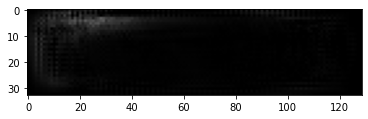

Espectrogramas Reales


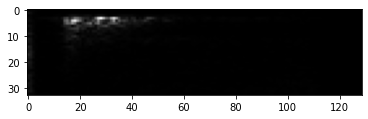

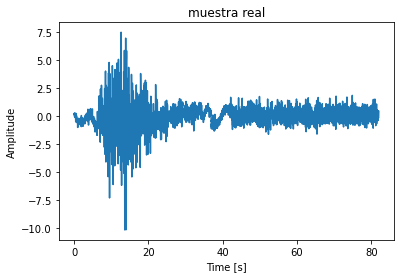

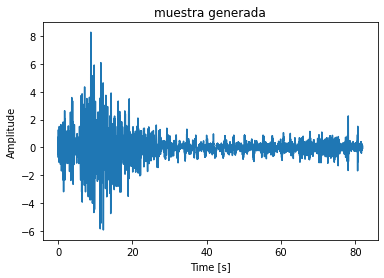

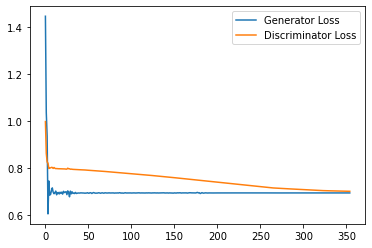

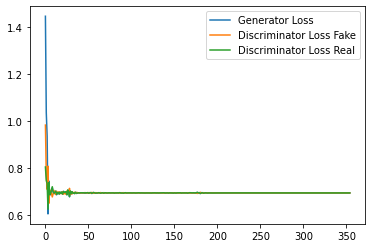

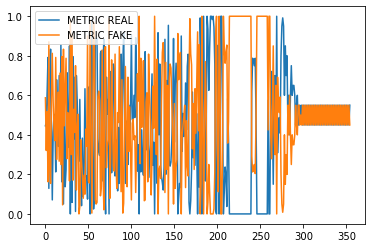

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7150: Generator loss: 0.6931478142738342, discriminator loss: 0.699909383058548
Espectrogramas Generados


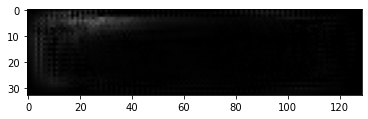

Espectrogramas Reales


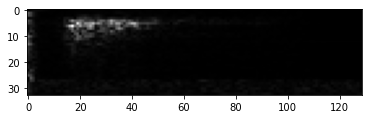

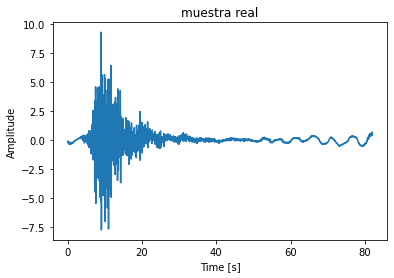

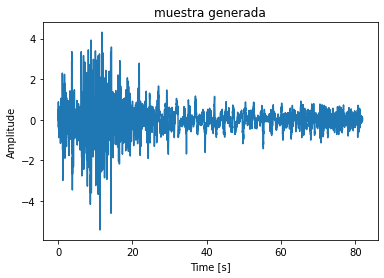

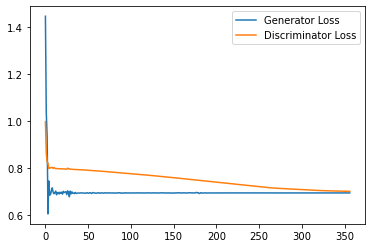

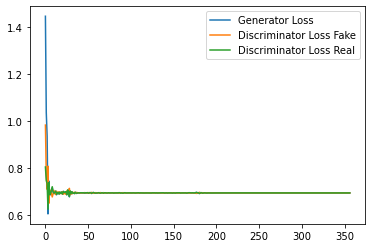

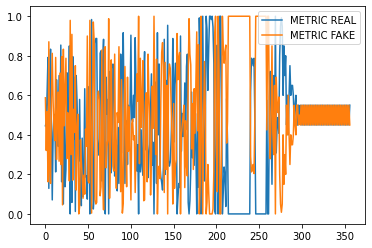

Epoch: 14


  0%|          | 0/514 [00:00<?, ?it/s]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7200: Generator loss: 0.6931471467018128, discriminator loss: 0.6996879041194916
Espectrogramas Generados


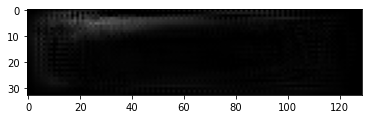

Espectrogramas Reales


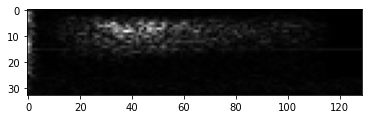

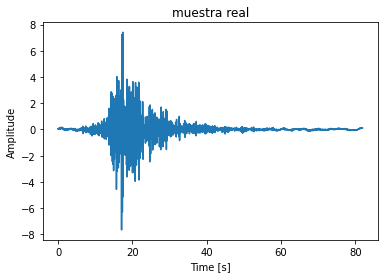

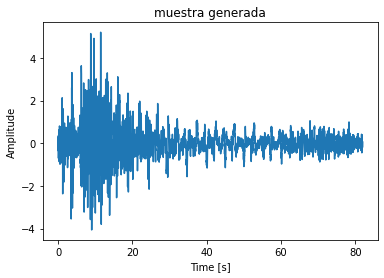

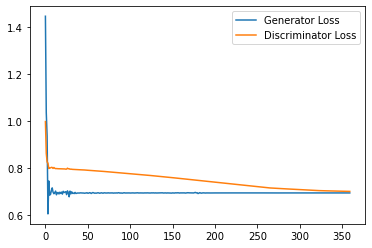

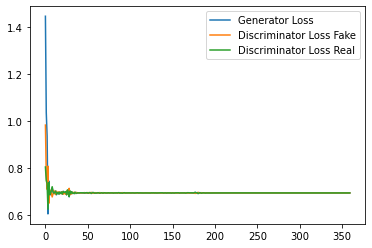

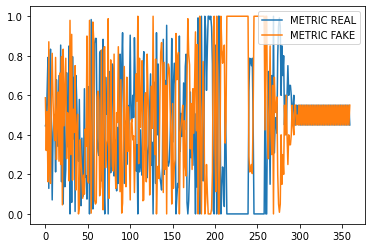

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7250: Generator loss: 0.693146619796753, discriminator loss: 0.6994682431221009
Espectrogramas Generados


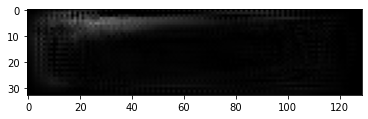

Espectrogramas Reales


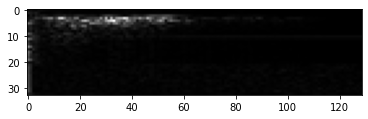

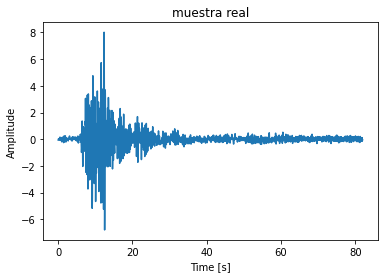

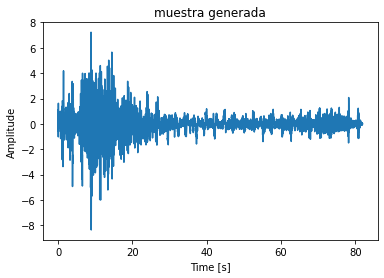

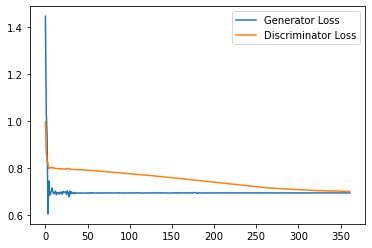

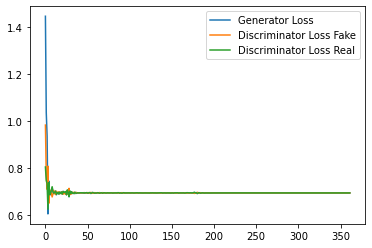

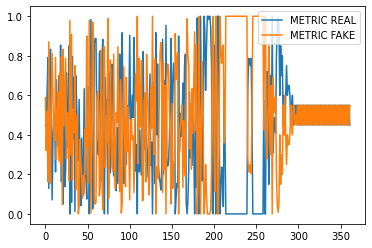

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7300: Generator loss: 0.6931473016738892, discriminator loss: 0.6992501783370971
Espectrogramas Generados


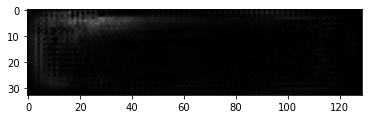

Espectrogramas Reales


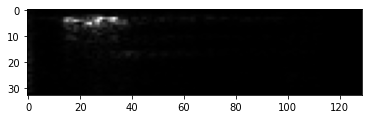

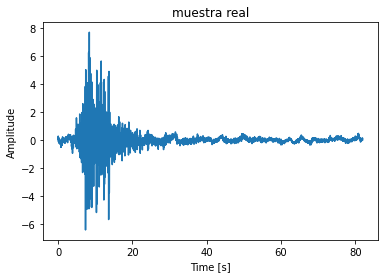

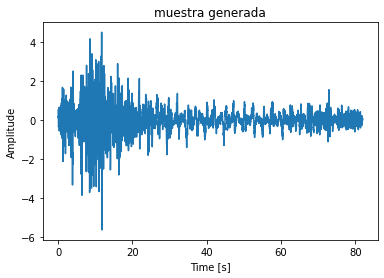

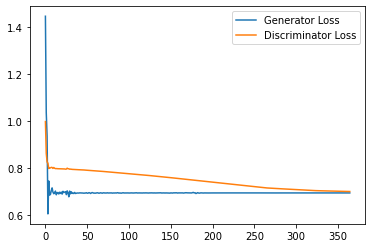

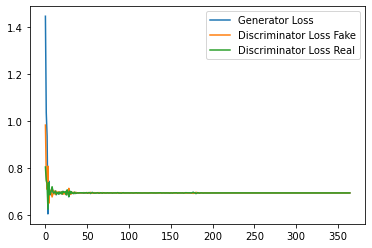

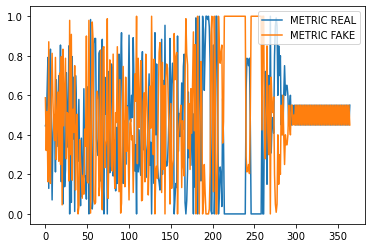

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7350: Generator loss: 0.6931478154659271, discriminator loss: 0.6990342783927918
Espectrogramas Generados


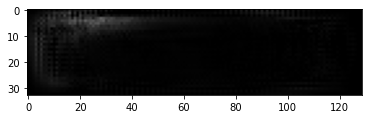

Espectrogramas Reales


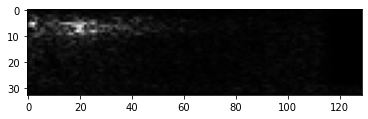

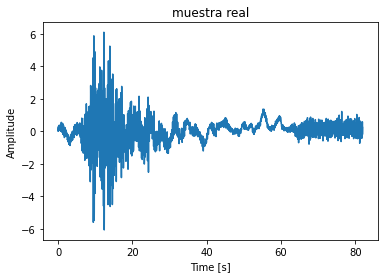

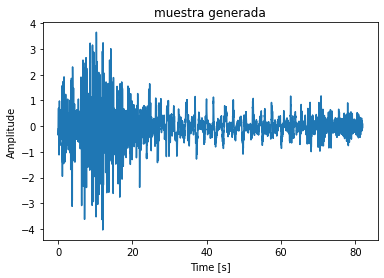

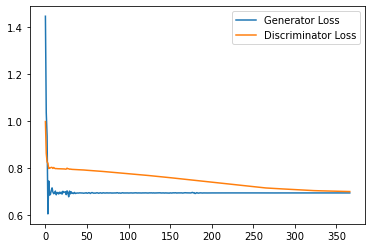

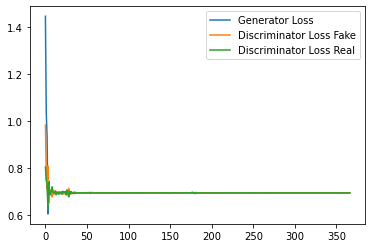

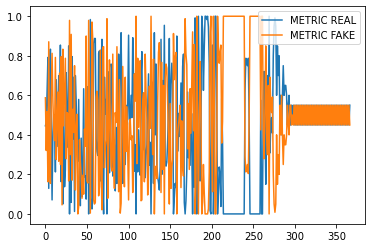

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7400: Generator loss: 0.6931471443176269, discriminator loss: 0.6988189542293548
Espectrogramas Generados


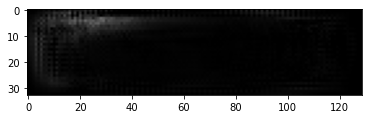

Espectrogramas Reales


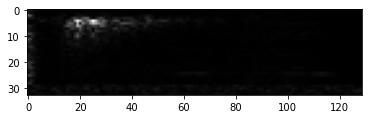

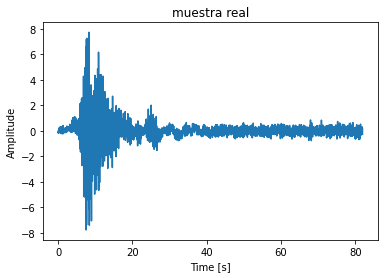

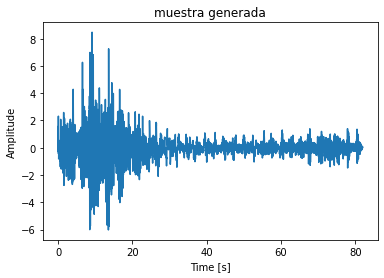

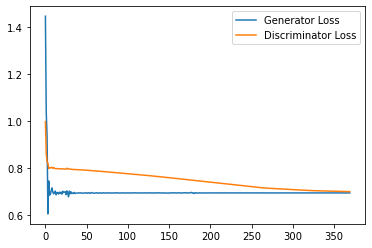

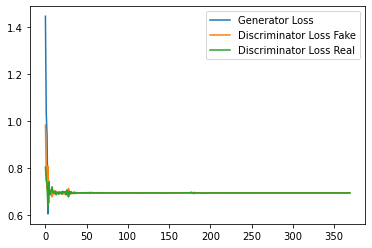

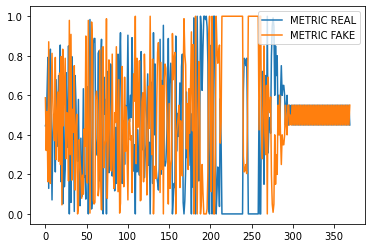

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7450: Generator loss: 0.6931465899944306, discriminator loss: 0.6986060190200806
Espectrogramas Generados


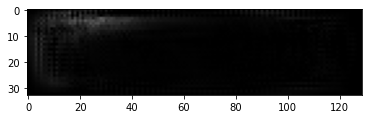

Espectrogramas Reales


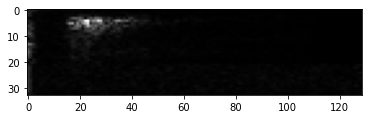

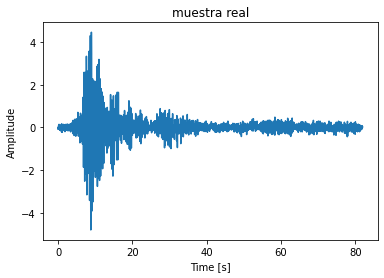

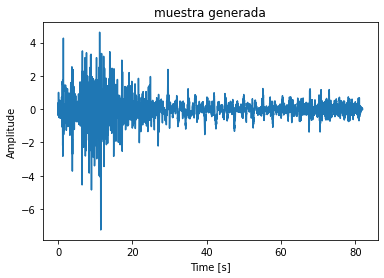

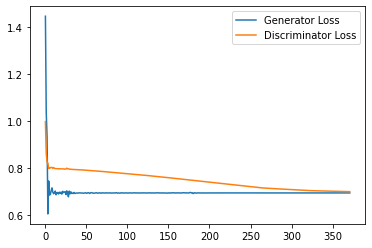

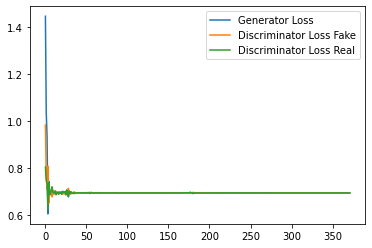

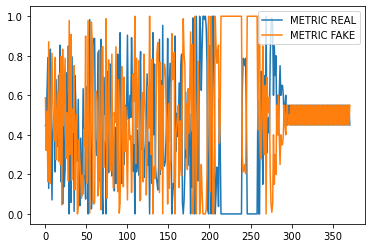

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7500: Generator loss: 0.6931473100185395, discriminator loss: 0.6983965754508972
Espectrogramas Generados


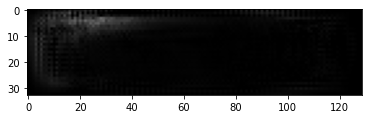

Espectrogramas Reales


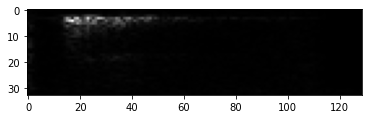

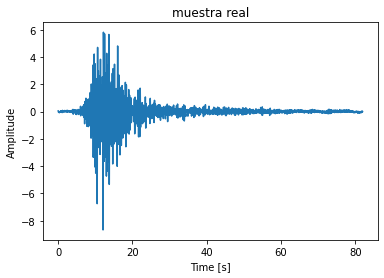

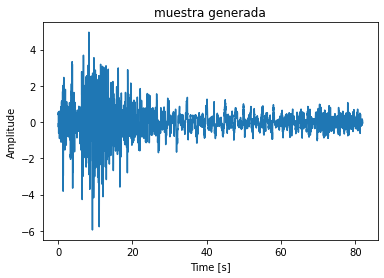

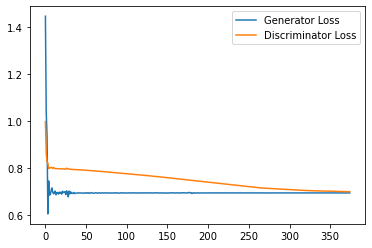

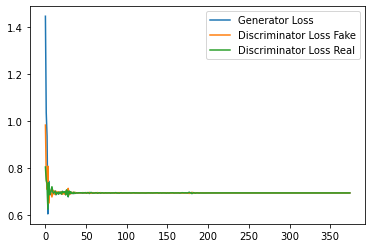

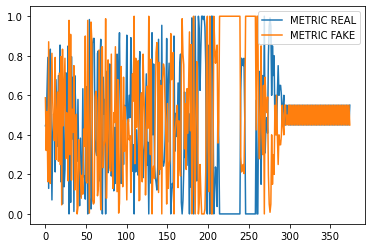

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7550: Generator loss: 0.6931478488445282, discriminator loss: 0.6981895291805267
Espectrogramas Generados


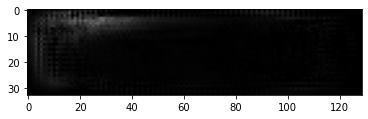

Espectrogramas Reales


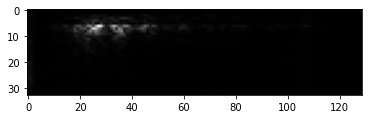

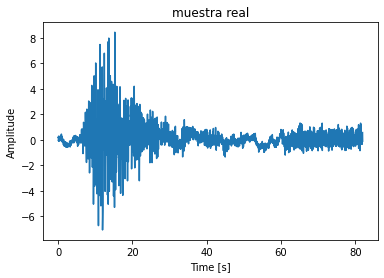

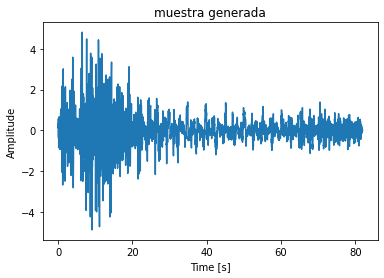

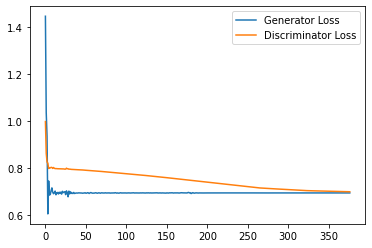

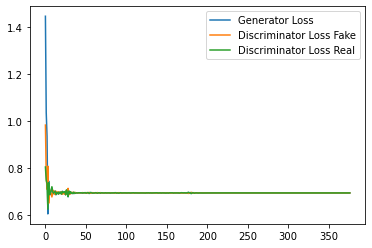

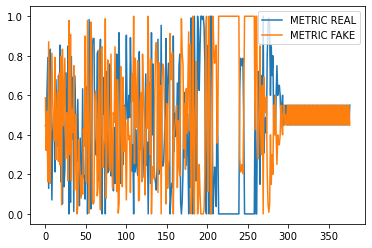

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7600: Generator loss: 0.6931471407413483, discriminator loss: 0.6979867315292358
Espectrogramas Generados


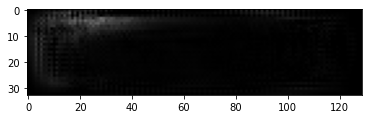

Espectrogramas Reales


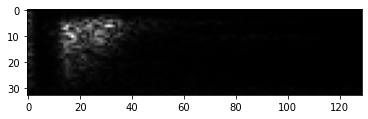

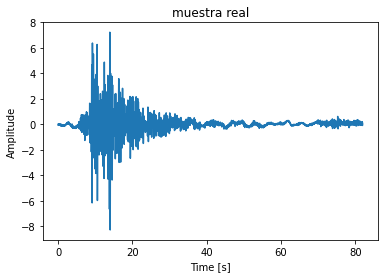

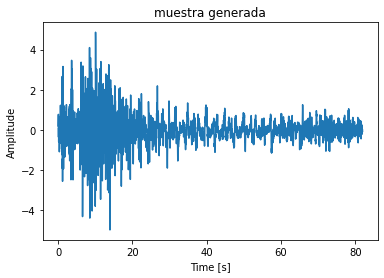

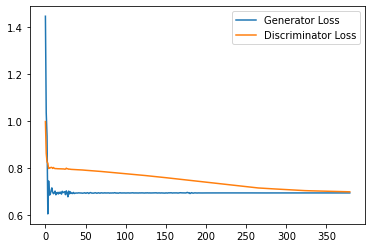

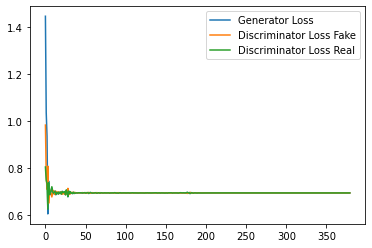

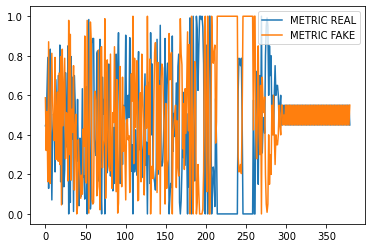

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7650: Generator loss: 0.693146574497223, discriminator loss: 0.6977888453006744
Espectrogramas Generados


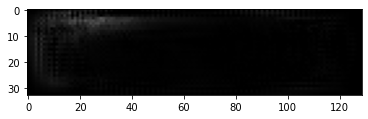

Espectrogramas Reales


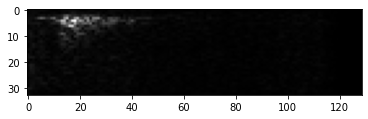

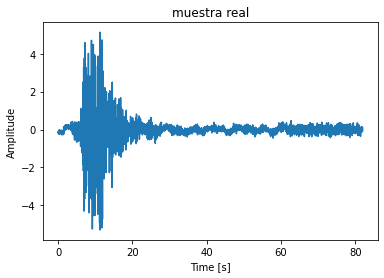

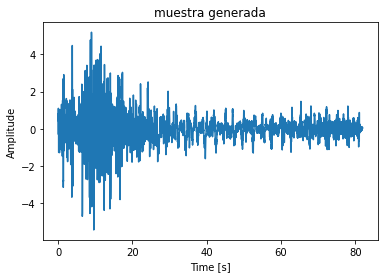

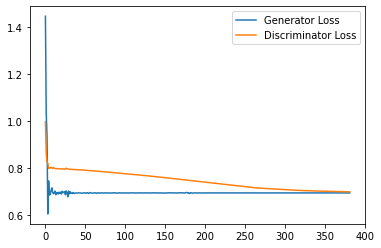

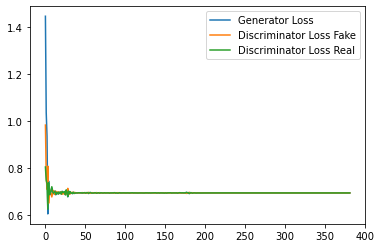

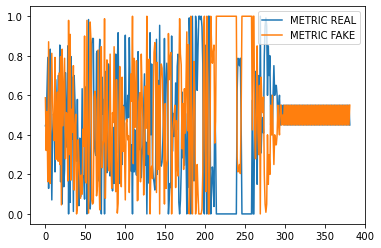

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Step 7700: Generator loss: 0.6931473290920258, discriminator loss: 0.6975974190235138
Espectrogramas Generados


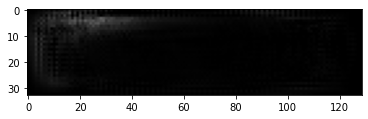

Espectrogramas Reales


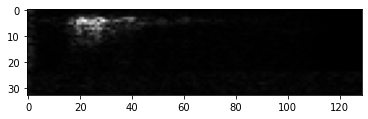

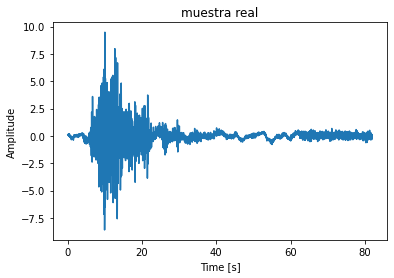

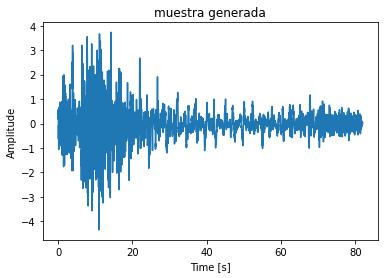

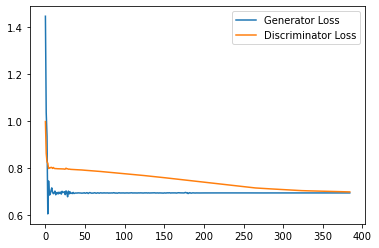

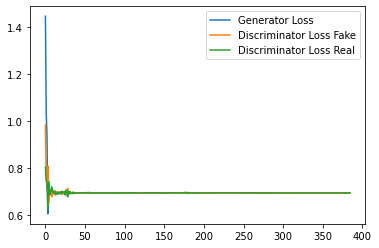

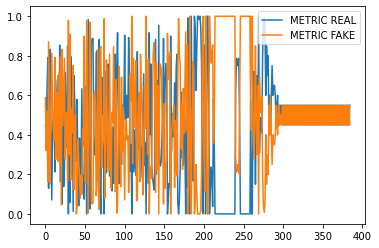

epoch guardada


In [9]:
cur_step = 0
generator_losses = []
discriminator_losses = []
discriminator_losses_real = []
discriminator_losses_fake = []
metric_real = []
metric_fake = [] 

for epoch in range(epoch_temp + 1, n_epochs):
    print('Epoch: ' + str(epoch))
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)
        one_hot_labels = auxiliares.get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])
        disc_opt.zero_grad()
        fake_noise = auxiliares.get_noise(cur_batch_size, z_dim, device=device)
        noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
        fake = gen.forward(noise_and_labels) #no usar     
        #fake = gen(noise_and_labels)#gen.forward(noise_and_labels) no usar
        fake_image_and_labels = auxiliares.combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = auxiliares.combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)               
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        metric_fake += [metric(disc_fake_pred, torch.zeros_like(disc_fake_pred)).item()]
        metric_real += [metric(disc_real_pred, torch.ones_like(disc_real_pred)).item()]       
        disc_loss = ((disc_fake_loss + disc_real_loss)/2)       
        if regularizaM:
            l2_reg = None
            for W in disc.parameters():
                if l2_reg is None:
                    l2_reg = W.norm(2)
                else:
                    l2_reg = l2_reg + W.norm(2)
            disc_loss = disc_loss +  l2_reg * reg_lambda         
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 
        discriminator_losses_real += [disc_real_loss.item()]
        discriminator_losses_fake+= [disc_fake_loss.item()]
        discriminator_losses += [disc_loss.item()]
        mean_iteration_gen_loss = 0
        for _ in range(repeats_g):
            gen_opt.zero_grad()
            fake_noise_2 = auxiliares.get_noise(cur_batch_size, z_dim, device=device)       
            noise_and_labels_2 = auxiliares.combine_vectors(fake_noise_2, one_hot_labels)
            fake_2 = gen(noise_and_labels_2)   
            fake_image_and_labels = auxiliares.combine_vectors(fake_2, image_one_hot_labels)
            disc_fake_pred = disc(fake_image_and_labels)
            gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
            mean_iteration_gen_loss += gen_loss.item() / repeats_g    
            gen_loss.backward()
            gen_opt.step()
        generator_losses += [mean_iteration_gen_loss]
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            print(f"Espectrogramas Generados")
            visualizacion.show_tensor_images(torch.transpose(fake, 2, 3), size=(1, 129, 33), num_images=1)
            print(f"Espectrogramas Reales")
            visualizacion.show_tensor_images(torch.transpose(real, 2, 3), size=(1, 129, 33), num_images=1)
            
            visualizacion.show_time_domine_images(torch.transpose(real, 2, 3), size=(1, 129, 33), std=std, mean=mean, real = True)
            visualizacion.show_time_domine_images(torch.transpose(fake, 2, 3), size=(1, 129, 33), std=std, mean=mean, real = False)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            
            plt.show()
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses_fake[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss Fake"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses_real[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss Real"
            )
            plt.legend()
            
            plt.show()
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(metric_real[:num_examples]).view(-1, step_bins).mean(1),
                label="METRIC REAL"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(metric_fake[:num_examples]).view(-1, step_bins).mean(1),
                label="METRIC FAKE"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Red Funcionando")
        cur_step += 1 
    if((guardar and epoch % save_steep == 0) or epoch == n_epochs - 1):
        Checkpoint.save_weighs(gen, disc, gen_opt, disc_opt, epoch, gen_loss, disc_loss, nombre)
        print('epoch guardada')                

In [10]:
gen.eval()
disc.eval()

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 16, kernel_size=(13, 4), stride=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(16, 32, kernel_size=(13, 4), stride=(2, 2))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(32, 64, kernel_size=(13, 4), stride=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(64, 128, kernel_size=(13, 4), stride=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (4): Sequential(
      (0): Conv2d(128, 256, kernel_size=(13, 4), stride=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (5): Sequential(
      (0): Conv2d(256, 512, kernel_size=(13, 4), stride=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (6): Sequential(
      (0): Conv2d(512, 1, kernel_size=(5, 2), stride=(2, 2))
    )
  )
)

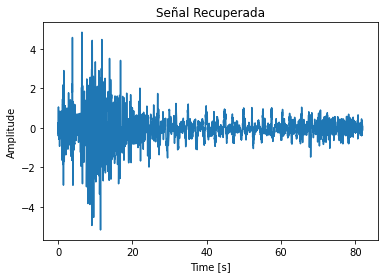

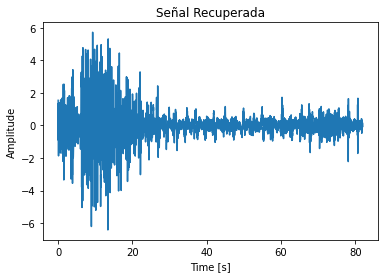

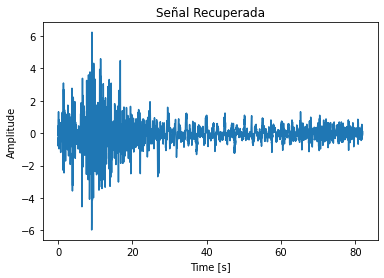

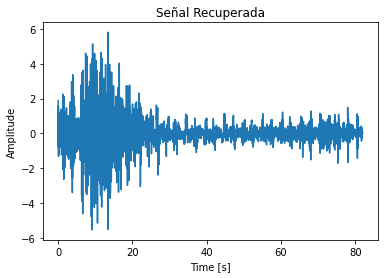

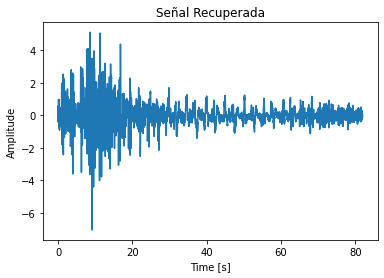

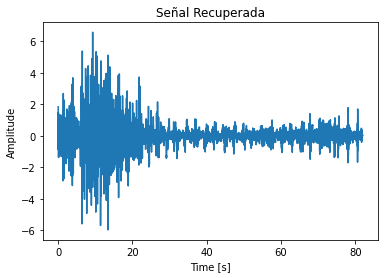

In [11]:
import PrePross.grifflin as grifflin
import numpy as np

examples = 3

for i in range(examples):
    x = torch.tensor([1])
    one_hot_labels = auxiliares.get_one_hot_labels(x.to(device), n_classes)
    fake_noise = auxiliares.get_noise(1, z_dim, device=device)
    noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    fake = fake.cpu().detach().numpy() 
    fake = fake * std + mean
    samplerate = 50
    timee, muestra_rec=grifflin.reconstruir_señal_generador(fake, 1000, samplerate)
    muestra_rec = np.squeeze(muestra_rec)
    tamaño = len(muestra_rec) / samplerate
    time = np.linspace(0., tamaño, len(muestra_rec))
    plt.plot(time,muestra_rec)
    plt.title("Señal Recuperada")
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.show()
    x = torch.tensor([0])
    one_hot_labels = auxiliares.get_one_hot_labels(x.to(device), n_classes)
    fake_noise = auxiliares.get_noise(1, z_dim, device=device)
    noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    fake = fake.cpu().detach().numpy() 
    fake = fake * std + mean
    samplerate = 50
    timee, muestra_rec=grifflin.reconstruir_señal_generador(fake, 1000, samplerate)
    muestra_rec = np.squeeze(muestra_rec)
    tamaño = len(muestra_rec) / samplerate
    time = np.linspace(0., tamaño, len(muestra_rec))
    plt.plot(time,muestra_rec)
    plt.title("Señal Recuperada")
    plt.xlabel("Time [s]")
    plt.ylabel("Amplitude")
    plt.show()
    

In [12]:
from torchvision.utils import save_image

n = 4792
for i in range(n):
    x = torch.tensor([1])
    one_hot_labels = auxiliares.get_one_hot_labels(x.to(device), n_classes)
    fake_noise = auxiliares.get_noise(1, z_dim, device=device)
    noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    nombre = 'img/fake/lp/img'+str(i)+'.png'
    save_image(fake, nombre)

n = 1358
for i in range(n):
    x = torch.tensor([0])
    one_hot_labels = auxiliares.get_one_hot_labels(x.to(device), n_classes)
    fake_noise = auxiliares.get_noise(1, z_dim, device=device)
    noise_and_labels = auxiliares.combine_vectors(fake_noise, one_hot_labels)
    fake = gen(noise_and_labels)
    nombre = 'img/fake/vt/img'+str(i)+'.png'
    save_image(fake, nombre)

n = 1000
for i in range(n):
    ruidoplano = np.random.normal(size = 129*33)
    ruido = ruidoplano.reshape((129, 33))
    nombre = 'img/ruido/img'+str(i)+'.png'
    sample = torch.from_numpy(ruido)
    save_image(sample, nombre)

n = myData.__len__()
c =0
cd=0
for i in range(n):
    sample, tag = myData.__getitem__(i)
    nombre = ''
    if tag == 0:
        nombre = 'img/real/vt/img'+str(i)+'.png'
        save_image(sample, nombre)
    if tag == 1:
        nombre = 'img/real/lp/img'+str(i)+'.png'
        save_image(sample, nombre)

In [13]:
!python -m pytorch_fid img/fake/vt img/real/vt
!python -m pytorch_fid img/fake/lp img/real/lp
!python -m pytorch_fid img/fake/vt img/ruido
!python -m pytorch_fid img/fake/lp img/ruido
!python -m pytorch_fid img/fake/vt img/fake/lp

100%|███████████████████████████████████████████| 28/28 [00:02<00:00, 13.70it/s]
FID:  331.7512460454047
100%|███████████████████████████████████████████| 97/97 [00:06<00:00, 15.68it/s]
FID:  309.7266424091173
100%|███████████████████████████████████████████| 20/20 [00:01<00:00, 12.78it/s]
FID:  556.709346659687
100%|███████████████████████████████████████████| 20/20 [00:01<00:00, 12.80it/s]
FID:  553.4355231418559
100%|███████████████████████████████████████████| 96/96 [00:06<00:00, 15.47it/s]
FID:  99.51144348682706


In [14]:
#Generar Base de datos de n muestras